### Decision Tree Classifier

Now in this assignment we will be implementing the Decision Classifier for both Continuous and Categorical attributes.

You will be testing your implementations with three different split criterias, namely:
 - Information Gain
 - Gini Index
 - CART 


In [1]:
%pylab inline
import scipy.stats
from collections import defaultdict  # default dictionary 

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
# import numpy as np

# Y = np.array([0, 1, 2, 1, 0, 0, 2,2,2,2, 1, 0])
# counts = (np.bincount(Y))
# print("Counts of each class:", counts)
# print(np.argmax(counts))

In [3]:
# from collections import Counter

# # Assuming Y is your array of strings
# Y = ["Iris-setosa", "Iris-virginica", "Iris-setosa", "Iris-virginica", "Iris-setosa"]

# # Step 1: Count occurrences of each label
# label_counts = Counter(Y)

# # Step 2: Get the maximum label count
# max_label = max(label_counts.values())

# # Step 3: Calculate purity
# purity = max_label / len(Y)

# print("Label counts:", label_counts)
# print("Max label count:", max_label)
# print("Purity:", purity)


In [4]:
# # Create a Node with split on feature_0 at threshold 1.5
# node = Node(purity=0.9, klasslabel='A', score=0.5, split=[1.5], fidx=0)

# # Sample dataset
# data = [
#     [1.0, 2.0],  # Instance 1
#     [2.0, 3.0],  # Instance 2
#     [0.5, 1.5],  # Instance 3
#     [1.6, 2.4]   # Instance 4
# ]

# # Check each instance in data to see if it satisfies the isless_than_eq condition, as we have set the fidx 0 so it will only check according to the feature 0
# results = []
# for i, instance in enumerate(data, 1):
#     result = node.isless_than_eq(instance)
#     results.append((f"Instance {i}", instance, "Left" if result else "Right"))

# # Print the results
# for instance_info in results:
#     print(instance_info)

In [5]:
class Node:
    def __init__(self,purity,klasslabel='',score=0,split=[],fidx=-1):
        # print(f"Feature index: {fidx}")
        self.lchild=None       
        self.rchild=None
        self.klasslabel=klasslabel        
        self.split=split
        self.score=score
        self.fidx=fidx #feature index
        self.purity=purity

        
    def set_childs(self,lchild,rchild):
        self.lchild=lchild       
        self.rchild=rchild
        
    def isleaf(self):
        if self.lchild==None and self.rchild==None:
            return True
        return False

#     def isless_than_eq(self, X):
#         print(X[self.fidx]," ",self.split[0])
#         # Check if the feature at index `fidx` in `X` is less than or equal to the split threshold
#         if not self.split:
#             raise ValueError("Split value is not defined for this node.")
#         return X[self.fidx] <= self.split[0]
    
    def isless_than_eq(self, X):
        # print(f"X: {X} Split: ",self.split)
        
        # print("\nGet str\n")
        # # Print all the attributes directly
        # print(f"Node(Purity={self.purity}, Class='{self.klasslabel}', "
        #       f"Score={self.score}, Split={self.split}, Feature Index={self.fidx}, "
        #       f"Left Child={'Yes' if self.lchild else 'No'}, "
        #       f"Right Child={'Yes' if self.rchild else 'No'})")
        
        # Check if split threshold exists and compare
        if self.split:
            # print(f"Feature Value: {X[self.fidx]}, Split Threshold: {self.split[0]}")
            return X[self.fidx] <= self.split[0]
        
    def get_str(self):        
        if self.isleaf():
            return 'C(class={},Purity={})'.format(self.klasslabel,self.purity)
        else:
            return 'I(Fidx={},Score={},Split={})'.format(self.fidx,self.score,self.split)
    

In [17]:
# It measures the amount of disorder (impurity) or uncertainity in the system

def calculate_entropy(x1, x2):
    return -(x1*np.log2(x1+1e-9)+ x2*np.log2(x2+1e-9))

In [48]:
import pdb
class DecisionTree:
    ''' Implements the Decision Tree For Classification... '''
    def __init__(self, purityp, exthreshold,maxdepth=10): #0.95, 5,2       
        self.purity=purityp
        '''
        This parameter sets a threshold for the minimum number of examples (data points) a node must have to be split 
        further. If a node has fewer examples than exthreshold, it becomes a leaf node, and the tree won’t attempt to 
        split it any further.
        '''
        self.exthreshold=exthreshold
        self.maxdepth=maxdepth
        
    def calculate_purity(self, Y):
        """
        Calculates the purity of the current node based on the distribution of labels in Y.
        
        Purity here is measured by the fraction of the most common label in Y.
        """
        
        label_counts = Counter(Y) # {'Iris-setosa': 3, 'Iris-virginica': 2}
        max_label = max(label_counts.values()) # 3

        # Step 3: Calculate purity
        purity = max_label / len(Y)
        
        return purity
        
    def train(self, X, Y):
        ''' Train Decision Tree using the given 
            X [m x d] data matrix and Y labels matrix
            
            Input:
            ------
            X: [m x d] a data matrix of m d-dimensional examples.
            Y: [m x 1] a label vector.
            
            Returns:
            -----------
            Nothing
            '''
        nexamples,nfeatures=X.shape
        self.klasses=np.unique(Y)
        
        self.tree = self.build_tree(X, Y, depth=0)
        
        
#     def build_tree(self, X, Y, depth):
#         """ 
#             Function is used to recursively build the decision Tree 
          
#             Input
#             -----
#             X: [m x d] a data matrix of m d-dimensional examples.
#             Y: [m x 1] a label vector.
            
#             Returns
#             -------
#             root node of the built tree...
#         """
#         nexamples, nfeatures=X.shape
#         print(Y)
#         klasses=np.unique(Y);
#         print("Number of classes: ",len(klasses))
#         current_purity = self.calculate_purity(Y)
        
#         # IF NUMBER OF CLASS IN A NODE IS 1 MEANING PURE LABEL
#         # IF PURITY THRESHOLD IS MET >0.95
#         # IF MAX DEPT IS MET IE 10
#         # THE MINIMUM NUMBER OF EXAMPLE IN A NODE IS MET
        
#         if len(klasses)==1 or current_purity>=self.purity or depth >= self.maxdepth or nexamples <= self.exthreshold:
#             label_counts = Counter(Y)

#             # Step 1: Determine the label with the maximum count
#             final_label = max(label_counts, key=label_counts.get)

#             # Step 2: Calculate purity as the maximum count divided by total examples
#             max_count = label_counts[final_label]
#             purity = max_count / len(Y)

        
#             return Node(purity, klasslabel=final_label)
            
        
#         Node_best_score = float('inf')  # We want to minimize entropy
#         Node_best_split = None
#         Node_Xlidx, Node_Xridx = None, None
#         feature_index=None
        
#         # GETTING THE BEST SPLIT POINT
        
#         for i in range(nfeatures):
#             print(len(X[:,i]),len(Y))
#             best_split, best_score, Xlidx, Xridx= self.evaluate_numerical_attribute(X[:,i],Y)
#             #print(best_split, best_score, Xlidx, Xridx)
            
#             if best_score< Node_best_score:
#                 feature_index=i
#                 Node_best_split = best_split
#                 Node_best_score = best_score
#                 Node_Xlidx, Node_Xridx = Xlidx, Xridx
          
#         """
#             def __init__(self,purity,klasslabel='',score=0,split=[],fidx=-1):
#             self.lchild=None       
#             self.rchild=None
#             self.klasslabel=klasslabel        
#             self.split=split
#             self.score=score
#             self.fidx=fidx #feature index
#             self.purity=purity
#         """
#         print("The best root node is\n ",Node_best_split, Node_best_score, Node_Xlidx, Node_Xridx)
        
#         # If no valid split, return a leaf node
#         if feature_index is None:
             
#             label_counts = Counter(Y)

#             # Step 1: Determine the label with the maximum count
#             final_label = max(label_counts, key=label_counts.get)

#             # Step 2: Calculate purity as the maximum count divided by total examples
#             max_count = label_counts[final_label]
#             purity = max_count / len(Y)
        
#             return Node(purity, klasslabel=final_label)
        
#         node=Node(self.purity,Node_best_score,[Node_best_split],feature_index)
                
#         """
#         X_left = X[Xlidx]  # X_left = [ [1.5], [2.5], [3.0] ]
#         Y_left = Y[Xlidx]  # Y_left = [ 0,     0,     1     ]

#         X_right = X[Xridx] # X_right = [ [3.5], [4.5], [5.5] ]
#         Y_right = Y[Xridx] # Y_right = [ 1,     1,     0     ]

#         """
        
#         X_left, Y_left = X[Node_Xlidx], Y[Node_Xlidx]
#         X_right, Y_right = X[Node_Xridx], Y[Node_Xridx]
            
#         node.set_childs(self.build_tree(X_left, Y_left, depth + 1),
#                         self.build_tree(X_right, Y_right, depth + 1))
        
        
#         return node
        
    def test(self, X):
        
        ''' Test the trained classifiers on the given set of examples 
        
                   
            Input:
            ------
            X: [m x d] a data matrix of m d-dimensional test examples.
           
            Returns:
            -----------
                pclass: the predicted class for each example, i.e. to which it belongs
        '''
        
        nexamples, nfeatures=X.shape
        pclasses=self.predict(X)
                
        return np.array(pclasses)
    
    def predict(self, X):
        """
        Predict the class for each example in the given data matrix X.
        
        Parameters:
        -----------
        X : numpy.ndarray
            [m x d] data matrix of m d-dimensional test examples.
        
        Returns:
        --------
        list
            Predicted classes for each example in X.
        """
        
        pclasses = []

        for idx in range(X.shape[0]):
            pclasses.append(self._predict(self.tree, X[idx, :]))
        
        return pclasses
    
    def _predict(self, node, X):
        """
        Recursively predict the class for a single example by traversing the tree.

        Parameters:
        -----------
        node : Node
            The current node in the decision tree.
        X : numpy.ndarray
            A single test example (1 x d).

        Returns:
        --------
        int
            Predicted class for the given example.
        """
        print("Prediction for single example: ",X)
        # If the node is a leaf, return its class label
        if node.isleaf():
            print(f"i am leaf label class: {node.klasslabel}")
            return node.klasslabel

        # Traverse the tree according to the split condition
        if node.isless_than_eq(X):
            print("Going to the left")
            return self._predict(node.lchild, X)  # Go to left child
        else:
            print("Going to the right")
            return self._predict(node.rchild, X)  # Go to right child

    def __str__(self):
        
        return self.__print(self.tree)
     
    def find_depth(self):
        return self._find_depth(self.tree)
    
    
    def _find_depth(self,node):
        if not node:
            return
        if node.isleaf():
            return 1
        else:
            return max(self._find_depth(node.lchild),self._find_depth(node.rchild))+1

    def __print(self,node,depth=0):
        
        ret = ""

        # Print right branch
        if node.rchild:
            ret += self.__print(node.rchild,depth+1)

        # Print own value
        
        ret += "\n" + ("    "*depth) + node.get_str()

        # Print left branch
        if node.lchild:
            ret += self.__print(node.lchild,depth+1)
        
        return ret

    def print_tree(self):
        # Call the internal print function starting from the root of the tree
        if self.tree:  # assuming `self.tree` is the root node of the tree
            print(self.__print(self.tree))
        else:
            print("The tree is empty.")
            
    def evaluate_numerical_attribute(self,feat, Y):
        '''
            Evaluates the numerical attribute for all possible split points for
            possible feature selection
            
            Input:
            ---------
            feat: a contiuous feature
            Y: labels
            
            Returns:
            ----------
            v: splitting threshold
            score: splitting score
            Xlidx: Index of examples belonging to left child node
            Xridx: Index of examples belonging to right child node
            
        '''
        
        best_score = float('inf')  # We want to minimize entropy
        best_split = None
        Xlidx, Xridx = None, None
                
        # print(classes)
        nclasses=len(np.unique(Y))
        
        sidx=np.argsort(feat)
        
        # print(feat) Feature->X continous values 
        
        f=feat[sidx] # sorted features
        sY=Y[sidx] # sorted features class labels...
        
        # print(list(zip(f,sY))) f->new X sY->New Y
        
        labels = np.unique(sY)

        c1_len = len(sY[sY == labels[0]])  # setosa
        c2_len = len(sY[sY == labels[1]])  # versicolor

        # CALCULATING PRIOR PROBABILITY
        prob_c1 = c1_len / len(sY)  # setosa 
        prob_c2 = c2_len / len(sY)  # versicolor
        
        #print(f"\nPrior probabilies\nSetosa: {prob_c1}\nVersicolor: {prob_c2}")
        
        # print(prob_c1, prob_c2)

        # CALCULATING THE SPLIT ENTROPY OF THE ENTIRE DATA
        H_D = -(prob_c1 * np.log2(prob_c1 + 1e-9) + prob_c2 * np.log2(prob_c2 + 1e-9))
        
        #print(f"\nThe split entropy of the entire data is {H_D}")
        # FINDING THE SPLIT ENTROPY FOR THE GIVEN FEATURE
        x_data = f

        unique_vals = np.unique(x_data)

        # GETTING THE MIDPOINT OF UNIQUE VALS TO GET THE SPLIT POINTS
        possible_splits = [(unique_vals[i] + unique_vals[i + 1]) / 2 for i in range(len(unique_vals) - 1)]
        
        #print(f"\nThe possible split point for the feature is {len(possible_splits)}")

        for j in possible_splits:
            leftchilds = x_data <= j  # data <= split point [true, false, true] as masked result
            rightchilds = x_data > j  # data > split point [true, false, true] as masked result

            if np.any(leftchilds) and np.any(rightchilds):  # Ensure both sides have samples

                left = sY[leftchilds]  # applying the mask to sY to get left labels
                right = sY[rightchilds]  # applying the mask to sY to get right labels

                #print(f"\nLeft Child: {left}\nRight child:{right}")
                
                left_c1 = left[left == labels[0]]  # getting class 1 from left
                left_c2 = left[left == labels[1]]  # getting class 2 from left

                # PROBABILITY OF CLASS1/2 GIVEN LEFT CHILD 
                prob_c1_left = len(left_c1) / (len(left_c1) + len(left_c2))
                prob_c2_left = len(left_c2) / (len(left_c1) + len(left_c2))

                # PROBABILITY OF CLASS1/2 GIVEN RIGHT CHILD 
                
                if (c1_len - len(left_c1)) + (c2_len - len(left_c2)) == 0:
                    prob_c1_right = 0
                    prob_c2_right = 0
                else:
                    prob_c1_right = (c1_len - len(left_c1)) / ((c1_len - len(left_c1)) + (c2_len - len(left_c2)))
                    prob_c2_right = (c2_len - len(left_c2)) / ((c1_len - len(left_c1)) + (c2_len - len(left_c2)))

#                 prob_c1_right = (c1_len - len(left_c1)) / ((c1_len - len(left_c1)) + (c2_len - len(left_c2)))
#                 prob_c2_right = (c2_len - len(left_c2)) / ((c1_len - len(left_c1)) + (c2_len - len(left_c2)))

                # ENTROPY OF LEFT CHILD/ RIGHT CHILD
                entropy_left = calculate_entropy(prob_c1_left, prob_c2_left)
                entropy_right = calculate_entropy(prob_c1_right, prob_c2_right)

                split_point_entropy = ((len(left) / len(sY)) * entropy_left) + ((len(right) / len(sY)) * entropy_right)

                #print(f"\n{split_point_entropy}\n\n******************New Split point******************")
                
                
                if split_point_entropy < best_score:
                    best_score = split_point_entropy
                    best_split = j
                    Xlidx = np.where(leftchilds)[0]
                    Xridx = np.where(rightchilds)[0]

        return best_split, best_score, Xlidx, Xridx
    
    def build_tree(self, X, Y, depth):
        """ 
            Function is used to recursively build the decision Tree 
          
            Input
            -----
            X: [m x d] a data matrix of m d-dimensional examples.
            Y: [m x 1] a label vector.
            
            Returns
            -------
            root node of the built tree...
        """
        nexamples, nfeatures=X.shape
        print(Y)
        klasses=np.unique(Y);
        print(f"Rows: {nexamples}, nfeatures: {nfeatures}")
        print("Number of classes: ",len(klasses))
        current_purity = self.calculate_purity(Y)
        
        print(f"Current purity: {current_purity}")
        
        # IF NUMBER OF CLASS IN A NODE IS 1 MEANING PURE LABEL
        # IF PURITY THRESHOLD IS MET >0.95
        # IF MAX DEPT IS MET IE 10
        # THE MINIMUM NUMBER OF EXAMPLE IN A NODE IS MET
        
        if len(klasses)==1 or current_purity>=self.purity or depth >= self.maxdepth or nexamples <= self.exthreshold:
            print("Pure label")
            label_counts = Counter(Y)

            # Step 1: Determine the label with the maximum count
            final_label = max(label_counts, key=label_counts.get)

            # Step 2: Calculate purity as the maximum count divided by total examples
            max_count = label_counts[final_label]
            purity = max_count / len(Y)
            
            print(f"purity: {purity}, klasslabel: {final_label}")
        
            return Node(purity, klasslabel=final_label)
            
        print("leaf node is not decided yet")
        
        Node_best_score = float('inf')  # We want to minimize entropy
        Node_best_split = None
        Node_Xlidx, Node_Xridx = None, None
        feature_index=None
        
        # GETTING THE BEST SPLIT POINT
        
        for i in range(nfeatures):
            print(len(X[:,i]),len(Y))
            
            best_split, best_score, Xlidx, Xridx= self.evaluate_numerical_attribute(X[:,i],Y)
            #print(best_split, best_score, Xlidx, Xridx)
            
            if best_score< Node_best_score:
                print(f"Best feature: {i}")
                feature_index=i
                Node_best_split = best_split
                Node_best_score = best_score
                Node_Xlidx, Node_Xridx = Xlidx, Xridx
          
        """
            def __init__(self,purity,klasslabel='',score=0,split=[],fidx=-1):
            self.lchild=None       
            self.rchild=None
            self.klasslabel=klasslabel        
            self.split=split
            self.score=score
            self.fidx=fidx #feature index
            self.purity=purity
        """
        print(f"The best root node is\n Best feature index: {feature_index}\n",Node_best_split, Node_best_score, Node_Xlidx, Node_Xridx)
        
        # If no valid split, return a leaf node
        if feature_index is None:
             
            label_counts = Counter(Y)

            # Step 1: Determine the label with the maximum count
            final_label = max(label_counts, key=label_counts.get)

            # Step 2: Calculate purity as the maximum count divided by total examples
            max_count = label_counts[final_label]
            purity = max_count / len(Y)
        
            return Node(purity, klasslabel=final_label) # self,purity,klasslabel='',score=0,split=[],fidx=-1)
        
        print(f"A node is being created with feature index: {feature_index}")
        node = Node(purity=current_purity, score=Node_best_score, split=[Node_best_split], fidx=feature_index)

                
        """
        X_left = X[Xlidx]  # X_left = [ [1.5], [2.5], [3.0] ]
        Y_left = Y[Xlidx]  # Y_left = [ 0,     0,     1     ]

        X_right = X[Xridx] # X_right = [ [3.5], [4.5], [5.5] ]
        Y_right = Y[Xridx] # Y_right = [ 1,     1,     0     ]

        """
        
        X_left, Y_left = X[Node_Xlidx], Y[Node_Xlidx]
        X_right, Y_right = X[Node_Xridx], Y[Node_Xridx]
            
        node.set_childs(self.build_tree(X_left, Y_left, depth + 1),
                        self.build_tree(X_right, Y_right, depth + 1))
        
        
        return node



# print (len(Y))
# feat=[0,1]
# dt=DecisionTree(0.95,5,2) # def __init__(self, purityp, exthreshold,maxdepth=10)
# feat=[0,1]
# dt.classes=np.unique(Y)


# dt.nclasses=len(np.unique(Y))
# dt.train(X,Y)
# # dt.evaluate_numerical_attribute(X[:,0],Y)

In [19]:
import pandas as pd
import tools as t # set of tools for plotting, data splitting, etc..
from collections import Counter

In [20]:
#load the data set
data=pd.read_csv('./iris.data')
data.columns=['SepalLength','SepalWidth','PetalLength','PetalWidth','Class']
print (data.describe())

       SepalLength  SepalWidth  PetalLength  PetalWidth
count   149.000000  149.000000   149.000000  149.000000
mean      5.848322    3.051007     3.774497    1.205369
std       0.828594    0.433499     1.759651    0.761292
min       4.300000    2.000000     1.000000    0.100000
25%       5.100000    2.800000     1.600000    0.300000
50%       5.800000    3.000000     4.400000    1.300000
75%       6.400000    3.300000     5.100000    1.800000
max       7.900000    4.400000     6.900000    2.500000


In [21]:
# Get your data in matrix
X=np.asarray(data[['SepalLength','SepalWidth','PetalLength','PetalWidth']].dropna())
Y=np.asarray(data['Class'].dropna())
print (" Data Set Dimensions=", X.shape, " True Class labels dimensions", Y.shape )  

 Data Set Dimensions= (149, 4)  True Class labels dimensions (149,)


In [22]:
print (Y)

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

In [23]:
Y[Y=='Iris-virginica']='Iris-versicolor'
print (Y, len(Y), np.unique(Y))

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

### Debugging Tip
You can import pdb and call its function set_trace (i.e pdb.set_trace()) any where in your code to stop the execution of your code and inspect it line by line by using pdf. Otherwise, you can use Pycharm GUI debugger.

In [24]:
# import pdb 
# pdb.set_trace()

In [25]:
np.sum((X[:,0]<=5.45) & (Y==1))

0

In [26]:
print (['{:0.5}'.format(p) for p in X[:,0]])

['4.9', '4.7', '4.6', '5.0', '5.4', '4.6', '5.0', '4.4', '4.9', '5.4', '4.8', '4.8', '4.3', '5.8', '5.7', '5.4', '5.1', '5.7', '5.1', '5.4', '5.1', '4.6', '5.1', '4.8', '5.0', '5.0', '5.2', '5.2', '4.7', '4.8', '5.4', '5.2', '5.5', '4.9', '5.0', '5.5', '4.9', '4.4', '5.1', '5.0', '4.5', '4.4', '5.0', '5.1', '4.8', '5.1', '4.6', '5.3', '5.0', '7.0', '6.4', '6.9', '5.5', '6.5', '5.7', '6.3', '4.9', '6.6', '5.2', '5.0', '5.9', '6.0', '6.1', '5.6', '6.7', '5.6', '5.8', '6.2', '5.6', '5.9', '6.1', '6.3', '6.1', '6.4', '6.6', '6.8', '6.7', '6.0', '5.7', '5.5', '5.5', '5.8', '6.0', '5.4', '6.0', '6.7', '6.3', '5.6', '5.5', '5.5', '6.1', '5.8', '5.0', '5.6', '5.7', '5.7', '6.2', '5.1', '5.7', '6.3', '5.8', '7.1', '6.3', '6.5', '7.6', '4.9', '7.3', '6.7', '7.2', '6.5', '6.4', '6.8', '5.7', '5.8', '6.4', '6.5', '7.7', '7.7', '6.0', '6.9', '5.6', '7.7', '6.3', '6.7', '7.2', '6.2', '6.1', '6.4', '7.2', '7.4', '7.9', '6.4', '6.3', '6.1', '7.7', '6.3', '6.4', '6.0', '6.9', '6.7', '6.9', '5.8', '6.8'

In [27]:
print (len(Y))
feat=[0,1]
dt=DecisionTree(0.95,5,2) # def __init__(self, purityp, exthreshold,maxdepth=10)
feat=[0,1]
dt.classes=np.unique(Y)


dt.nclasses=len(np.unique(Y))
# dt.evaluate_numerical_attribute(X[:,0],Y)
split,mingain,Xlidx,Xridx=dt.evaluate_numerical_attribute(X[:,0],Y)

# You should get following result:, see the example on book page 490-491, Data Mining and Analysis...
# Split=5.45, H(DY)=0.577004250316,P(DY)=0.342281879195,H(DN)=0.290715865467,P(DN)=0.657718120805,gain=0.388707191825

149


In [28]:
dt.classes=np.unique(Y)
dt.nclasses=len(np.unique(Y))
split,mingain,Xlidx,Xridx=dt.evaluate_numerical_attribute(X[:,0],Y)

In [29]:
from nose.tools import assert_almost_equal, assert_equal

assert_equal(split, 5.45)
assert_almost_equal(mingain, 0.38, places=1)

In [30]:
print (len(Y))
feat=[2,3]
dt=DecisionTree(0.95,5)
dt.train(X[:,feat],Y)
# g,s,xl,xr=dt.evaluate_numerical_attribute(X[:,2],Y)
#print g, s, xl, xr


149
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-ve

In [31]:
print (dt)


    C(class=Iris-versicolor,Purity=1.0)
I(Fidx=0,Score=-1.4426951595367387e-09,Split=[2.45])
    C(class=Iris-setosa,Purity=1.0)


In [32]:
print (dt.find_depth())

2


 Plotting the Decision Surface of Training Set... 
Prediction for single example:  [ 0.  -0.9]
Going to the left
Prediction for single example:  [ 0.  -0.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.1 -0.9]
Going to the left
Prediction for single example:  [ 0.1 -0.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.2 -0.9]
Going to the left
Prediction for single example:  [ 0.2 -0.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.3 -0.9]
Going to the left
Prediction for single example:  [ 0.3 -0.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.4 -0.9]
Going to the left
Prediction for single example:  [ 0.4 -0.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.5 -0.9]
Going to the left
Prediction for single example:  [ 0.5 -0.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.6 -0.9]
Going to the left
Prediction for single example:  [ 0.6 -0.

Prediction for single example:  [ 0.2 -0.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.3 -0.6]
Going to the left
Prediction for single example:  [ 0.3 -0.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.4 -0.6]
Going to the left
Prediction for single example:  [ 0.4 -0.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.5 -0.6]
Going to the left
Prediction for single example:  [ 0.5 -0.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.6 -0.6]
Going to the left
Prediction for single example:  [ 0.6 -0.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.7 -0.6]
Going to the left
Prediction for single example:  [ 0.7 -0.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.8 -0.6]
Going to the left
Prediction for single example:  [ 0.8 -0.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [ 0.9 -0.6]
Going to the left
Prediction fo

Prediction for single example:  [ 7.3 -0.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [ 7.4 -0.1]
Going to the right
Prediction for single example:  [ 7.4 -0.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [ 7.5 -0.1]
Going to the right
Prediction for single example:  [ 7.5 -0.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [ 7.6 -0.1]
Going to the right
Prediction for single example:  [ 7.6 -0.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [ 7.7 -0.1]
Going to the right
Prediction for single example:  [ 7.7 -0.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [ 7.8 -0.1]
Going to the right
Prediction for single example:  [ 7.8 -0.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [ 0.00000000e+00 -2.22044605e-16]
Going to the left
Prediction for single example:  [ 0.00000000e+00 -2.22044605e-16]
i am leaf label class: Iris-setosa
Pr

Prediction for single example:  [7.8 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [0.  1.3]
Going to the left
Prediction for single example:  [0.  1.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [0.1 1.3]
Going to the left
Prediction for single example:  [0.1 1.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [0.2 1.3]
Going to the left
Prediction for single example:  [0.2 1.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [0.3 1.3]
Going to the left
Prediction for single example:  [0.3 1.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [0.4 1.3]
Going to the left
Prediction for single example:  [0.4 1.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [0.5 1.3]
Going to the left
Prediction for single example:  [0.5 1.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [0.6 1.3]
Going to the left
Prediction for single example:  [0.6 

Prediction for single example:  [4.1 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [4.2 1.9]
Going to the right
Prediction for single example:  [4.2 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [4.3 1.9]
Going to the right
Prediction for single example:  [4.3 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [4.4 1.9]
Going to the right
Prediction for single example:  [4.4 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [4.5 1.9]
Going to the right
Prediction for single example:  [4.5 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [4.6 1.9]
Going to the right
Prediction for single example:  [4.6 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [4.7 1.9]
Going to the right
Prediction for single example:  [4.7 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [4.8 1.9]
Going to the right
Predic

Prediction for single example:  [1.1 2.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [1.2 2.6]
Going to the left
Prediction for single example:  [1.2 2.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [1.3 2.6]
Going to the left
Prediction for single example:  [1.3 2.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [1.4 2.6]
Going to the left
Prediction for single example:  [1.4 2.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [1.5 2.6]
Going to the left
Prediction for single example:  [1.5 2.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [1.6 2.6]
Going to the left
Prediction for single example:  [1.6 2.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [1.7 2.6]
Going to the left
Prediction for single example:  [1.7 2.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [1.8 2.6]
Going to the left
Prediction for single example:  [1.8 2.6]

Prediction for single example:  [3.  3.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.1 3.3]
Going to the right
Prediction for single example:  [3.1 3.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.2 3.3]
Going to the right
Prediction for single example:  [3.2 3.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.3 3.3]
Going to the right
Prediction for single example:  [3.3 3.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.4 3.3]
Going to the right
Prediction for single example:  [3.4 3.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.5 3.3]
Going to the right
Prediction for single example:  [3.5 3.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.6 3.3]
Going to the right
Prediction for single example:  [3.6 3.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.7 3.3]
Going to the right
Predic

C:\Users\user\Desktop\Files\University\ML\Assignment\A4\tools.py:699: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(X[y==c, 0],


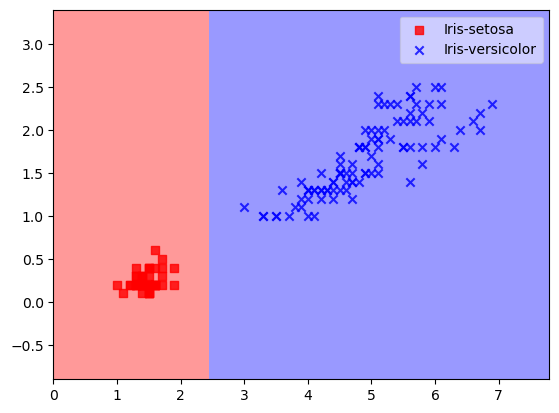

In [33]:
# %pdb
print (" Plotting the Decision Surface of Training Set... ")
t.plot_decision_regions(X[:,feat],Y,clf=dt, res=0.1, cycle_marker=True, legend=1)

In [34]:
# Split your data into training and test-set... 
# see the documentation of split_data in tools for further information...
Xtrain,Ytrain,Xtest,Ytest=t.split_data(X,Y)

print (" Training Data Set Dimensions=", Xtrain.shape, "Training True Class labels dimensions", Ytrain.shape  ) 
print (" Test Data Set Dimensions=", Xtest.shape, "Test True Class labels dimensions", Ytrain.shape   )


 Training Data Set Dimensions= (104, 4) Training True Class labels dimensions (104,)
 Test Data Set Dimensions= (45, 4) Test True Class labels dimensions (104,)


In [35]:
# Lets train a Decision Tree Classifier on Petal Length and Width
feat=[0,1]
dt=DecisionTree(0.95,5)
dt.train(Xtrain[:,feat],Ytrain)

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-

In [36]:
#Lets test it on the set of unseen examples...
pclasses=dt.predict(Xtest[:,feat])

Prediction for single example:  [5.4 3.4]
Going to the left
Prediction for single example:  [5.4 3.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 3.7]
Going to the left
Prediction for single example:  [5.3 3.7]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4 2.9]
Going to the left
Prediction for single example:  [4.4 2.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6 3.6]
Going to the left
Prediction for single example:  [4.6 3.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4 3.2]
Going to the left
Prediction for single example:  [4.4 3.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.4 3.9]
Going to the left
Prediction for single example:  [5.4 3.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.1]
Going to the left
Prediction for single example:  [4.9 3.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.3 3. ]

In [37]:
print(pclasses)

['Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-setosa', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-setosa', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-versicolor', 'Iris-setosa']


Lets see how good we are doing...
==================

In [38]:
#Lets see how good we are doing, by finding the accuracy on the test set..
print (np.sum(pclasses==Ytest))
print ("Accuracy = ", np.sum(pclasses==Ytest)/float(Ytest.shape[0]))

43
Accuracy =  0.9555555555555556


 Plotting the Decision Surface of Training Set... 
Prediction for single example:  [3.4 1. ]
Going to the left
Prediction for single example:  [3.4 1. ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.42 1.  ]
Going to the left
Prediction for single example:  [3.42 1.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.44 1.  ]
Going to the left
Prediction for single example:  [3.44 1.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.46 1.  ]
Going to the left
Prediction for single example:  [3.46 1.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.48 1.  ]
Going to the left
Prediction for single example:  [3.48 1.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.5 1. ]
Going to the left
Prediction for single example:  [3.5 1. ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.52 1.  ]
Going to the left
Prediction for single example:  [3.52 1.  ]
i am 

Prediction for single example:  [4.44 1.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.46 1.02]
Going to the left
Prediction for single example:  [4.46 1.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.48 1.02]
Going to the left
Prediction for single example:  [4.48 1.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5  1.02]
Going to the left
Prediction for single example:  [4.5  1.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 1.02]
Going to the left
Prediction for single example:  [4.52 1.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 1.02]
Going to the left
Prediction for single example:  [4.54 1.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 1.02]
Going to the left
Prediction for single example:  [4.56 1.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 1.02]
Going to the left
Prediction fo

Prediction for single example:  [8.52 1.02]
Going to the right
Prediction for single example:  [8.52 1.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 1.02]
Going to the right
Prediction for single example:  [8.54 1.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.56 1.02]
Going to the right
Prediction for single example:  [8.56 1.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 1.02]
Going to the right
Prediction for single example:  [8.58 1.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6  1.02]
Going to the right
Prediction for single example:  [8.6  1.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 1.02]
Going to the right
Prediction for single example:  [8.62 1.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 1.02]
Going to the right
Prediction for single example:  [8.64 1.02]
i am leaf label c

Prediction for single example:  [8.26 1.06]
Going to the right
Prediction for single example:  [8.26 1.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.28 1.06]
Going to the right
Prediction for single example:  [8.28 1.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.3  1.06]
Going to the right
Prediction for single example:  [8.3  1.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.32 1.06]
Going to the right
Prediction for single example:  [8.32 1.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 1.06]
Going to the right
Prediction for single example:  [8.34 1.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.36 1.06]
Going to the right
Prediction for single example:  [8.36 1.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.38 1.06]
Going to the right
Prediction for single example:  [8.38 1.06]
i am leaf label c

Prediction for single example:  [8.08 1.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1 1.1]
Going to the right
Prediction for single example:  [8.1 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.12 1.1 ]
Going to the right
Prediction for single example:  [8.12 1.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 1.1 ]
Going to the right
Prediction for single example:  [8.14 1.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 1.1 ]
Going to the right
Prediction for single example:  [8.16 1.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 1.1 ]
Going to the right
Prediction for single example:  [8.18 1.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2 1.1]
Going to the right
Prediction for single example:  [8.2 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 1.1 ]
Going

Prediction for single example:  [8.22 1.14]
Going to the right
Prediction for single example:  [8.22 1.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 1.14]
Going to the right
Prediction for single example:  [8.24 1.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.26 1.14]
Going to the right
Prediction for single example:  [8.26 1.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.28 1.14]
Going to the right
Prediction for single example:  [8.28 1.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.3  1.14]
Going to the right
Prediction for single example:  [8.3  1.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.32 1.14]
Going to the right
Prediction for single example:  [8.32 1.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 1.14]
Going to the right
Prediction for single example:  [8.34 1.14]
i am leaf label c

Prediction for single example:  [8.06 1.18]
Going to the right
Prediction for single example:  [8.06 1.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.08 1.18]
Going to the right
Prediction for single example:  [8.08 1.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1  1.18]
Going to the right
Prediction for single example:  [8.1  1.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.12 1.18]
Going to the right
Prediction for single example:  [8.12 1.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 1.18]
Going to the right
Prediction for single example:  [8.14 1.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 1.18]
Going to the right
Prediction for single example:  [8.16 1.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 1.18]
Going to the right
Prediction for single example:  [8.18 1.18]
i am leaf label c

Prediction for single example:  [8.08 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1  1.22]
Going to the right
Prediction for single example:  [8.1  1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.12 1.22]
Going to the right
Prediction for single example:  [8.12 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 1.22]
Going to the right
Prediction for single example:  [8.14 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 1.22]
Going to the right
Prediction for single example:  [8.16 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 1.22]
Going to the right
Prediction for single example:  [8.18 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2  1.22]
Going to the right
Prediction for single example:  [8.2  1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 1.2

Prediction for single example:  [5.46 1.26]
Going to the right
Prediction for single example:  [5.46 1.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 1.26]
Going to the right
Prediction for single example:  [5.48 1.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  1.26]
Going to the right
Prediction for single example:  [5.5  1.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 1.26]
Going to the right
Prediction for single example:  [5.52 1.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 1.26]
Going to the right
Prediction for single example:  [5.54 1.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 1.26]
Going to the right
Prediction for single example:  [5.56 1.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 1.26]
Going to the right
Prediction for single example:  [5.58 1.26]
i am leaf label c

Prediction for single example:  [8.28 1.3 ]
Going to the right
Prediction for single example:  [8.28 1.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.3 1.3]
Going to the right
Prediction for single example:  [8.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.32 1.3 ]
Going to the right
Prediction for single example:  [8.32 1.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 1.3 ]
Going to the right
Prediction for single example:  [8.34 1.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.36 1.3 ]
Going to the right
Prediction for single example:  [8.36 1.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.38 1.3 ]
Going to the right
Prediction for single example:  [8.38 1.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.4 1.3]
Going to the right
Prediction for single example:  [8.4 1.3]
i am leaf label class: Ir

Prediction for single example:  [5.64 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.66 1.34]
Going to the right
Prediction for single example:  [5.66 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.68 1.34]
Going to the right
Prediction for single example:  [5.68 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7  1.34]
Going to the right
Prediction for single example:  [5.7  1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.72 1.34]
Going to the right
Prediction for single example:  [5.72 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.74 1.34]
Going to the right
Prediction for single example:  [5.74 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 1.34]
Going to the right
Prediction for single example:  [5.76 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 1.3

Prediction for single example:  [3.6  1.38]
Going to the left
Prediction for single example:  [3.6  1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 1.38]
Going to the left
Prediction for single example:  [3.62 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 1.38]
Going to the left
Prediction for single example:  [3.64 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 1.38]
Going to the left
Prediction for single example:  [3.66 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 1.38]
Going to the left
Prediction for single example:  [3.68 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  1.38]
Going to the left
Prediction for single example:  [3.7  1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 1.38]
Going to the left
Prediction for single example:  [3.72 1.38]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.12 1.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 1.4 ]
Going to the right
Prediction for single example:  [8.14 1.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 1.4 ]
Going to the right
Prediction for single example:  [8.16 1.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 1.4 ]
Going to the right
Prediction for single example:  [8.18 1.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2 1.4]
Going to the right
Prediction for single example:  [8.2 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 1.4 ]
Going to the right
Prediction for single example:  [8.22 1.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 1.4 ]
Going to the right
Prediction for single example:  [8.24 1.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.26 1.4 ]
G

Prediction for single example:  [8.6  1.42]
Going to the right
Prediction for single example:  [8.6  1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 1.42]
Going to the right
Prediction for single example:  [8.62 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 1.42]
Going to the right
Prediction for single example:  [8.64 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 1.42]
Going to the right
Prediction for single example:  [8.66 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 1.42]
Going to the right
Prediction for single example:  [8.68 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.7  1.42]
Going to the right
Prediction for single example:  [8.7  1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.72 1.42]
Going to the right
Prediction for single example:  [8.72 1.42]
i am leaf label c

Prediction for single example:  [7.58 1.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  1.44]
Going to the right
Prediction for single example:  [7.6  1.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 1.44]
Going to the right
Prediction for single example:  [7.62 1.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 1.44]
Going to the right
Prediction for single example:  [7.64 1.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 1.44]
Going to the right
Prediction for single example:  [7.66 1.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 1.44]
Going to the right
Prediction for single example:  [7.68 1.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7  1.44]
Going to the right
Prediction for single example:  [7.7  1.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.72 1.4

Prediction for single example:  [7.58 1.46]
Going to the right
Prediction for single example:  [7.58 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  1.46]
Going to the right
Prediction for single example:  [7.6  1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 1.46]
Going to the right
Prediction for single example:  [7.62 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 1.46]
Going to the right
Prediction for single example:  [7.64 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 1.46]
Going to the right
Prediction for single example:  [7.66 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 1.46]
Going to the right
Prediction for single example:  [7.68 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7  1.46]
Going to the right
Prediction for single example:  [7.7  1.46]
i am leaf label c

Prediction for single example:  [5.76 1.5 ]
Going to the right
Prediction for single example:  [5.76 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 1.5 ]
Going to the right
Prediction for single example:  [5.78 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 1.5]
Going to the right
Prediction for single example:  [5.8 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.82 1.5 ]
Going to the right
Prediction for single example:  [5.82 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.84 1.5 ]
Going to the right
Prediction for single example:  [5.84 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.86 1.5 ]
Going to the right
Prediction for single example:  [5.86 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.88 1.5 ]
Going to the right
Prediction for single example:  [5.88 1.5 ]
i am leaf label class

Prediction for single example:  [6.26 1.52]
Going to the right
Prediction for single example:  [6.26 1.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.28 1.52]
Going to the right
Prediction for single example:  [6.28 1.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3  1.52]
Going to the right
Prediction for single example:  [6.3  1.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 1.52]
Going to the right
Prediction for single example:  [6.32 1.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 1.52]
Going to the right
Prediction for single example:  [6.34 1.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 1.52]
Going to the right
Prediction for single example:  [6.36 1.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 1.52]
Going to the right
Prediction for single example:  [6.38 1.52]
i am leaf label c

Prediction for single example:  [4.42 1.58]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.44 1.58]
Going to the left
Prediction for single example:  [4.44 1.58]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.46 1.58]
Going to the left
Prediction for single example:  [4.46 1.58]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.48 1.58]
Going to the left
Prediction for single example:  [4.48 1.58]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5  1.58]
Going to the left
Prediction for single example:  [4.5  1.58]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 1.58]
Going to the left
Prediction for single example:  [4.52 1.58]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 1.58]
Going to the left
Prediction for single example:  [4.54 1.58]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 1.58]
Going to the left
Prediction fo

Prediction for single example:  [6.46 1.62]
Going to the right
Prediction for single example:  [6.46 1.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 1.62]
Going to the right
Prediction for single example:  [6.48 1.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5  1.62]
Going to the right
Prediction for single example:  [6.5  1.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.52 1.62]
Going to the right
Prediction for single example:  [6.52 1.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.54 1.62]
Going to the right
Prediction for single example:  [6.54 1.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.56 1.62]
Going to the right
Prediction for single example:  [6.56 1.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.58 1.62]
Going to the right
Prediction for single example:  [6.58 1.62]
i am leaf label c

Prediction for single example:  [6.58 1.66]
Going to the right
Prediction for single example:  [6.58 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6  1.66]
Going to the right
Prediction for single example:  [6.6  1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.62 1.66]
Going to the right
Prediction for single example:  [6.62 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.64 1.66]
Going to the right
Prediction for single example:  [6.64 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.66 1.66]
Going to the right
Prediction for single example:  [6.66 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.68 1.66]
Going to the right
Prediction for single example:  [6.68 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7  1.66]
Going to the right
Prediction for single example:  [6.7  1.66]
i am leaf label c

Prediction for single example:  [4.18 1.7 ]
Going to the left
Prediction for single example:  [4.18 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.2 1.7]
Going to the left
Prediction for single example:  [4.2 1.7]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.22 1.7 ]
Going to the left
Prediction for single example:  [4.22 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.24 1.7 ]
Going to the left
Prediction for single example:  [4.24 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.26 1.7 ]
Going to the left
Prediction for single example:  [4.26 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.28 1.7 ]
Going to the left
Prediction for single example:  [4.28 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.3 1.7]
Going to the left
Prediction for single example:  [4.3 1.7]
i am leaf label class: Iris-setosa
Prediction for single

Prediction for single example:  [7.1  1.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.12 1.72]
Going to the right
Prediction for single example:  [7.12 1.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.14 1.72]
Going to the right
Prediction for single example:  [7.14 1.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 1.72]
Going to the right
Prediction for single example:  [7.16 1.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.18 1.72]
Going to the right
Prediction for single example:  [7.18 1.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2  1.72]
Going to the right
Prediction for single example:  [7.2  1.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.22 1.72]
Going to the right
Prediction for single example:  [7.22 1.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.24 1.7

Prediction for single example:  [7.3  1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.32 1.76]
Going to the right
Prediction for single example:  [7.32 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.34 1.76]
Going to the right
Prediction for single example:  [7.34 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.36 1.76]
Going to the right
Prediction for single example:  [7.36 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.38 1.76]
Going to the right
Prediction for single example:  [7.38 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.4  1.76]
Going to the right
Prediction for single example:  [7.4  1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.42 1.76]
Going to the right
Prediction for single example:  [7.42 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.44 1.7

Prediction for single example:  [7.36 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.38 1.8 ]
Going to the right
Prediction for single example:  [7.38 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.4 1.8]
Going to the right
Prediction for single example:  [7.4 1.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.42 1.8 ]
Going to the right
Prediction for single example:  [7.42 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.44 1.8 ]
Going to the right
Prediction for single example:  [7.44 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.46 1.8 ]
Going to the right
Prediction for single example:  [7.46 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.48 1.8 ]
Going to the right
Prediction for single example:  [7.48 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.5 1.8]
Goi

Prediction for single example:  [4.9  1.84]
Going to the left
Prediction for single example:  [4.9  1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.92 1.84]
Going to the left
Prediction for single example:  [4.92 1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 1.84]
Going to the left
Prediction for single example:  [4.94 1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 1.84]
Going to the left
Prediction for single example:  [4.96 1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 1.84]
Going to the left
Prediction for single example:  [4.98 1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   1.84]
Going to the left
Prediction for single example:  [5.   1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 1.84]
Going to the left
Prediction for single example:  [5.02 1.84]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.76 1.88]
Going to the right
Prediction for single example:  [6.76 1.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.78 1.88]
Going to the right
Prediction for single example:  [6.78 1.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8  1.88]
Going to the right
Prediction for single example:  [6.8  1.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 1.88]
Going to the right
Prediction for single example:  [6.82 1.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.84 1.88]
Going to the right
Prediction for single example:  [6.84 1.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.86 1.88]
Going to the right
Prediction for single example:  [6.86 1.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.88 1.88]
Going to the right
Prediction for single example:  [6.88 1.88]
i am leaf label c

Prediction for single example:  [7.58 1.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6 1.9]
Going to the right
Prediction for single example:  [7.6 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 1.9 ]
Going to the right
Prediction for single example:  [7.62 1.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 1.9 ]
Going to the right
Prediction for single example:  [7.64 1.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 1.9 ]
Going to the right
Prediction for single example:  [7.66 1.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 1.9 ]
Going to the right
Prediction for single example:  [7.68 1.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 1.9]
Going to the right
Prediction for single example:  [7.7 1.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.72 1.9 ]
Going

Prediction for single example:  [7.56 1.94]
Going to the right
Prediction for single example:  [7.56 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 1.94]
Going to the right
Prediction for single example:  [7.58 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  1.94]
Going to the right
Prediction for single example:  [7.6  1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 1.94]
Going to the right
Prediction for single example:  [7.62 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 1.94]
Going to the right
Prediction for single example:  [7.64 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 1.94]
Going to the right
Prediction for single example:  [7.66 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 1.94]
Going to the right
Prediction for single example:  [7.68 1.94]
i am leaf label c

Prediction for single example:  [4.34 1.98]
Going to the left
Prediction for single example:  [4.34 1.98]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.36 1.98]
Going to the left
Prediction for single example:  [4.36 1.98]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.38 1.98]
Going to the left
Prediction for single example:  [4.38 1.98]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4  1.98]
Going to the left
Prediction for single example:  [4.4  1.98]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.42 1.98]
Going to the left
Prediction for single example:  [4.42 1.98]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.44 1.98]
Going to the left
Prediction for single example:  [4.44 1.98]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.46 1.98]
Going to the left
Prediction for single example:  [4.46 1.98]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [5.1 2. ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.12 2.  ]
Going to the left
Prediction for single example:  [5.12 2.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.14 2.  ]
Going to the left
Prediction for single example:  [5.14 2.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.16 2.  ]
Going to the left
Prediction for single example:  [5.16 2.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 2.  ]
Going to the left
Prediction for single example:  [5.18 2.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 2. ]
Going to the left
Prediction for single example:  [5.2 2. ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 2.  ]
Going to the left
Prediction for single example:  [5.22 2.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 2.  ]
Going to the left
Prediction for sing

Prediction for single example:  [3.66 2.02]
Going to the left
Prediction for single example:  [3.66 2.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 2.02]
Going to the left
Prediction for single example:  [3.68 2.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  2.02]
Going to the left
Prediction for single example:  [3.7  2.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 2.02]
Going to the left
Prediction for single example:  [3.72 2.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 2.02]
Going to the left
Prediction for single example:  [3.74 2.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 2.02]
Going to the left
Prediction for single example:  [3.76 2.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 2.02]
Going to the left
Prediction for single example:  [3.78 2.02]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.72 2.04]
Going to the left
Prediction for single example:  [4.72 2.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.74 2.04]
Going to the left
Prediction for single example:  [4.74 2.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 2.04]
Going to the left
Prediction for single example:  [4.76 2.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 2.04]
Going to the left
Prediction for single example:  [4.78 2.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  2.04]
Going to the left
Prediction for single example:  [4.8  2.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 2.04]
Going to the left
Prediction for single example:  [4.82 2.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 2.04]
Going to the left
Prediction for single example:  [4.84 2.04]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.12 2.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 2.06]
Going to the right
Prediction for single example:  [6.14 2.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 2.06]
Going to the right
Prediction for single example:  [6.16 2.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.18 2.06]
Going to the right
Prediction for single example:  [6.18 2.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2  2.06]
Going to the right
Prediction for single example:  [6.2  2.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 2.06]
Going to the right
Prediction for single example:  [6.22 2.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.24 2.06]
Going to the right
Prediction for single example:  [6.24 2.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 2.0

Prediction for single example:  [4.2 2.1]
Going to the left
Prediction for single example:  [4.2 2.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.22 2.1 ]
Going to the left
Prediction for single example:  [4.22 2.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.24 2.1 ]
Going to the left
Prediction for single example:  [4.24 2.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.26 2.1 ]
Going to the left
Prediction for single example:  [4.26 2.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.28 2.1 ]
Going to the left
Prediction for single example:  [4.28 2.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.3 2.1]
Going to the left
Prediction for single example:  [4.3 2.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.32 2.1 ]
Going to the left
Prediction for single example:  [4.32 2.1 ]
i am leaf label class: Iris-setosa
Prediction for single

Prediction for single example:  [5.14 2.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.16 2.12]
Going to the left
Prediction for single example:  [5.16 2.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 2.12]
Going to the left
Prediction for single example:  [5.18 2.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2  2.12]
Going to the left
Prediction for single example:  [5.2  2.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 2.12]
Going to the left
Prediction for single example:  [5.22 2.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 2.12]
Going to the left
Prediction for single example:  [5.24 2.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 2.12]
Going to the left
Prediction for single example:  [5.26 2.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 2.12]
Going to the left
Prediction fo

Prediction for single example:  [4.86 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 2.16]
Going to the left
Prediction for single example:  [4.88 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9  2.16]
Going to the left
Prediction for single example:  [4.9  2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.92 2.16]
Going to the left
Prediction for single example:  [4.92 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 2.16]
Going to the left
Prediction for single example:  [4.94 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 2.16]
Going to the left
Prediction for single example:  [4.96 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 2.16]
Going to the left
Prediction for single example:  [4.98 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   2.16]
Going to the left
Prediction fo

Prediction for single example:  [7.1  2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.12 2.18]
Going to the right
Prediction for single example:  [7.12 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.14 2.18]
Going to the right
Prediction for single example:  [7.14 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 2.18]
Going to the right
Prediction for single example:  [7.16 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.18 2.18]
Going to the right
Prediction for single example:  [7.18 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2  2.18]
Going to the right
Prediction for single example:  [7.2  2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.22 2.18]
Going to the right
Prediction for single example:  [7.22 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.24 2.1

Prediction for single example:  [8.42 2.2 ]
Going to the right
Prediction for single example:  [8.42 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.44 2.2 ]
Going to the right
Prediction for single example:  [8.44 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.46 2.2 ]
Going to the right
Prediction for single example:  [8.46 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.48 2.2 ]
Going to the right
Prediction for single example:  [8.48 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.5 2.2]
Going to the right
Prediction for single example:  [8.5 2.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.52 2.2 ]
Going to the right
Prediction for single example:  [8.52 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 2.2 ]
Going to the right
Prediction for single example:  [8.54 2.2 ]
i am leaf label class

Prediction for single example:  [3.56 2.24]
Going to the left
Prediction for single example:  [3.56 2.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.58 2.24]
Going to the left
Prediction for single example:  [3.58 2.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.6  2.24]
Going to the left
Prediction for single example:  [3.6  2.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 2.24]
Going to the left
Prediction for single example:  [3.62 2.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 2.24]
Going to the left
Prediction for single example:  [3.64 2.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 2.24]
Going to the left
Prediction for single example:  [3.66 2.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 2.24]
Going to the left
Prediction for single example:  [3.68 2.24]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [3.64 2.26]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 2.26]
Going to the left
Prediction for single example:  [3.66 2.26]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 2.26]
Going to the left
Prediction for single example:  [3.68 2.26]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  2.26]
Going to the left
Prediction for single example:  [3.7  2.26]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 2.26]
Going to the left
Prediction for single example:  [3.72 2.26]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 2.26]
Going to the left
Prediction for single example:  [3.74 2.26]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 2.26]
Going to the left
Prediction for single example:  [3.76 2.26]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 2.26]
Going to the left
Prediction fo

Prediction for single example:  [5.42 2.28]
Going to the left
Prediction for single example:  [5.42 2.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.44 2.28]
Going to the left
Prediction for single example:  [5.44 2.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.46 2.28]
Going to the right
Prediction for single example:  [5.46 2.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 2.28]
Going to the right
Prediction for single example:  [5.48 2.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  2.28]
Going to the right
Prediction for single example:  [5.5  2.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 2.28]
Going to the right
Prediction for single example:  [5.52 2.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 2.28]
Going to the right
Prediction for single example:  [5.54 2.28]
i am leaf label class: Iris

i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 2.32]
Going to the left
Prediction for single example:  [3.62 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 2.32]
Going to the left
Prediction for single example:  [3.64 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 2.32]
Going to the left
Prediction for single example:  [3.66 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 2.32]
Going to the left
Prediction for single example:  [3.68 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  2.32]
Going to the left
Prediction for single example:  [3.7  2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 2.32]
Going to the left
Prediction for single example:  [3.72 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 2.32]
Going to the left
Prediction for single example:  [3.74 2.32]
i am leaf lab

Prediction for single example:  [6.34 2.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 2.34]
Going to the right
Prediction for single example:  [6.36 2.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 2.34]
Going to the right
Prediction for single example:  [6.38 2.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4  2.34]
Going to the right
Prediction for single example:  [6.4  2.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 2.34]
Going to the right
Prediction for single example:  [6.42 2.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 2.34]
Going to the right
Prediction for single example:  [6.44 2.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 2.34]
Going to the right
Prediction for single example:  [6.46 2.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 2.3

Prediction for single example:  [8.14 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 2.36]
Going to the right
Prediction for single example:  [8.16 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 2.36]
Going to the right
Prediction for single example:  [8.18 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2  2.36]
Going to the right
Prediction for single example:  [8.2  2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 2.36]
Going to the right
Prediction for single example:  [8.22 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 2.36]
Going to the right
Prediction for single example:  [8.24 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.26 2.36]
Going to the right
Prediction for single example:  [8.26 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.28 2.3

Prediction for single example:  [3.56 2.4 ]
Going to the left
Prediction for single example:  [3.56 2.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.58 2.4 ]
Going to the left
Prediction for single example:  [3.58 2.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.6 2.4]
Going to the left
Prediction for single example:  [3.6 2.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 2.4 ]
Going to the left
Prediction for single example:  [3.62 2.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 2.4 ]
Going to the left
Prediction for single example:  [3.64 2.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 2.4 ]
Going to the left
Prediction for single example:  [3.66 2.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 2.4 ]
Going to the left
Prediction for single example:  [3.68 2.4 ]
i am leaf label class: Iris-setosa
Prediction for si

Prediction for single example:  [3.6  2.42]
Going to the left
Prediction for single example:  [3.6  2.42]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 2.42]
Going to the left
Prediction for single example:  [3.62 2.42]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 2.42]
Going to the left
Prediction for single example:  [3.64 2.42]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 2.42]
Going to the left
Prediction for single example:  [3.66 2.42]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 2.42]
Going to the left
Prediction for single example:  [3.68 2.42]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  2.42]
Going to the left
Prediction for single example:  [3.7  2.42]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 2.42]
Going to the left
Prediction for single example:  [3.72 2.42]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.76 2.44]
Going to the left
Prediction for single example:  [4.76 2.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 2.44]
Going to the left
Prediction for single example:  [4.78 2.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  2.44]
Going to the left
Prediction for single example:  [4.8  2.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 2.44]
Going to the left
Prediction for single example:  [4.82 2.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 2.44]
Going to the left
Prediction for single example:  [4.84 2.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 2.44]
Going to the left
Prediction for single example:  [4.86 2.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 2.44]
Going to the left
Prediction for single example:  [4.88 2.44]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.36 2.44]
Going to the right
Prediction for single example:  [8.36 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.38 2.44]
Going to the right
Prediction for single example:  [8.38 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.4  2.44]
Going to the right
Prediction for single example:  [8.4  2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.42 2.44]
Going to the right
Prediction for single example:  [8.42 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.44 2.44]
Going to the right
Prediction for single example:  [8.44 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.46 2.44]
Going to the right
Prediction for single example:  [8.46 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.48 2.44]
Going to the right
Prediction for single example:  [8.48 2.44]
i am leaf label c

Prediction for single example:  [6.74 2.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.76 2.46]
Going to the right
Prediction for single example:  [6.76 2.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.78 2.46]
Going to the right
Prediction for single example:  [6.78 2.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8  2.46]
Going to the right
Prediction for single example:  [6.8  2.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 2.46]
Going to the right
Prediction for single example:  [6.82 2.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.84 2.46]
Going to the right
Prediction for single example:  [6.84 2.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.86 2.46]
Going to the right
Prediction for single example:  [6.86 2.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.88 2.4

Going to the left
Prediction for single example:  [4.72 2.5 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.74 2.5 ]
Going to the left
Prediction for single example:  [4.74 2.5 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 2.5 ]
Going to the left
Prediction for single example:  [4.76 2.5 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 2.5 ]
Going to the left
Prediction for single example:  [4.78 2.5 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8 2.5]
Going to the left
Prediction for single example:  [4.8 2.5]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 2.5 ]
Going to the left
Prediction for single example:  [4.82 2.5 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 2.5 ]
Going to the left
Prediction for single example:  [4.84 2.5 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 2.5 ]
Going to the left

i am leaf label class: Iris-setosa
Prediction for single example:  [4.44 2.52]
Going to the left
Prediction for single example:  [4.44 2.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.46 2.52]
Going to the left
Prediction for single example:  [4.46 2.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.48 2.52]
Going to the left
Prediction for single example:  [4.48 2.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5  2.52]
Going to the left
Prediction for single example:  [4.5  2.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 2.52]
Going to the left
Prediction for single example:  [4.52 2.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 2.52]
Going to the left
Prediction for single example:  [4.54 2.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 2.52]
Going to the left
Prediction for single example:  [4.56 2.52]
i am leaf lab

Prediction for single example:  [3.74 2.54]
Going to the left
Prediction for single example:  [3.74 2.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 2.54]
Going to the left
Prediction for single example:  [3.76 2.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 2.54]
Going to the left
Prediction for single example:  [3.78 2.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.8  2.54]
Going to the left
Prediction for single example:  [3.8  2.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 2.54]
Going to the left
Prediction for single example:  [3.82 2.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 2.54]
Going to the left
Prediction for single example:  [3.84 2.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 2.54]
Going to the left
Prediction for single example:  [3.86 2.54]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [7.74 2.54]
Going to the right
Prediction for single example:  [7.74 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.76 2.54]
Going to the right
Prediction for single example:  [7.76 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.78 2.54]
Going to the right
Prediction for single example:  [7.78 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.8  2.54]
Going to the right
Prediction for single example:  [7.8  2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.82 2.54]
Going to the right
Prediction for single example:  [7.82 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.84 2.54]
Going to the right
Prediction for single example:  [7.84 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.86 2.54]
Going to the right
Prediction for single example:  [7.86 2.54]
i am leaf label c

Prediction for single example:  [6.28 2.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3  2.56]
Going to the right
Prediction for single example:  [6.3  2.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 2.56]
Going to the right
Prediction for single example:  [6.32 2.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 2.56]
Going to the right
Prediction for single example:  [6.34 2.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 2.56]
Going to the right
Prediction for single example:  [6.36 2.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 2.56]
Going to the right
Prediction for single example:  [6.38 2.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4  2.56]
Going to the right
Prediction for single example:  [6.4  2.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 2.5

Prediction for single example:  [8.5  2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.52 2.58]
Going to the right
Prediction for single example:  [8.52 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 2.58]
Going to the right
Prediction for single example:  [8.54 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.56 2.58]
Going to the right
Prediction for single example:  [8.56 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 2.58]
Going to the right
Prediction for single example:  [8.58 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6  2.58]
Going to the right
Prediction for single example:  [8.6  2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 2.58]
Going to the right
Prediction for single example:  [8.62 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 2.5

Going to the right
Prediction for single example:  [8.32 2.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 2.6 ]
Going to the right
Prediction for single example:  [8.34 2.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.36 2.6 ]
Going to the right
Prediction for single example:  [8.36 2.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.38 2.6 ]
Going to the right
Prediction for single example:  [8.38 2.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.4 2.6]
Going to the right
Prediction for single example:  [8.4 2.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.42 2.6 ]
Going to the right
Prediction for single example:  [8.42 2.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.44 2.6 ]
Going to the right
Prediction for single example:  [8.44 2.6 ]
i am leaf label class: Iris-versicolor
Prediction for single exam

Prediction for single example:  [8.62 2.64]
Going to the right
Prediction for single example:  [8.62 2.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 2.64]
Going to the right
Prediction for single example:  [8.64 2.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 2.64]
Going to the right
Prediction for single example:  [8.66 2.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 2.64]
Going to the right
Prediction for single example:  [8.68 2.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.7  2.64]
Going to the right
Prediction for single example:  [8.7  2.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.72 2.64]
Going to the right
Prediction for single example:  [8.72 2.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.74 2.64]
Going to the right
Prediction for single example:  [8.74 2.64]
i am leaf label c

Prediction for single example:  [7.76 2.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.78 2.68]
Going to the right
Prediction for single example:  [7.78 2.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.8  2.68]
Going to the right
Prediction for single example:  [7.8  2.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.82 2.68]
Going to the right
Prediction for single example:  [7.82 2.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.84 2.68]
Going to the right
Prediction for single example:  [7.84 2.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.86 2.68]
Going to the right
Prediction for single example:  [7.86 2.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.88 2.68]
Going to the right
Prediction for single example:  [7.88 2.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.9  2.6

Prediction for single example:  [7.88 2.7 ]
Going to the right
Prediction for single example:  [7.88 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.9 2.7]
Going to the right
Prediction for single example:  [7.9 2.7]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.92 2.7 ]
Going to the right
Prediction for single example:  [7.92 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 2.7 ]
Going to the right
Prediction for single example:  [7.94 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 2.7 ]
Going to the right
Prediction for single example:  [7.96 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 2.7 ]
Going to the right
Prediction for single example:  [7.98 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.  2.7]
Going to the right
Prediction for single example:  [8.  2.7]
i am leaf label class: Ir

Prediction for single example:  [7.14 2.74]
Going to the right
Prediction for single example:  [7.14 2.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 2.74]
Going to the right
Prediction for single example:  [7.16 2.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.18 2.74]
Going to the right
Prediction for single example:  [7.18 2.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2  2.74]
Going to the right
Prediction for single example:  [7.2  2.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.22 2.74]
Going to the right
Prediction for single example:  [7.22 2.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.24 2.74]
Going to the right
Prediction for single example:  [7.24 2.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.26 2.74]
Going to the right
Prediction for single example:  [7.26 2.74]
i am leaf label c

Prediction for single example:  [4.56 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 2.78]
Going to the left
Prediction for single example:  [4.58 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6  2.78]
Going to the left
Prediction for single example:  [4.6  2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.62 2.78]
Going to the left
Prediction for single example:  [4.62 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.64 2.78]
Going to the left
Prediction for single example:  [4.64 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.66 2.78]
Going to the left
Prediction for single example:  [4.66 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.68 2.78]
Going to the left
Prediction for single example:  [4.68 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.7  2.78]
Going to the left
Prediction fo

Prediction for single example:  [5.24 2.8 ]
Going to the left
Prediction for single example:  [5.24 2.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 2.8 ]
Going to the left
Prediction for single example:  [5.26 2.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 2.8 ]
Going to the left
Prediction for single example:  [5.28 2.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 2.8]
Going to the left
Prediction for single example:  [5.3 2.8]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.32 2.8 ]
Going to the left
Prediction for single example:  [5.32 2.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.34 2.8 ]
Going to the left
Prediction for single example:  [5.34 2.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.36 2.8 ]
Going to the left
Prediction for single example:  [5.36 2.8 ]
i am leaf label class: Iris-setosa
Prediction for si

Prediction for single example:  [7.6  2.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 2.82]
Going to the right
Prediction for single example:  [7.62 2.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 2.82]
Going to the right
Prediction for single example:  [7.64 2.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 2.82]
Going to the right
Prediction for single example:  [7.66 2.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 2.82]
Going to the right
Prediction for single example:  [7.68 2.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7  2.82]
Going to the right
Prediction for single example:  [7.7  2.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.72 2.82]
Going to the right
Prediction for single example:  [7.72 2.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.74 2.8

Prediction for single example:  [5.72 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.74 2.86]
Going to the right
Prediction for single example:  [5.74 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 2.86]
Going to the right
Prediction for single example:  [5.76 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 2.86]
Going to the right
Prediction for single example:  [5.78 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8  2.86]
Going to the right
Prediction for single example:  [5.8  2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.82 2.86]
Going to the right
Prediction for single example:  [5.82 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.84 2.86]
Going to the right
Prediction for single example:  [5.84 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.86 2.8

Prediction for single example:  [6.52 2.88]
Going to the right
Prediction for single example:  [6.52 2.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.54 2.88]
Going to the right
Prediction for single example:  [6.54 2.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.56 2.88]
Going to the right
Prediction for single example:  [6.56 2.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.58 2.88]
Going to the right
Prediction for single example:  [6.58 2.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6  2.88]
Going to the right
Prediction for single example:  [6.6  2.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.62 2.88]
Going to the right
Prediction for single example:  [6.62 2.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.64 2.88]
Going to the right
Prediction for single example:  [6.64 2.88]
i am leaf label c

Prediction for single example:  [6.14 2.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 2.9 ]
Going to the right
Prediction for single example:  [6.16 2.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.18 2.9 ]
Going to the right
Prediction for single example:  [6.18 2.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.9]
Going to the right
Prediction for single example:  [6.2 2.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 2.9 ]
Going to the right
Prediction for single example:  [6.22 2.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.24 2.9 ]
Going to the right
Prediction for single example:  [6.24 2.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 2.9 ]
Going to the right
Prediction for single example:  [6.26 2.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.28 2.9 ]
G

i am leaf label class: Iris-versicolor
Prediction for single example:  [8.   2.92]
Going to the right
Prediction for single example:  [8.   2.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 2.92]
Going to the right
Prediction for single example:  [8.02 2.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.04 2.92]
Going to the right
Prediction for single example:  [8.04 2.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.06 2.92]
Going to the right
Prediction for single example:  [8.06 2.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.08 2.92]
Going to the right
Prediction for single example:  [8.08 2.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1  2.92]
Going to the right
Prediction for single example:  [8.1  2.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.12 2.92]
Going to the right
Prediction for single 

Prediction for single example:  [6.46 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 2.96]
Going to the right
Prediction for single example:  [6.48 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5  2.96]
Going to the right
Prediction for single example:  [6.5  2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.52 2.96]
Going to the right
Prediction for single example:  [6.52 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.54 2.96]
Going to the right
Prediction for single example:  [6.54 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.56 2.96]
Going to the right
Prediction for single example:  [6.56 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.58 2.96]
Going to the right
Prediction for single example:  [6.58 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6  2.9

Prediction for single example:  [8.3  2.98]
Going to the right
Prediction for single example:  [8.3  2.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.32 2.98]
Going to the right
Prediction for single example:  [8.32 2.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 2.98]
Going to the right
Prediction for single example:  [8.34 2.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.36 2.98]
Going to the right
Prediction for single example:  [8.36 2.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.38 2.98]
Going to the right
Prediction for single example:  [8.38 2.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.4  2.98]
Going to the right
Prediction for single example:  [8.4  2.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.42 2.98]
Going to the right
Prediction for single example:  [8.42 2.98]
i am leaf label c

Prediction for single example:  [5.58 3.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  3.02]
Going to the right
Prediction for single example:  [5.6  3.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.62 3.02]
Going to the right
Prediction for single example:  [5.62 3.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.64 3.02]
Going to the right
Prediction for single example:  [5.64 3.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.66 3.02]
Going to the right
Prediction for single example:  [5.66 3.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.68 3.02]
Going to the right
Prediction for single example:  [5.68 3.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7  3.02]
Going to the right
Prediction for single example:  [5.7  3.02]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.72 3.0

Prediction for single example:  [4.54 3.06]
Going to the left
Prediction for single example:  [4.54 3.06]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 3.06]
Going to the left
Prediction for single example:  [4.56 3.06]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 3.06]
Going to the left
Prediction for single example:  [4.58 3.06]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6  3.06]
Going to the left
Prediction for single example:  [4.6  3.06]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.62 3.06]
Going to the left
Prediction for single example:  [4.62 3.06]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.64 3.06]
Going to the left
Prediction for single example:  [4.64 3.06]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.66 3.06]
Going to the left
Prediction for single example:  [4.66 3.06]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [7.02 3.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.04 3.08]
Going to the right
Prediction for single example:  [7.04 3.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.06 3.08]
Going to the right
Prediction for single example:  [7.06 3.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.08 3.08]
Going to the right
Prediction for single example:  [7.08 3.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1  3.08]
Going to the right
Prediction for single example:  [7.1  3.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.12 3.08]
Going to the right
Prediction for single example:  [7.12 3.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.14 3.08]
Going to the right
Prediction for single example:  [7.14 3.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 3.0

Prediction for single example:  [8.12 3.1 ]
Going to the right
Prediction for single example:  [8.12 3.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 3.1 ]
Going to the right
Prediction for single example:  [8.14 3.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 3.1 ]
Going to the right
Prediction for single example:  [8.16 3.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 3.1 ]
Going to the right
Prediction for single example:  [8.18 3.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2 3.1]
Going to the right
Prediction for single example:  [8.2 3.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 3.1 ]
Going to the right
Prediction for single example:  [8.22 3.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 3.1 ]
Going to the right
Prediction for single example:  [8.24 3.1 ]
i am leaf label class

Prediction for single example:  [3.72 3.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 3.14]
Going to the left
Prediction for single example:  [3.74 3.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 3.14]
Going to the left
Prediction for single example:  [3.76 3.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 3.14]
Going to the left
Prediction for single example:  [3.78 3.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.8  3.14]
Going to the left
Prediction for single example:  [3.8  3.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 3.14]
Going to the left
Prediction for single example:  [3.82 3.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 3.14]
Going to the left
Prediction for single example:  [3.84 3.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 3.14]
Going to the left
Prediction fo

Prediction for single example:  [3.48 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.5  3.16]
Going to the left
Prediction for single example:  [3.5  3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.52 3.16]
Going to the left
Prediction for single example:  [3.52 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.54 3.16]
Going to the left
Prediction for single example:  [3.54 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.56 3.16]
Going to the left
Prediction for single example:  [3.56 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.58 3.16]
Going to the left
Prediction for single example:  [3.58 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.6  3.16]
Going to the left
Prediction for single example:  [3.6  3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 3.16]
Going to the left
Prediction fo

Prediction for single example:  [6.04 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.06 3.18]
Going to the right
Prediction for single example:  [6.06 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.08 3.18]
Going to the right
Prediction for single example:  [6.08 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1  3.18]
Going to the right
Prediction for single example:  [6.1  3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.12 3.18]
Going to the right
Prediction for single example:  [6.12 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 3.18]
Going to the right
Prediction for single example:  [6.14 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 3.18]
Going to the right
Prediction for single example:  [6.16 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.18 3.1

Prediction for single example:  [7.36 3.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.38 3.2 ]
Going to the right
Prediction for single example:  [7.38 3.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.4 3.2]
Going to the right
Prediction for single example:  [7.4 3.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.42 3.2 ]
Going to the right
Prediction for single example:  [7.42 3.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.44 3.2 ]
Going to the right
Prediction for single example:  [7.44 3.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.46 3.2 ]
Going to the right
Prediction for single example:  [7.46 3.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.48 3.2 ]
Going to the right
Prediction for single example:  [7.48 3.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.5 3.2]
Goi

Prediction for single example:  [3.48 3.24]
Going to the left
Prediction for single example:  [3.48 3.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.5  3.24]
Going to the left
Prediction for single example:  [3.5  3.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.52 3.24]
Going to the left
Prediction for single example:  [3.52 3.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.54 3.24]
Going to the left
Prediction for single example:  [3.54 3.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.56 3.24]
Going to the left
Prediction for single example:  [3.56 3.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.58 3.24]
Going to the left
Prediction for single example:  [3.58 3.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.6  3.24]
Going to the left
Prediction for single example:  [3.6  3.24]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.88 3.26]
Going to the right
Prediction for single example:  [6.88 3.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9  3.26]
Going to the right
Prediction for single example:  [6.9  3.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.92 3.26]
Going to the right
Prediction for single example:  [6.92 3.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.94 3.26]
Going to the right
Prediction for single example:  [6.94 3.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.96 3.26]
Going to the right
Prediction for single example:  [6.96 3.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.98 3.26]
Going to the right
Prediction for single example:  [6.98 3.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.   3.26]
Going to the right
Prediction for single example:  [7.   3.26]
i am leaf label c

Prediction for single example:  [7.92 3.28]
Going to the right
Prediction for single example:  [7.92 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 3.28]
Going to the right
Prediction for single example:  [7.94 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 3.28]
Going to the right
Prediction for single example:  [7.96 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 3.28]
Going to the right
Prediction for single example:  [7.98 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.   3.28]
Going to the right
Prediction for single example:  [8.   3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 3.28]
Going to the right
Prediction for single example:  [8.02 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.04 3.28]
Going to the right
Prediction for single example:  [8.04 3.28]
i am leaf label c

Prediction for single example:  [7.64 3.32]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 3.32]
Going to the right
Prediction for single example:  [7.66 3.32]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 3.32]
Going to the right
Prediction for single example:  [7.68 3.32]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7  3.32]
Going to the right
Prediction for single example:  [7.7  3.32]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.72 3.32]
Going to the right
Prediction for single example:  [7.72 3.32]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.74 3.32]
Going to the right
Prediction for single example:  [7.74 3.32]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.76 3.32]
Going to the right
Prediction for single example:  [7.76 3.32]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.78 3.3

Prediction for single example:  [8.56 3.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 3.34]
Going to the right
Prediction for single example:  [8.58 3.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6  3.34]
Going to the right
Prediction for single example:  [8.6  3.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 3.34]
Going to the right
Prediction for single example:  [8.62 3.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 3.34]
Going to the right
Prediction for single example:  [8.64 3.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 3.34]
Going to the right
Prediction for single example:  [8.66 3.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 3.34]
Going to the right
Prediction for single example:  [8.68 3.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.7  3.3

Prediction for single example:  [5.48 3.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  3.38]
Going to the right
Prediction for single example:  [5.5  3.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 3.38]
Going to the right
Prediction for single example:  [5.52 3.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 3.38]
Going to the right
Prediction for single example:  [5.54 3.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 3.38]
Going to the right
Prediction for single example:  [5.56 3.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 3.38]
Going to the right
Prediction for single example:  [5.58 3.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  3.38]
Going to the right
Prediction for single example:  [5.6  3.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.62 3.3

Prediction for single example:  [7.48 3.42]
Going to the right
Prediction for single example:  [7.48 3.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.5  3.42]
Going to the right
Prediction for single example:  [7.5  3.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.52 3.42]
Going to the right
Prediction for single example:  [7.52 3.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.54 3.42]
Going to the right
Prediction for single example:  [7.54 3.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.56 3.42]
Going to the right
Prediction for single example:  [7.56 3.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 3.42]
Going to the right
Prediction for single example:  [7.58 3.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  3.42]
Going to the right
Prediction for single example:  [7.6  3.42]
i am leaf label c

Prediction for single example:  [7.14 3.44]
Going to the right
Prediction for single example:  [7.14 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 3.44]
Going to the right
Prediction for single example:  [7.16 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.18 3.44]
Going to the right
Prediction for single example:  [7.18 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2  3.44]
Going to the right
Prediction for single example:  [7.2  3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.22 3.44]
Going to the right
Prediction for single example:  [7.22 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.24 3.44]
Going to the right
Prediction for single example:  [7.24 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.26 3.44]
Going to the right
Prediction for single example:  [7.26 3.44]
i am leaf label c

i am leaf label class: Iris-versicolor
Prediction for single example:  [7.44 3.46]
Going to the right
Prediction for single example:  [7.44 3.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.46 3.46]
Going to the right
Prediction for single example:  [7.46 3.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.48 3.46]
Going to the right
Prediction for single example:  [7.48 3.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.5  3.46]
Going to the right
Prediction for single example:  [7.5  3.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.52 3.46]
Going to the right
Prediction for single example:  [7.52 3.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.54 3.46]
Going to the right
Prediction for single example:  [7.54 3.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.56 3.46]
Going to the right
Prediction for single 

Prediction for single example:  [7.42 3.5 ]
Going to the right
Prediction for single example:  [7.42 3.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.44 3.5 ]
Going to the right
Prediction for single example:  [7.44 3.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.46 3.5 ]
Going to the right
Prediction for single example:  [7.46 3.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.48 3.5 ]
Going to the right
Prediction for single example:  [7.48 3.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.5 3.5]
Going to the right
Prediction for single example:  [7.5 3.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.52 3.5 ]
Going to the right
Prediction for single example:  [7.52 3.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.54 3.5 ]
Going to the right
Prediction for single example:  [7.54 3.5 ]
i am leaf label class

Prediction for single example:  [7.86 3.54]
Going to the right
Prediction for single example:  [7.86 3.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.88 3.54]
Going to the right
Prediction for single example:  [7.88 3.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.9  3.54]
Going to the right
Prediction for single example:  [7.9  3.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.92 3.54]
Going to the right
Prediction for single example:  [7.92 3.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 3.54]
Going to the right
Prediction for single example:  [7.94 3.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 3.54]
Going to the right
Prediction for single example:  [7.96 3.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 3.54]
Going to the right
Prediction for single example:  [7.98 3.54]
i am leaf label c

Prediction for single example:  [6.88 3.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9  3.58]
Going to the right
Prediction for single example:  [6.9  3.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.92 3.58]
Going to the right
Prediction for single example:  [6.92 3.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.94 3.58]
Going to the right
Prediction for single example:  [6.94 3.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.96 3.58]
Going to the right
Prediction for single example:  [6.96 3.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.98 3.58]
Going to the right
Prediction for single example:  [6.98 3.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.   3.58]
Going to the right
Prediction for single example:  [7.   3.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.02 3.5

Prediction for single example:  [6.12 3.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 3.6 ]
Going to the right
Prediction for single example:  [6.14 3.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 3.6 ]
Going to the right
Prediction for single example:  [6.16 3.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.18 3.6 ]
Going to the right
Prediction for single example:  [6.18 3.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 3.6]
Going to the right
Prediction for single example:  [6.2 3.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 3.6 ]
Going to the right
Prediction for single example:  [6.22 3.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.24 3.6 ]
Going to the right
Prediction for single example:  [6.24 3.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 3.6 ]
G

Prediction for single example:  [3.8  3.62]
Going to the left
Prediction for single example:  [3.8  3.62]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 3.62]
Going to the left
Prediction for single example:  [3.82 3.62]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 3.62]
Going to the left
Prediction for single example:  [3.84 3.62]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 3.62]
Going to the left
Prediction for single example:  [3.86 3.62]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.88 3.62]
Going to the left
Prediction for single example:  [3.88 3.62]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.9  3.62]
Going to the left
Prediction for single example:  [3.9  3.62]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.92 3.62]
Going to the left
Prediction for single example:  [3.92 3.62]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [5.42 3.64]
Going to the left
Prediction for single example:  [5.42 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.44 3.64]
Going to the left
Prediction for single example:  [5.44 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.46 3.64]
Going to the right
Prediction for single example:  [5.46 3.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 3.64]
Going to the right
Prediction for single example:  [5.48 3.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  3.64]
Going to the right
Prediction for single example:  [5.5  3.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 3.64]
Going to the right
Prediction for single example:  [5.52 3.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 3.64]
Going to the right
Prediction for single example:  [5.54 3.64]
i am leaf label class: Iris

Prediction for single example:  [8.64 3.66]
Going to the right
Prediction for single example:  [8.64 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 3.66]
Going to the right
Prediction for single example:  [8.66 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 3.66]
Going to the right
Prediction for single example:  [8.68 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.7  3.66]
Going to the right
Prediction for single example:  [8.7  3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.72 3.66]
Going to the right
Prediction for single example:  [8.72 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.74 3.66]
Going to the right
Prediction for single example:  [8.74 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.76 3.66]
Going to the right
Prediction for single example:  [8.76 3.66]
i am leaf label c

Prediction for single example:  [8.16 3.68]
Going to the right
Prediction for single example:  [8.16 3.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 3.68]
Going to the right
Prediction for single example:  [8.18 3.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2  3.68]
Going to the right
Prediction for single example:  [8.2  3.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 3.68]
Going to the right
Prediction for single example:  [8.22 3.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 3.68]
Going to the right
Prediction for single example:  [8.24 3.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.26 3.68]
Going to the right
Prediction for single example:  [8.26 3.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.28 3.68]
Going to the right
Prediction for single example:  [8.28 3.68]
i am leaf label c

Prediction for single example:  [6.62 3.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.64 3.7 ]
Going to the right
Prediction for single example:  [6.64 3.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.66 3.7 ]
Going to the right
Prediction for single example:  [6.66 3.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.68 3.7 ]
Going to the right
Prediction for single example:  [6.68 3.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.7]
Going to the right
Prediction for single example:  [6.7 3.7]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.72 3.7 ]
Going to the right
Prediction for single example:  [6.72 3.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.74 3.7 ]
Going to the right
Prediction for single example:  [6.74 3.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.76 3.7 ]
G

Prediction for single example:  [6.14 3.72]
Going to the right
Prediction for single example:  [6.14 3.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 3.72]
Going to the right
Prediction for single example:  [6.16 3.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.18 3.72]
Going to the right
Prediction for single example:  [6.18 3.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2  3.72]
Going to the right
Prediction for single example:  [6.2  3.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 3.72]
Going to the right
Prediction for single example:  [6.22 3.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.24 3.72]
Going to the right
Prediction for single example:  [6.24 3.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 3.72]
Going to the right
Prediction for single example:  [6.26 3.72]
i am leaf label c

Prediction for single example:  [6.78 3.74]
Going to the right
Prediction for single example:  [6.78 3.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8  3.74]
Going to the right
Prediction for single example:  [6.8  3.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 3.74]
Going to the right
Prediction for single example:  [6.82 3.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.84 3.74]
Going to the right
Prediction for single example:  [6.84 3.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.86 3.74]
Going to the right
Prediction for single example:  [6.86 3.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.88 3.74]
Going to the right
Prediction for single example:  [6.88 3.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9  3.74]
Going to the right
Prediction for single example:  [6.9  3.74]
i am leaf label c

Prediction for single example:  [6.44 3.76]
Going to the right
Prediction for single example:  [6.44 3.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 3.76]
Going to the right
Prediction for single example:  [6.46 3.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 3.76]
Going to the right
Prediction for single example:  [6.48 3.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5  3.76]
Going to the right
Prediction for single example:  [6.5  3.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.52 3.76]
Going to the right
Prediction for single example:  [6.52 3.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.54 3.76]
Going to the right
Prediction for single example:  [6.54 3.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.56 3.76]
Going to the right
Prediction for single example:  [6.56 3.76]
i am leaf label c

Prediction for single example:  [6.94 3.78]
Going to the right
Prediction for single example:  [6.94 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.96 3.78]
Going to the right
Prediction for single example:  [6.96 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.98 3.78]
Going to the right
Prediction for single example:  [6.98 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.   3.78]
Going to the right
Prediction for single example:  [7.   3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.02 3.78]
Going to the right
Prediction for single example:  [7.02 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.04 3.78]
Going to the right
Prediction for single example:  [7.04 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.06 3.78]
Going to the right
Prediction for single example:  [7.06 3.78]
i am leaf label c

Going to the left
Prediction for single example:  [5.16 3.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 3.8 ]
Going to the left
Prediction for single example:  [5.18 3.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 3.8]
Going to the left
Prediction for single example:  [5.2 3.8]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 3.8 ]
Going to the left
Prediction for single example:  [5.22 3.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 3.8 ]
Going to the left
Prediction for single example:  [5.24 3.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 3.8 ]
Going to the left
Prediction for single example:  [5.26 3.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 3.8 ]
Going to the left
Prediction for single example:  [5.28 3.8 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 3.8]
Going to the left
P

Prediction for single example:  [5.48 3.82]
Going to the right
Prediction for single example:  [5.48 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  3.82]
Going to the right
Prediction for single example:  [5.5  3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 3.82]
Going to the right
Prediction for single example:  [5.52 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 3.82]
Going to the right
Prediction for single example:  [5.54 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 3.82]
Going to the right
Prediction for single example:  [5.56 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 3.82]
Going to the right
Prediction for single example:  [5.58 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  3.82]
Going to the right
Prediction for single example:  [5.6  3.82]
i am leaf label c

Prediction for single example:  [4.44 3.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.46 3.84]
Going to the left
Prediction for single example:  [4.46 3.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.48 3.84]
Going to the left
Prediction for single example:  [4.48 3.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5  3.84]
Going to the left
Prediction for single example:  [4.5  3.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 3.84]
Going to the left
Prediction for single example:  [4.52 3.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 3.84]
Going to the left
Prediction for single example:  [4.54 3.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 3.84]
Going to the left
Prediction for single example:  [4.56 3.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 3.84]
Going to the left
Prediction fo

i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 3.86]
Going to the left
Prediction for single example:  [4.56 3.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 3.86]
Going to the left
Prediction for single example:  [4.58 3.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6  3.86]
Going to the left
Prediction for single example:  [4.6  3.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.62 3.86]
Going to the left
Prediction for single example:  [4.62 3.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.64 3.86]
Going to the left
Prediction for single example:  [4.64 3.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.66 3.86]
Going to the left
Prediction for single example:  [4.66 3.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.68 3.86]
Going to the left
Prediction for single example:  [4.68 3.86]
i am leaf lab

Prediction for single example:  [4.1  3.88]
Going to the left
Prediction for single example:  [4.1  3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.12 3.88]
Going to the left
Prediction for single example:  [4.12 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.14 3.88]
Going to the left
Prediction for single example:  [4.14 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.16 3.88]
Going to the left
Prediction for single example:  [4.16 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.18 3.88]
Going to the left
Prediction for single example:  [4.18 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.2  3.88]
Going to the left
Prediction for single example:  [4.2  3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.22 3.88]
Going to the left
Prediction for single example:  [4.22 3.88]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [3.78 3.9 ]
Going to the left
Prediction for single example:  [3.78 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.8 3.9]
Going to the left
Prediction for single example:  [3.8 3.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 3.9 ]
Going to the left
Prediction for single example:  [3.82 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 3.9 ]
Going to the left
Prediction for single example:  [3.84 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 3.9 ]
Going to the left
Prediction for single example:  [3.86 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.88 3.9 ]
Going to the left
Prediction for single example:  [3.88 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.9 3.9]
Going to the left
Prediction for single example:  [3.9 3.9]
i am leaf label class: Iris-setosa
Prediction for single

Prediction for single example:  [7.94 3.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 3.92]
Going to the right
Prediction for single example:  [7.96 3.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 3.92]
Going to the right
Prediction for single example:  [7.98 3.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.   3.92]
Going to the right
Prediction for single example:  [8.   3.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 3.92]
Going to the right
Prediction for single example:  [8.02 3.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.04 3.92]
Going to the right
Prediction for single example:  [8.04 3.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.06 3.92]
Going to the right
Prediction for single example:  [8.06 3.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.08 3.9

Prediction for single example:  [5.08 3.96]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.1  3.96]
Going to the left
Prediction for single example:  [5.1  3.96]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.12 3.96]
Going to the left
Prediction for single example:  [5.12 3.96]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.14 3.96]
Going to the left
Prediction for single example:  [5.14 3.96]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.16 3.96]
Going to the left
Prediction for single example:  [5.16 3.96]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 3.96]
Going to the left
Prediction for single example:  [5.18 3.96]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2  3.96]
Going to the left
Prediction for single example:  [5.2  3.96]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 3.96]
Going to the left
Prediction fo

Prediction for single example:  [6.68 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7  3.98]
Going to the right
Prediction for single example:  [6.7  3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.72 3.98]
Going to the right
Prediction for single example:  [6.72 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.74 3.98]
Going to the right
Prediction for single example:  [6.74 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.76 3.98]
Going to the right
Prediction for single example:  [6.76 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.78 3.98]
Going to the right
Prediction for single example:  [6.78 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8  3.98]
Going to the right
Prediction for single example:  [6.8  3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 3.9

Prediction for single example:  [3.62 4.02]
Going to the left
Prediction for single example:  [3.62 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 4.02]
Going to the left
Prediction for single example:  [3.64 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 4.02]
Going to the left
Prediction for single example:  [3.66 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 4.02]
Going to the left
Prediction for single example:  [3.68 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  4.02]
Going to the left
Prediction for single example:  [3.7  4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 4.02]
Going to the left
Prediction for single example:  [3.72 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 4.02]
Going to the left
Prediction for single example:  [3.74 4.02]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.76 4.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 4.04]
Going to the left
Prediction for single example:  [4.78 4.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  4.04]
Going to the left
Prediction for single example:  [4.8  4.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 4.04]
Going to the left
Prediction for single example:  [4.82 4.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 4.04]
Going to the left
Prediction for single example:  [4.84 4.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 4.04]
Going to the left
Prediction for single example:  [4.86 4.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 4.04]
Going to the left
Prediction for single example:  [4.88 4.04]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9  4.04]
Going to the left
Prediction fo

Prediction for single example:  [8.62 4.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 4.04]
Going to the right
Prediction for single example:  [8.64 4.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 4.04]
Going to the right
Prediction for single example:  [8.66 4.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 4.04]
Going to the right
Prediction for single example:  [8.68 4.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.7  4.04]
Going to the right
Prediction for single example:  [8.7  4.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.72 4.04]
Going to the right
Prediction for single example:  [8.72 4.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.74 4.04]
Going to the right
Prediction for single example:  [8.74 4.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.76 4.0

Prediction for single example:  [4.   4.08]
Going to the left
Prediction for single example:  [4.   4.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.02 4.08]
Going to the left
Prediction for single example:  [4.02 4.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.04 4.08]
Going to the left
Prediction for single example:  [4.04 4.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.06 4.08]
Going to the left
Prediction for single example:  [4.06 4.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.08 4.08]
Going to the left
Prediction for single example:  [4.08 4.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.1  4.08]
Going to the left
Prediction for single example:  [4.1  4.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.12 4.08]
Going to the left
Prediction for single example:  [4.12 4.08]
i am leaf label class: Iris-setosa
Prediction fo

Going to the left
Prediction for single example:  [4.86 4.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 4.1 ]
Going to the left
Prediction for single example:  [4.88 4.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 4.1]
Going to the left
Prediction for single example:  [4.9 4.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.92 4.1 ]
Going to the left
Prediction for single example:  [4.92 4.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 4.1 ]
Going to the left
Prediction for single example:  [4.94 4.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 4.1 ]
Going to the left
Prediction for single example:  [4.96 4.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 4.1 ]
Going to the left
Prediction for single example:  [4.98 4.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  4.1]
Going to the left
P

Prediction for single example:  [8.56 4.1 ]
Going to the right
Prediction for single example:  [8.56 4.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 4.1 ]
Going to the right
Prediction for single example:  [8.58 4.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6 4.1]
Going to the right
Prediction for single example:  [8.6 4.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 4.1 ]
Going to the right
Prediction for single example:  [8.62 4.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 4.1 ]
Going to the right
Prediction for single example:  [8.64 4.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 4.1 ]
Going to the right
Prediction for single example:  [8.66 4.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 4.1 ]
Going to the right
Prediction for single example:  [8.68 4.1 ]
i am leaf label class

Prediction for single example:  [4.26 4.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.28 4.14]
Going to the left
Prediction for single example:  [4.28 4.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.3  4.14]
Going to the left
Prediction for single example:  [4.3  4.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.32 4.14]
Going to the left
Prediction for single example:  [4.32 4.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.34 4.14]
Going to the left
Prediction for single example:  [4.34 4.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.36 4.14]
Going to the left
Prediction for single example:  [4.36 4.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.38 4.14]
Going to the left
Prediction for single example:  [4.38 4.14]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4  4.14]
Going to the left
Prediction fo

Prediction for single example:  [7.4  4.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.42 4.16]
Going to the right
Prediction for single example:  [7.42 4.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.44 4.16]
Going to the right
Prediction for single example:  [7.44 4.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.46 4.16]
Going to the right
Prediction for single example:  [7.46 4.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.48 4.16]
Going to the right
Prediction for single example:  [7.48 4.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.5  4.16]
Going to the right
Prediction for single example:  [7.5  4.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.52 4.16]
Going to the right
Prediction for single example:  [7.52 4.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.54 4.1

Prediction for single example:  [5.46 4.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 4.2 ]
Going to the right
Prediction for single example:  [5.48 4.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 4.2]
Going to the right
Prediction for single example:  [5.5 4.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 4.2 ]
Going to the right
Prediction for single example:  [5.52 4.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 4.2 ]
Going to the right
Prediction for single example:  [5.54 4.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 4.2 ]
Going to the right
Prediction for single example:  [5.56 4.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 4.2 ]
Going to the right
Prediction for single example:  [5.58 4.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 4.2]
Goi

Prediction for single example:  [4.62 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.64 4.24]
Going to the left
Prediction for single example:  [4.64 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.66 4.24]
Going to the left
Prediction for single example:  [4.66 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.68 4.24]
Going to the left
Prediction for single example:  [4.68 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.7  4.24]
Going to the left
Prediction for single example:  [4.7  4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.72 4.24]
Going to the left
Prediction for single example:  [4.72 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.74 4.24]
Going to the left
Prediction for single example:  [4.74 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 4.24]
Going to the left
Prediction fo

Prediction for single example:  [4.34 4.28]
Going to the left
Prediction for single example:  [4.34 4.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.36 4.28]
Going to the left
Prediction for single example:  [4.36 4.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.38 4.28]
Going to the left
Prediction for single example:  [4.38 4.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4  4.28]
Going to the left
Prediction for single example:  [4.4  4.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.42 4.28]
Going to the left
Prediction for single example:  [4.42 4.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.44 4.28]
Going to the left
Prediction for single example:  [4.44 4.28]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.46 4.28]
Going to the left
Prediction for single example:  [4.46 4.28]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [3.94 4.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.96 4.3 ]
Going to the left
Prediction for single example:  [3.96 4.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.98 4.3 ]
Going to the left
Prediction for single example:  [3.98 4.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.  4.3]
Going to the left
Prediction for single example:  [4.  4.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.02 4.3 ]
Going to the left
Prediction for single example:  [4.02 4.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.04 4.3 ]
Going to the left
Prediction for single example:  [4.04 4.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.06 4.3 ]
Going to the left
Prediction for single example:  [4.06 4.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.08 4.3 ]
Going to the left
Prediction for si

Prediction for single example:  [4.74 4.32]
Going to the left
Prediction for single example:  [4.74 4.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 4.32]
Going to the left
Prediction for single example:  [4.76 4.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 4.32]
Going to the left
Prediction for single example:  [4.78 4.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  4.32]
Going to the left
Prediction for single example:  [4.8  4.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 4.32]
Going to the left
Prediction for single example:  [4.82 4.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 4.32]
Going to the left
Prediction for single example:  [4.84 4.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 4.32]
Going to the left
Prediction for single example:  [4.86 4.32]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.48 4.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5  4.34]
Going to the left
Prediction for single example:  [4.5  4.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 4.34]
Going to the left
Prediction for single example:  [4.52 4.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 4.34]
Going to the left
Prediction for single example:  [4.54 4.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 4.34]
Going to the left
Prediction for single example:  [4.56 4.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 4.34]
Going to the left
Prediction for single example:  [4.58 4.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6  4.34]
Going to the left
Prediction for single example:  [4.6  4.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.62 4.34]
Going to the left
Prediction fo

Prediction for single example:  [7.8  4.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.82 4.34]
Going to the right
Prediction for single example:  [7.82 4.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.84 4.34]
Going to the right
Prediction for single example:  [7.84 4.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.86 4.34]
Going to the right
Prediction for single example:  [7.86 4.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.88 4.34]
Going to the right
Prediction for single example:  [7.88 4.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.9  4.34]
Going to the right
Prediction for single example:  [7.9  4.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.92 4.34]
Going to the right
Prediction for single example:  [7.92 4.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 4.3

Prediction for single example:  [8.26 4.36]
Going to the right
Prediction for single example:  [8.26 4.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.28 4.36]
Going to the right
Prediction for single example:  [8.28 4.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.3  4.36]
Going to the right
Prediction for single example:  [8.3  4.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.32 4.36]
Going to the right
Prediction for single example:  [8.32 4.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 4.36]
Going to the right
Prediction for single example:  [8.34 4.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.36 4.36]
Going to the right
Prediction for single example:  [8.36 4.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.38 4.36]
Going to the right
Prediction for single example:  [8.38 4.36]
i am leaf label c

Prediction for single example:  [8.22 4.38]
Going to the right
Prediction for single example:  [8.22 4.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 4.38]
Going to the right
Prediction for single example:  [8.24 4.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.26 4.38]
Going to the right
Prediction for single example:  [8.26 4.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.28 4.38]
Going to the right
Prediction for single example:  [8.28 4.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.3  4.38]
Going to the right
Prediction for single example:  [8.3  4.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.32 4.38]
Going to the right
Prediction for single example:  [8.32 4.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 4.38]
Going to the right
Prediction for single example:  [8.34 4.38]
i am leaf label c

Prediction for single example:  [4.56 4.44]
Going to the left
Prediction for single example:  [4.56 4.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 4.44]
Going to the left
Prediction for single example:  [4.58 4.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6  4.44]
Going to the left
Prediction for single example:  [4.6  4.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.62 4.44]
Going to the left
Prediction for single example:  [4.62 4.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.64 4.44]
Going to the left
Prediction for single example:  [4.64 4.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.66 4.44]
Going to the left
Prediction for single example:  [4.66 4.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.68 4.44]
Going to the left
Prediction for single example:  [4.68 4.44]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.74 4.46]
Going to the left
Prediction for single example:  [4.74 4.46]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 4.46]
Going to the left
Prediction for single example:  [4.76 4.46]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 4.46]
Going to the left
Prediction for single example:  [4.78 4.46]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  4.46]
Going to the left
Prediction for single example:  [4.8  4.46]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 4.46]
Going to the left
Prediction for single example:  [4.82 4.46]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 4.46]
Going to the left
Prediction for single example:  [4.84 4.46]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 4.46]
Going to the left
Prediction for single example:  [4.86 4.46]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.14 4.48]
Going to the right
Prediction for single example:  [6.14 4.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 4.48]
Going to the right
Prediction for single example:  [6.16 4.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.18 4.48]
Going to the right
Prediction for single example:  [6.18 4.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2  4.48]
Going to the right
Prediction for single example:  [6.2  4.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 4.48]
Going to the right
Prediction for single example:  [6.22 4.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.24 4.48]
Going to the right
Prediction for single example:  [6.24 4.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 4.48]
Going to the right
Prediction for single example:  [6.26 4.48]
i am leaf label c

Prediction for single example:  [3.54 4.52]
Going to the left
Prediction for single example:  [3.54 4.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.56 4.52]
Going to the left
Prediction for single example:  [3.56 4.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.58 4.52]
Going to the left
Prediction for single example:  [3.58 4.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.6  4.52]
Going to the left
Prediction for single example:  [3.6  4.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 4.52]
Going to the left
Prediction for single example:  [3.62 4.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 4.52]
Going to the left
Prediction for single example:  [3.64 4.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 4.52]
Going to the left
Prediction for single example:  [3.66 4.52]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.74 4.52]
Going to the right
Prediction for single example:  [8.74 4.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.76 4.52]
Going to the right
Prediction for single example:  [8.76 4.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.78 4.52]
Going to the right
Prediction for single example:  [8.78 4.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.8  4.52]
Going to the right
Prediction for single example:  [8.8  4.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.82 4.52]
Going to the right
Prediction for single example:  [8.82 4.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.84 4.52]
Going to the right
Prediction for single example:  [8.84 4.52]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.86 4.52]
Going to the right
Prediction for single example:  [8.86 4.52]
i am leaf label c

Prediction for single example:  [4.66 4.56]
Going to the left
Prediction for single example:  [4.66 4.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.68 4.56]
Going to the left
Prediction for single example:  [4.68 4.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.7  4.56]
Going to the left
Prediction for single example:  [4.7  4.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.72 4.56]
Going to the left
Prediction for single example:  [4.72 4.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.74 4.56]
Going to the left
Prediction for single example:  [4.74 4.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 4.56]
Going to the left
Prediction for single example:  [4.76 4.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 4.56]
Going to the left
Prediction for single example:  [4.78 4.56]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.74 4.58]
Going to the right
Prediction for single example:  [6.74 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.76 4.58]
Going to the right
Prediction for single example:  [6.76 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.78 4.58]
Going to the right
Prediction for single example:  [6.78 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8  4.58]
Going to the right
Prediction for single example:  [6.8  4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 4.58]
Going to the right
Prediction for single example:  [6.82 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.84 4.58]
Going to the right
Prediction for single example:  [6.84 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.86 4.58]
Going to the right
Prediction for single example:  [6.86 4.58]
i am leaf label c

Prediction for single example:  [4.18 4.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.2 4.6]
Going to the left
Prediction for single example:  [4.2 4.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.22 4.6 ]
Going to the left
Prediction for single example:  [4.22 4.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.24 4.6 ]
Going to the left
Prediction for single example:  [4.24 4.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.26 4.6 ]
Going to the left
Prediction for single example:  [4.26 4.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.28 4.6 ]
Going to the left
Prediction for single example:  [4.28 4.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.3 4.6]
Going to the left
Prediction for single example:  [4.3 4.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.32 4.6 ]
Going to the left
Prediction for single

Prediction for single example:  [7.16 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.18 4.6 ]
Going to the right
Prediction for single example:  [7.18 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2 4.6]
Going to the right
Prediction for single example:  [7.2 4.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.22 4.6 ]
Going to the right
Prediction for single example:  [7.22 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.24 4.6 ]
Going to the right
Prediction for single example:  [7.24 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.26 4.6 ]
Going to the right
Prediction for single example:  [7.26 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.28 4.6 ]
Going to the right
Prediction for single example:  [7.28 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.3 4.6]
Goi

Prediction for single example:  [6.02 4.62]
Going to the right
Prediction for single example:  [6.02 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.04 4.62]
Going to the right
Prediction for single example:  [6.04 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.06 4.62]
Going to the right
Prediction for single example:  [6.06 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.08 4.62]
Going to the right
Prediction for single example:  [6.08 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1  4.62]
Going to the right
Prediction for single example:  [6.1  4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.12 4.62]
Going to the right
Prediction for single example:  [6.12 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 4.62]
Going to the right
Prediction for single example:  [6.14 4.62]
i am leaf label c

Prediction for single example:  [7.36 4.64]
Going to the right
Prediction for single example:  [7.36 4.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.38 4.64]
Going to the right
Prediction for single example:  [7.38 4.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.4  4.64]
Going to the right
Prediction for single example:  [7.4  4.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.42 4.64]
Going to the right
Prediction for single example:  [7.42 4.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.44 4.64]
Going to the right
Prediction for single example:  [7.44 4.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.46 4.64]
Going to the right
Prediction for single example:  [7.46 4.64]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.48 4.64]
Going to the right
Prediction for single example:  [7.48 4.64]
i am leaf label c

Prediction for single example:  [6.36 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 4.66]
Going to the right
Prediction for single example:  [6.38 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4  4.66]
Going to the right
Prediction for single example:  [6.4  4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 4.66]
Going to the right
Prediction for single example:  [6.42 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 4.66]
Going to the right
Prediction for single example:  [6.44 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 4.66]
Going to the right
Prediction for single example:  [6.46 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 4.66]
Going to the right
Prediction for single example:  [6.48 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5  4.6

Prediction for single example:  [4.62 4.68]
Going to the left
Prediction for single example:  [4.62 4.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.64 4.68]
Going to the left
Prediction for single example:  [4.64 4.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.66 4.68]
Going to the left
Prediction for single example:  [4.66 4.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.68 4.68]
Going to the left
Prediction for single example:  [4.68 4.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.7  4.68]
Going to the left
Prediction for single example:  [4.7  4.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.72 4.68]
Going to the left
Prediction for single example:  [4.72 4.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.74 4.68]
Going to the left
Prediction for single example:  [4.74 4.68]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.5  4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.52 4.68]
Going to the right
Prediction for single example:  [8.52 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 4.68]
Going to the right
Prediction for single example:  [8.54 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.56 4.68]
Going to the right
Prediction for single example:  [8.56 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 4.68]
Going to the right
Prediction for single example:  [8.58 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6  4.68]
Going to the right
Prediction for single example:  [8.6  4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 4.68]
Going to the right
Prediction for single example:  [8.62 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 4.6

Prediction for single example:  [6.34 4.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 4.72]
Going to the right
Prediction for single example:  [6.36 4.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 4.72]
Going to the right
Prediction for single example:  [6.38 4.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4  4.72]
Going to the right
Prediction for single example:  [6.4  4.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 4.72]
Going to the right
Prediction for single example:  [6.42 4.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 4.72]
Going to the right
Prediction for single example:  [6.44 4.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 4.72]
Going to the right
Prediction for single example:  [6.46 4.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 4.7

Prediction for single example:  [4.78 4.74]
Going to the left
Prediction for single example:  [4.78 4.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  4.74]
Going to the left
Prediction for single example:  [4.8  4.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 4.74]
Going to the left
Prediction for single example:  [4.82 4.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 4.74]
Going to the left
Prediction for single example:  [4.84 4.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 4.74]
Going to the left
Prediction for single example:  [4.86 4.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 4.74]
Going to the left
Prediction for single example:  [4.88 4.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9  4.74]
Going to the left
Prediction for single example:  [4.9  4.74]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [7.76 4.76]
Going to the right
Prediction for single example:  [7.76 4.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.78 4.76]
Going to the right
Prediction for single example:  [7.78 4.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.8  4.76]
Going to the right
Prediction for single example:  [7.8  4.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.82 4.76]
Going to the right
Prediction for single example:  [7.82 4.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.84 4.76]
Going to the right
Prediction for single example:  [7.84 4.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.86 4.76]
Going to the right
Prediction for single example:  [7.86 4.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.88 4.76]
Going to the right
Prediction for single example:  [7.88 4.76]
i am leaf label c

Prediction for single example:  [7.06 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.08 4.8 ]
Going to the right
Prediction for single example:  [7.08 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1 4.8]
Going to the right
Prediction for single example:  [7.1 4.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.12 4.8 ]
Going to the right
Prediction for single example:  [7.12 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.14 4.8 ]
Going to the right
Prediction for single example:  [7.14 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 4.8 ]
Going to the right
Prediction for single example:  [7.16 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.18 4.8 ]
Going to the right
Prediction for single example:  [7.18 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2 4.8]
Goi

Prediction for single example:  [3.58 4.84]
Going to the left
Prediction for single example:  [3.58 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.6  4.84]
Going to the left
Prediction for single example:  [3.6  4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 4.84]
Going to the left
Prediction for single example:  [3.62 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 4.84]
Going to the left
Prediction for single example:  [3.64 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 4.84]
Going to the left
Prediction for single example:  [3.66 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 4.84]
Going to the left
Prediction for single example:  [3.68 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  4.84]
Going to the left
Prediction for single example:  [3.7  4.84]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.82 4.86]
Going to the left
Prediction for single example:  [4.82 4.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 4.86]
Going to the left
Prediction for single example:  [4.84 4.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 4.86]
Going to the left
Prediction for single example:  [4.86 4.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 4.86]
Going to the left
Prediction for single example:  [4.88 4.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9  4.86]
Going to the left
Prediction for single example:  [4.9  4.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.92 4.86]
Going to the left
Prediction for single example:  [4.92 4.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 4.86]
Going to the left
Prediction for single example:  [4.94 4.86]
i am leaf label class: Iris-setosa
Prediction fo

Going to the right
Prediction for single example:  [7.78 4.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.8  4.88]
Going to the right
Prediction for single example:  [7.8  4.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.82 4.88]
Going to the right
Prediction for single example:  [7.82 4.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.84 4.88]
Going to the right
Prediction for single example:  [7.84 4.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.86 4.88]
Going to the right
Prediction for single example:  [7.86 4.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.88 4.88]
Going to the right
Prediction for single example:  [7.88 4.88]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.9  4.88]
Going to the right
Prediction for single example:  [7.9  4.88]
i am leaf label class: Iris-versicolor
Prediction for single 

Prediction for single example:  [7.04 4.9 ]
Going to the right
Prediction for single example:  [7.04 4.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.06 4.9 ]
Going to the right
Prediction for single example:  [7.06 4.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.08 4.9 ]
Going to the right
Prediction for single example:  [7.08 4.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1 4.9]
Going to the right
Prediction for single example:  [7.1 4.9]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.12 4.9 ]
Going to the right
Prediction for single example:  [7.12 4.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.14 4.9 ]
Going to the right
Prediction for single example:  [7.14 4.9 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 4.9 ]
Going to the right
Prediction for single example:  [7.16 4.9 ]
i am leaf label class

Prediction for single example:  [4.72 4.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.74 4.94]
Going to the left
Prediction for single example:  [4.74 4.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 4.94]
Going to the left
Prediction for single example:  [4.76 4.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 4.94]
Going to the left
Prediction for single example:  [4.78 4.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  4.94]
Going to the left
Prediction for single example:  [4.8  4.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 4.94]
Going to the left
Prediction for single example:  [4.82 4.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 4.94]
Going to the left
Prediction for single example:  [4.84 4.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 4.94]
Going to the left
Prediction fo

Prediction for single example:  [7.56 4.96]
Going to the right
Prediction for single example:  [7.56 4.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 4.96]
Going to the right
Prediction for single example:  [7.58 4.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  4.96]
Going to the right
Prediction for single example:  [7.6  4.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 4.96]
Going to the right
Prediction for single example:  [7.62 4.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 4.96]
Going to the right
Prediction for single example:  [7.64 4.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 4.96]
Going to the right
Prediction for single example:  [7.66 4.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 4.96]
Going to the right
Prediction for single example:  [7.68 4.96]
i am leaf label c

Prediction for single example:  [4.44 5.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.46 5.  ]
Going to the left
Prediction for single example:  [4.46 5.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.48 5.  ]
Going to the left
Prediction for single example:  [4.48 5.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5 5. ]
Going to the left
Prediction for single example:  [4.5 5. ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 5.  ]
Going to the left
Prediction for single example:  [4.52 5.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 5.  ]
Going to the left
Prediction for single example:  [4.54 5.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 5.  ]
Going to the left
Prediction for single example:  [4.56 5.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 5.  ]
Going to the left
Prediction for si

Prediction for single example:  [3.6  5.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 5.02]
Going to the left
Prediction for single example:  [3.62 5.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 5.02]
Going to the left
Prediction for single example:  [3.64 5.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 5.02]
Going to the left
Prediction for single example:  [3.66 5.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 5.02]
Going to the left
Prediction for single example:  [3.68 5.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  5.02]
Going to the left
Prediction for single example:  [3.7  5.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 5.02]
Going to the left
Prediction for single example:  [3.72 5.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 5.02]
Going to the left
Prediction fo

Prediction for single example:  [6.02 5.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.04 5.04]
Going to the right
Prediction for single example:  [6.04 5.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.06 5.04]
Going to the right
Prediction for single example:  [6.06 5.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.08 5.04]
Going to the right
Prediction for single example:  [6.08 5.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1  5.04]
Going to the right
Prediction for single example:  [6.1  5.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.12 5.04]
Going to the right
Prediction for single example:  [6.12 5.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 5.04]
Going to the right
Prediction for single example:  [6.14 5.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 5.0

Prediction for single example:  [6.24 5.06]
Going to the right
Prediction for single example:  [6.24 5.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 5.06]
Going to the right
Prediction for single example:  [6.26 5.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.28 5.06]
Going to the right
Prediction for single example:  [6.28 5.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3  5.06]
Going to the right
Prediction for single example:  [6.3  5.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 5.06]
Going to the right
Prediction for single example:  [6.32 5.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 5.06]
Going to the right
Prediction for single example:  [6.34 5.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 5.06]
Going to the right
Prediction for single example:  [6.36 5.06]
i am leaf label c

Prediction for single example:  [7.92 5.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 5.08]
Going to the right
Prediction for single example:  [7.94 5.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 5.08]
Going to the right
Prediction for single example:  [7.96 5.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 5.08]
Going to the right
Prediction for single example:  [7.98 5.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.   5.08]
Going to the right
Prediction for single example:  [8.   5.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 5.08]
Going to the right
Prediction for single example:  [8.02 5.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.04 5.08]
Going to the right
Prediction for single example:  [8.04 5.08]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.06 5.0

Prediction for single example:  [7.86 5.1 ]
Going to the right
Prediction for single example:  [7.86 5.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.88 5.1 ]
Going to the right
Prediction for single example:  [7.88 5.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.9 5.1]
Going to the right
Prediction for single example:  [7.9 5.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.92 5.1 ]
Going to the right
Prediction for single example:  [7.92 5.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 5.1 ]
Going to the right
Prediction for single example:  [7.94 5.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 5.1 ]
Going to the right
Prediction for single example:  [7.96 5.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 5.1 ]
Going to the right
Prediction for single example:  [7.98 5.1 ]
i am leaf label class

Prediction for single example:  [8.62 5.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 5.12]
Going to the right
Prediction for single example:  [8.64 5.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 5.12]
Going to the right
Prediction for single example:  [8.66 5.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 5.12]
Going to the right
Prediction for single example:  [8.68 5.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.7  5.12]
Going to the right
Prediction for single example:  [8.7  5.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.72 5.12]
Going to the right
Prediction for single example:  [8.72 5.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.74 5.12]
Going to the right
Prediction for single example:  [8.74 5.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.76 5.1

Prediction for single example:  [8.48 5.14]
Going to the right
Prediction for single example:  [8.48 5.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.5  5.14]
Going to the right
Prediction for single example:  [8.5  5.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.52 5.14]
Going to the right
Prediction for single example:  [8.52 5.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 5.14]
Going to the right
Prediction for single example:  [8.54 5.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.56 5.14]
Going to the right
Prediction for single example:  [8.56 5.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 5.14]
Going to the right
Prediction for single example:  [8.58 5.14]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6  5.14]
Going to the right
Prediction for single example:  [8.6  5.14]
i am leaf label c

Prediction for single example:  [8.52 5.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 5.16]
Going to the right
Prediction for single example:  [8.54 5.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.56 5.16]
Going to the right
Prediction for single example:  [8.56 5.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 5.16]
Going to the right
Prediction for single example:  [8.58 5.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6  5.16]
Going to the right
Prediction for single example:  [8.6  5.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 5.16]
Going to the right
Prediction for single example:  [8.62 5.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.64 5.16]
Going to the right
Prediction for single example:  [8.64 5.16]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 5.1

Prediction for single example:  [3.94 5.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.96 5.2 ]
Going to the left
Prediction for single example:  [3.96 5.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.98 5.2 ]
Going to the left
Prediction for single example:  [3.98 5.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.  5.2]
Going to the left
Prediction for single example:  [4.  5.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.02 5.2 ]
Going to the left
Prediction for single example:  [4.02 5.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.04 5.2 ]
Going to the left
Prediction for single example:  [4.04 5.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.06 5.2 ]
Going to the left
Prediction for single example:  [4.06 5.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.08 5.2 ]
Going to the left
Prediction for si

Prediction for single example:  [7.56 5.2 ]
Going to the right
Prediction for single example:  [7.56 5.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 5.2 ]
Going to the right
Prediction for single example:  [7.58 5.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6 5.2]
Going to the right
Prediction for single example:  [7.6 5.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 5.2 ]
Going to the right
Prediction for single example:  [7.62 5.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 5.2 ]
Going to the right
Prediction for single example:  [7.64 5.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 5.2 ]
Going to the right
Prediction for single example:  [7.66 5.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 5.2 ]
Going to the right
Prediction for single example:  [7.68 5.2 ]
i am leaf label class

Going to the left
Prediction for single example:  [5.12 5.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.14 5.24]
Going to the left
Prediction for single example:  [5.14 5.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.16 5.24]
Going to the left
Prediction for single example:  [5.16 5.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 5.24]
Going to the left
Prediction for single example:  [5.18 5.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2  5.24]
Going to the left
Prediction for single example:  [5.2  5.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 5.24]
Going to the left
Prediction for single example:  [5.22 5.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 5.24]
Going to the left
Prediction for single example:  [5.24 5.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 5.24]
Going to the 

Going to the right
Prediction for single example:  [6.56 5.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.58 5.26]
Going to the right
Prediction for single example:  [6.58 5.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6  5.26]
Going to the right
Prediction for single example:  [6.6  5.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.62 5.26]
Going to the right
Prediction for single example:  [6.62 5.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.64 5.26]
Going to the right
Prediction for single example:  [6.64 5.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.66 5.26]
Going to the right
Prediction for single example:  [6.66 5.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.68 5.26]
Going to the right
Prediction for single example:  [6.68 5.26]
i am leaf label class: Iris-versicolor
Prediction for single 

Prediction for single example:  [5.42 5.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.44 5.3 ]
Going to the left
Prediction for single example:  [5.44 5.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.46 5.3 ]
Going to the right
Prediction for single example:  [5.46 5.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 5.3 ]
Going to the right
Prediction for single example:  [5.48 5.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 5.3]
Going to the right
Prediction for single example:  [5.5 5.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 5.3 ]
Going to the right
Prediction for single example:  [5.52 5.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 5.3 ]
Going to the right
Prediction for single example:  [5.54 5.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 5.3 ]
Going to t

Prediction for single example:  [4.48 5.32]
Going to the left
Prediction for single example:  [4.48 5.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5  5.32]
Going to the left
Prediction for single example:  [4.5  5.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 5.32]
Going to the left
Prediction for single example:  [4.52 5.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 5.32]
Going to the left
Prediction for single example:  [4.54 5.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 5.32]
Going to the left
Prediction for single example:  [4.56 5.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 5.32]
Going to the left
Prediction for single example:  [4.58 5.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6  5.32]
Going to the left
Prediction for single example:  [4.6  5.32]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.76 5.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 5.36]
Going to the left
Prediction for single example:  [4.78 5.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8  5.36]
Going to the left
Prediction for single example:  [4.8  5.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 5.36]
Going to the left
Prediction for single example:  [4.82 5.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.84 5.36]
Going to the left
Prediction for single example:  [4.84 5.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 5.36]
Going to the left
Prediction for single example:  [4.86 5.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 5.36]
Going to the left
Prediction for single example:  [4.88 5.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9  5.36]
Going to the left
Prediction fo

Prediction for single example:  [6.32 5.38]
Going to the right
Prediction for single example:  [6.32 5.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 5.38]
Going to the right
Prediction for single example:  [6.34 5.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 5.38]
Going to the right
Prediction for single example:  [6.36 5.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 5.38]
Going to the right
Prediction for single example:  [6.38 5.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4  5.38]
Going to the right
Prediction for single example:  [6.4  5.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 5.38]
Going to the right
Prediction for single example:  [6.42 5.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 5.38]
Going to the right
Prediction for single example:  [6.44 5.38]
i am leaf label c

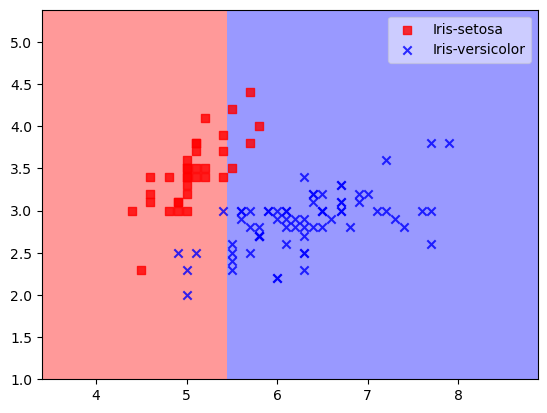

In [39]:
#Lets plot the decision surface
print (" Plotting the Decision Surface of Training Set... ")
t.plot_decision_regions(Xtrain[:,feat],Ytrain,clf=dt, res=0.02, cycle_marker=True, legend=1)

 Plotting the Decision Surface of Test Set... 
Prediction for single example:  [3.3 1.2]
Going to the left
Prediction for single example:  [3.3 1.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.32 1.2 ]
Going to the left
Prediction for single example:  [3.32 1.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.34 1.2 ]
Going to the left
Prediction for single example:  [3.34 1.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.36 1.2 ]
Going to the left
Prediction for single example:  [3.36 1.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.38 1.2 ]
Going to the left
Prediction for single example:  [3.38 1.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.4 1.2]
Going to the left
Prediction for single example:  [3.4 1.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.42 1.2 ]
Going to the left
Prediction for single example:  [3.42 1.2 ]
i am leaf

i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7  1.22]
Going to the right
Prediction for single example:  [6.7  1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.72 1.22]
Going to the right
Prediction for single example:  [6.72 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.74 1.22]
Going to the right
Prediction for single example:  [6.74 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.76 1.22]
Going to the right
Prediction for single example:  [6.76 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.78 1.22]
Going to the right
Prediction for single example:  [6.78 1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8  1.22]
Going to the right
Prediction for single example:  [6.8  1.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 1.22]
Going to the right
Prediction for single 

Prediction for single example:  [5.22 1.24]
Going to the left
Prediction for single example:  [5.22 1.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 1.24]
Going to the left
Prediction for single example:  [5.24 1.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 1.24]
Going to the left
Prediction for single example:  [5.26 1.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 1.24]
Going to the left
Prediction for single example:  [5.28 1.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3  1.24]
Going to the left
Prediction for single example:  [5.3  1.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.32 1.24]
Going to the left
Prediction for single example:  [5.32 1.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.34 1.24]
Going to the left
Prediction for single example:  [5.34 1.24]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.02 1.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.04 1.28]
Going to the right
Prediction for single example:  [6.04 1.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.06 1.28]
Going to the right
Prediction for single example:  [6.06 1.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.08 1.28]
Going to the right
Prediction for single example:  [6.08 1.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1  1.28]
Going to the right
Prediction for single example:  [6.1  1.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.12 1.28]
Going to the right
Prediction for single example:  [6.12 1.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 1.28]
Going to the right
Prediction for single example:  [6.14 1.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 1.2

Prediction for single example:  [3.88 1.32]
Going to the left
Prediction for single example:  [3.88 1.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.9  1.32]
Going to the left
Prediction for single example:  [3.9  1.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.92 1.32]
Going to the left
Prediction for single example:  [3.92 1.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.94 1.32]
Going to the left
Prediction for single example:  [3.94 1.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.96 1.32]
Going to the left
Prediction for single example:  [3.96 1.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.98 1.32]
Going to the left
Prediction for single example:  [3.98 1.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.   1.32]
Going to the left
Prediction for single example:  [4.   1.32]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [5.44 1.34]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.46 1.34]
Going to the right
Prediction for single example:  [5.46 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 1.34]
Going to the right
Prediction for single example:  [5.48 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  1.34]
Going to the right
Prediction for single example:  [5.5  1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 1.34]
Going to the right
Prediction for single example:  [5.52 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 1.34]
Going to the right
Prediction for single example:  [5.54 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 1.34]
Going to the right
Prediction for single example:  [5.56 1.34]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 1.34]
G

Prediction for single example:  [3.3  1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.32 1.38]
Going to the left
Prediction for single example:  [3.32 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.34 1.38]
Going to the left
Prediction for single example:  [3.34 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.36 1.38]
Going to the left
Prediction for single example:  [3.36 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.38 1.38]
Going to the left
Prediction for single example:  [3.38 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.4  1.38]
Going to the left
Prediction for single example:  [3.4  1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.42 1.38]
Going to the left
Prediction for single example:  [3.42 1.38]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.44 1.38]
Going to the left
Prediction fo

Prediction for single example:  [6.24 1.42]
Going to the right
Prediction for single example:  [6.24 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 1.42]
Going to the right
Prediction for single example:  [6.26 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.28 1.42]
Going to the right
Prediction for single example:  [6.28 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3  1.42]
Going to the right
Prediction for single example:  [6.3  1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 1.42]
Going to the right
Prediction for single example:  [6.32 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 1.42]
Going to the right
Prediction for single example:  [6.34 1.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 1.42]
Going to the right
Prediction for single example:  [6.36 1.42]
i am leaf label c

Prediction for single example:  [6.08 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1  1.46]
Going to the right
Prediction for single example:  [6.1  1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.12 1.46]
Going to the right
Prediction for single example:  [6.12 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 1.46]
Going to the right
Prediction for single example:  [6.14 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 1.46]
Going to the right
Prediction for single example:  [6.16 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.18 1.46]
Going to the right
Prediction for single example:  [6.18 1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2  1.46]
Going to the right
Prediction for single example:  [6.2  1.46]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 1.4

Prediction for single example:  [5.52 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 1.5 ]
Going to the right
Prediction for single example:  [5.54 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 1.5 ]
Going to the right
Prediction for single example:  [5.56 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 1.5 ]
Going to the right
Prediction for single example:  [5.58 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 1.5]
Going to the right
Prediction for single example:  [5.6 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.62 1.5 ]
Going to the right
Prediction for single example:  [5.62 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.64 1.5 ]
Going to the right
Prediction for single example:  [5.64 1.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.66 1.5 ]
G

Prediction for single example:  [4.16 1.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.18 1.54]
Going to the left
Prediction for single example:  [4.18 1.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.2  1.54]
Going to the left
Prediction for single example:  [4.2  1.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.22 1.54]
Going to the left
Prediction for single example:  [4.22 1.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.24 1.54]
Going to the left
Prediction for single example:  [4.24 1.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.26 1.54]
Going to the left
Prediction for single example:  [4.26 1.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.28 1.54]
Going to the left
Prediction for single example:  [4.28 1.54]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.3  1.54]
Going to the left
Prediction fo

Prediction for single example:  [8.   1.56]
Going to the right
Prediction for single example:  [8.   1.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 1.56]
Going to the right
Prediction for single example:  [8.02 1.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.04 1.56]
Going to the right
Prediction for single example:  [8.04 1.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.06 1.56]
Going to the right
Prediction for single example:  [8.06 1.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.08 1.56]
Going to the right
Prediction for single example:  [8.08 1.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1  1.56]
Going to the right
Prediction for single example:  [8.1  1.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.12 1.56]
Going to the right
Prediction for single example:  [8.12 1.56]
i am leaf label c

Prediction for single example:  [3.86 1.6 ]
Going to the left
Prediction for single example:  [3.86 1.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.88 1.6 ]
Going to the left
Prediction for single example:  [3.88 1.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.9 1.6]
Going to the left
Prediction for single example:  [3.9 1.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.92 1.6 ]
Going to the left
Prediction for single example:  [3.92 1.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.94 1.6 ]
Going to the left
Prediction for single example:  [3.94 1.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.96 1.6 ]
Going to the left
Prediction for single example:  [3.96 1.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.98 1.6 ]
Going to the left
Prediction for single example:  [3.98 1.6 ]
i am leaf label class: Iris-setosa
Prediction for si

Prediction for single example:  [3.7  1.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 1.64]
Going to the left
Prediction for single example:  [3.72 1.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 1.64]
Going to the left
Prediction for single example:  [3.74 1.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 1.64]
Going to the left
Prediction for single example:  [3.76 1.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 1.64]
Going to the left
Prediction for single example:  [3.78 1.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.8  1.64]
Going to the left
Prediction for single example:  [3.8  1.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 1.64]
Going to the left
Prediction for single example:  [3.82 1.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 1.64]
Going to the left
Prediction fo

Prediction for single example:  [7.22 1.66]
Going to the right
Prediction for single example:  [7.22 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.24 1.66]
Going to the right
Prediction for single example:  [7.24 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.26 1.66]
Going to the right
Prediction for single example:  [7.26 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.28 1.66]
Going to the right
Prediction for single example:  [7.28 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.3  1.66]
Going to the right
Prediction for single example:  [7.3  1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.32 1.66]
Going to the right
Prediction for single example:  [7.32 1.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.34 1.66]
Going to the right
Prediction for single example:  [7.34 1.66]
i am leaf label c

Prediction for single example:  [5.08 1.7 ]
Going to the left
Prediction for single example:  [5.08 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.1 1.7]
Going to the left
Prediction for single example:  [5.1 1.7]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.12 1.7 ]
Going to the left
Prediction for single example:  [5.12 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.14 1.7 ]
Going to the left
Prediction for single example:  [5.14 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.16 1.7 ]
Going to the left
Prediction for single example:  [5.16 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 1.7 ]
Going to the left
Prediction for single example:  [5.18 1.7 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 1.7]
Going to the left
Prediction for single example:  [5.2 1.7]
i am leaf label class: Iris-setosa
Prediction for single

Prediction for single example:  [5.2  1.72]
Going to the left
Prediction for single example:  [5.2  1.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 1.72]
Going to the left
Prediction for single example:  [5.22 1.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 1.72]
Going to the left
Prediction for single example:  [5.24 1.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 1.72]
Going to the left
Prediction for single example:  [5.26 1.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 1.72]
Going to the left
Prediction for single example:  [5.28 1.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3  1.72]
Going to the left
Prediction for single example:  [5.3  1.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.32 1.72]
Going to the left
Prediction for single example:  [5.32 1.72]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [5.12 1.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.14 1.74]
Going to the left
Prediction for single example:  [5.14 1.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.16 1.74]
Going to the left
Prediction for single example:  [5.16 1.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 1.74]
Going to the left
Prediction for single example:  [5.18 1.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2  1.74]
Going to the left
Prediction for single example:  [5.2  1.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 1.74]
Going to the left
Prediction for single example:  [5.22 1.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 1.74]
Going to the left
Prediction for single example:  [5.24 1.74]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 1.74]
Going to the left
Prediction fo

Prediction for single example:  [6.84 1.76]
Going to the right
Prediction for single example:  [6.84 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.86 1.76]
Going to the right
Prediction for single example:  [6.86 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.88 1.76]
Going to the right
Prediction for single example:  [6.88 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9  1.76]
Going to the right
Prediction for single example:  [6.9  1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.92 1.76]
Going to the right
Prediction for single example:  [6.92 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.94 1.76]
Going to the right
Prediction for single example:  [6.94 1.76]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.96 1.76]
Going to the right
Prediction for single example:  [6.96 1.76]
i am leaf label c

Prediction for single example:  [6.4  1.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 1.78]
Going to the right
Prediction for single example:  [6.42 1.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 1.78]
Going to the right
Prediction for single example:  [6.44 1.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 1.78]
Going to the right
Prediction for single example:  [6.46 1.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 1.78]
Going to the right
Prediction for single example:  [6.48 1.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5  1.78]
Going to the right
Prediction for single example:  [6.5  1.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.52 1.78]
Going to the right
Prediction for single example:  [6.52 1.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.54 1.7

Prediction for single example:  [6.32 1.8 ]
Going to the right
Prediction for single example:  [6.32 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 1.8 ]
Going to the right
Prediction for single example:  [6.34 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 1.8 ]
Going to the right
Prediction for single example:  [6.36 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 1.8 ]
Going to the right
Prediction for single example:  [6.38 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 1.8]
Going to the right
Prediction for single example:  [6.4 1.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 1.8 ]
Going to the right
Prediction for single example:  [6.42 1.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 1.8 ]
Going to the right
Prediction for single example:  [6.44 1.8 ]
i am leaf label class

Prediction for single example:  [8.64 1.82]
Going to the right
Prediction for single example:  [8.64 1.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.66 1.82]
Going to the right
Prediction for single example:  [8.66 1.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.68 1.82]
Going to the right
Prediction for single example:  [8.68 1.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.3  1.84]
Going to the left
Prediction for single example:  [3.3  1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.32 1.84]
Going to the left
Prediction for single example:  [3.32 1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.34 1.84]
Going to the left
Prediction for single example:  [3.34 1.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.36 1.84]
Going to the left
Prediction for single example:  [3.36 1.84]
i am leaf label class: Iris-setos

Prediction for single example:  [4.3  1.86]
Going to the left
Prediction for single example:  [4.3  1.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.32 1.86]
Going to the left
Prediction for single example:  [4.32 1.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.34 1.86]
Going to the left
Prediction for single example:  [4.34 1.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.36 1.86]
Going to the left
Prediction for single example:  [4.36 1.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.38 1.86]
Going to the left
Prediction for single example:  [4.38 1.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4  1.86]
Going to the left
Prediction for single example:  [4.4  1.86]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.42 1.86]
Going to the left
Prediction for single example:  [4.42 1.86]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [3.54 1.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.56 1.88]
Going to the left
Prediction for single example:  [3.56 1.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.58 1.88]
Going to the left
Prediction for single example:  [3.58 1.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.6  1.88]
Going to the left
Prediction for single example:  [3.6  1.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.62 1.88]
Going to the left
Prediction for single example:  [3.62 1.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.64 1.88]
Going to the left
Prediction for single example:  [3.64 1.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 1.88]
Going to the left
Prediction for single example:  [3.66 1.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 1.88]
Going to the left
Prediction fo

Prediction for single example:  [4.12 1.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.14 1.9 ]
Going to the left
Prediction for single example:  [4.14 1.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.16 1.9 ]
Going to the left
Prediction for single example:  [4.16 1.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.18 1.9 ]
Going to the left
Prediction for single example:  [4.18 1.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.2 1.9]
Going to the left
Prediction for single example:  [4.2 1.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.22 1.9 ]
Going to the left
Prediction for single example:  [4.22 1.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.24 1.9 ]
Going to the left
Prediction for single example:  [4.24 1.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.26 1.9 ]
Going to the left
Prediction for si

Prediction for single example:  [7.24 1.92]
Going to the right
Prediction for single example:  [7.24 1.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.26 1.92]
Going to the right
Prediction for single example:  [7.26 1.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.28 1.92]
Going to the right
Prediction for single example:  [7.28 1.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.3  1.92]
Going to the right
Prediction for single example:  [7.3  1.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.32 1.92]
Going to the right
Prediction for single example:  [7.32 1.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.34 1.92]
Going to the right
Prediction for single example:  [7.34 1.92]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.36 1.92]
Going to the right
Prediction for single example:  [7.36 1.92]
i am leaf label c

Prediction for single example:  [5.58 1.94]
Going to the right
Prediction for single example:  [5.58 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  1.94]
Going to the right
Prediction for single example:  [5.6  1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.62 1.94]
Going to the right
Prediction for single example:  [5.62 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.64 1.94]
Going to the right
Prediction for single example:  [5.64 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.66 1.94]
Going to the right
Prediction for single example:  [5.66 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.68 1.94]
Going to the right
Prediction for single example:  [5.68 1.94]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7  1.94]
Going to the right
Prediction for single example:  [5.7  1.94]
i am leaf label c

Prediction for single example:  [7.56 1.96]
Going to the right
Prediction for single example:  [7.56 1.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 1.96]
Going to the right
Prediction for single example:  [7.58 1.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  1.96]
Going to the right
Prediction for single example:  [7.6  1.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 1.96]
Going to the right
Prediction for single example:  [7.62 1.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 1.96]
Going to the right
Prediction for single example:  [7.64 1.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 1.96]
Going to the right
Prediction for single example:  [7.66 1.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 1.96]
Going to the right
Prediction for single example:  [7.68 1.96]
i am leaf label c

Prediction for single example:  [5.72 2.  ]
Going to the right
Prediction for single example:  [5.72 2.  ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.74 2.  ]
Going to the right
Prediction for single example:  [5.74 2.  ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 2.  ]
Going to the right
Prediction for single example:  [5.76 2.  ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 2.  ]
Going to the right
Prediction for single example:  [5.78 2.  ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2. ]
Going to the right
Prediction for single example:  [5.8 2. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.82 2.  ]
Going to the right
Prediction for single example:  [5.82 2.  ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.84 2.  ]
Going to the right
Prediction for single example:  [5.84 2.  ]
i am leaf label class

Prediction for single example:  [7.84 2.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.86 2.04]
Going to the right
Prediction for single example:  [7.86 2.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.88 2.04]
Going to the right
Prediction for single example:  [7.88 2.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.9  2.04]
Going to the right
Prediction for single example:  [7.9  2.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.92 2.04]
Going to the right
Prediction for single example:  [7.92 2.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 2.04]
Going to the right
Prediction for single example:  [7.94 2.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 2.04]
Going to the right
Prediction for single example:  [7.96 2.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 2.0

Prediction for single example:  [4.5  2.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.52 2.08]
Going to the left
Prediction for single example:  [4.52 2.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.54 2.08]
Going to the left
Prediction for single example:  [4.54 2.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.56 2.08]
Going to the left
Prediction for single example:  [4.56 2.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.58 2.08]
Going to the left
Prediction for single example:  [4.58 2.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.6  2.08]
Going to the left
Prediction for single example:  [4.6  2.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.62 2.08]
Going to the left
Prediction for single example:  [4.62 2.08]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.64 2.08]
Going to the left
Prediction fo

Prediction for single example:  [5.9 2.1]
Going to the right
Prediction for single example:  [5.9 2.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.92 2.1 ]
Going to the right
Prediction for single example:  [5.92 2.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.94 2.1 ]
Going to the right
Prediction for single example:  [5.94 2.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.96 2.1 ]
Going to the right
Prediction for single example:  [5.96 2.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.98 2.1 ]
Going to the right
Prediction for single example:  [5.98 2.1 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.1]
Going to the right
Prediction for single example:  [6.  2.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.02 2.1 ]
Going to the right
Prediction for single example:  [6.02 2.1 ]
i am leaf label class: Ir

Prediction for single example:  [7.54 2.12]
Going to the right
Prediction for single example:  [7.54 2.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.56 2.12]
Going to the right
Prediction for single example:  [7.56 2.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 2.12]
Going to the right
Prediction for single example:  [7.58 2.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  2.12]
Going to the right
Prediction for single example:  [7.6  2.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 2.12]
Going to the right
Prediction for single example:  [7.62 2.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 2.12]
Going to the right
Prediction for single example:  [7.64 2.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 2.12]
Going to the right
Prediction for single example:  [7.66 2.12]
i am leaf label c

Prediction for single example:  [4.04 2.16]
Going to the left
Prediction for single example:  [4.04 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.06 2.16]
Going to the left
Prediction for single example:  [4.06 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.08 2.16]
Going to the left
Prediction for single example:  [4.08 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.1  2.16]
Going to the left
Prediction for single example:  [4.1  2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.12 2.16]
Going to the left
Prediction for single example:  [4.12 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.14 2.16]
Going to the left
Prediction for single example:  [4.14 2.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.16 2.16]
Going to the left
Prediction for single example:  [4.16 2.16]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [7.94 2.18]
Going to the right
Prediction for single example:  [7.94 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 2.18]
Going to the right
Prediction for single example:  [7.96 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 2.18]
Going to the right
Prediction for single example:  [7.98 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.   2.18]
Going to the right
Prediction for single example:  [8.   2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 2.18]
Going to the right
Prediction for single example:  [8.02 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.04 2.18]
Going to the right
Prediction for single example:  [8.04 2.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.06 2.18]
Going to the right
Prediction for single example:  [8.06 2.18]
i am leaf label c

Prediction for single example:  [6.42 2.2 ]
Going to the right
Prediction for single example:  [6.42 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 2.2 ]
Going to the right
Prediction for single example:  [6.44 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 2.2 ]
Going to the right
Prediction for single example:  [6.46 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 2.2 ]
Going to the right
Prediction for single example:  [6.48 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.2]
Going to the right
Prediction for single example:  [6.5 2.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.52 2.2 ]
Going to the right
Prediction for single example:  [6.52 2.2 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.54 2.2 ]
Going to the right
Prediction for single example:  [6.54 2.2 ]
i am leaf label class

Going to the right
Prediction for single example:  [6.6  2.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.62 2.24]
Going to the right
Prediction for single example:  [6.62 2.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.64 2.24]
Going to the right
Prediction for single example:  [6.64 2.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.66 2.24]
Going to the right
Prediction for single example:  [6.66 2.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.68 2.24]
Going to the right
Prediction for single example:  [6.68 2.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7  2.24]
Going to the right
Prediction for single example:  [6.7  2.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.72 2.24]
Going to the right
Prediction for single example:  [6.72 2.24]
i am leaf label class: Iris-versicolor
Prediction for single 

Prediction for single example:  [7.68 2.26]
Going to the right
Prediction for single example:  [7.68 2.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7  2.26]
Going to the right
Prediction for single example:  [7.7  2.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.72 2.26]
Going to the right
Prediction for single example:  [7.72 2.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.74 2.26]
Going to the right
Prediction for single example:  [7.74 2.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.76 2.26]
Going to the right
Prediction for single example:  [7.76 2.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.78 2.26]
Going to the right
Prediction for single example:  [7.78 2.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.8  2.26]
Going to the right
Prediction for single example:  [7.8  2.26]
i am leaf label c

Going to the left
Prediction for single example:  [4.88 2.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 2.3]
Going to the left
Prediction for single example:  [4.9 2.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.92 2.3 ]
Going to the left
Prediction for single example:  [4.92 2.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 2.3 ]
Going to the left
Prediction for single example:  [4.94 2.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 2.3 ]
Going to the left
Prediction for single example:  [4.96 2.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 2.3 ]
Going to the left
Prediction for single example:  [4.98 2.3 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  2.3]
Going to the left
Prediction for single example:  [5.  2.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 2.3 ]
Going to the left
Pre

Prediction for single example:  [3.74 2.32]
Going to the left
Prediction for single example:  [3.74 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 2.32]
Going to the left
Prediction for single example:  [3.76 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 2.32]
Going to the left
Prediction for single example:  [3.78 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.8  2.32]
Going to the left
Prediction for single example:  [3.8  2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 2.32]
Going to the left
Prediction for single example:  [3.82 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 2.32]
Going to the left
Prediction for single example:  [3.84 2.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 2.32]
Going to the left
Prediction for single example:  [3.86 2.32]
i am leaf label class: Iris-setosa
Prediction fo

i am leaf label class: Iris-setosa
Prediction for single example:  [5.4  2.36]
Going to the left
Prediction for single example:  [5.4  2.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.42 2.36]
Going to the left
Prediction for single example:  [5.42 2.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.44 2.36]
Going to the left
Prediction for single example:  [5.44 2.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.46 2.36]
Going to the right
Prediction for single example:  [5.46 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 2.36]
Going to the right
Prediction for single example:  [5.48 2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  2.36]
Going to the right
Prediction for single example:  [5.5  2.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 2.36]
Going to the right
Prediction for single example:  [5.52 2.3

Prediction for single example:  [6.4  2.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 2.38]
Going to the right
Prediction for single example:  [6.42 2.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 2.38]
Going to the right
Prediction for single example:  [6.44 2.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 2.38]
Going to the right
Prediction for single example:  [6.46 2.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 2.38]
Going to the right
Prediction for single example:  [6.48 2.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5  2.38]
Going to the right
Prediction for single example:  [6.5  2.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.52 2.38]
Going to the right
Prediction for single example:  [6.52 2.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.54 2.3

Prediction for single example:  [7.64 2.4 ]
Going to the right
Prediction for single example:  [7.64 2.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 2.4 ]
Going to the right
Prediction for single example:  [7.66 2.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 2.4 ]
Going to the right
Prediction for single example:  [7.68 2.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 2.4]
Going to the right
Prediction for single example:  [7.7 2.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.72 2.4 ]
Going to the right
Prediction for single example:  [7.72 2.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.74 2.4 ]
Going to the right
Prediction for single example:  [7.74 2.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.76 2.4 ]
Going to the right
Prediction for single example:  [7.76 2.4 ]
i am leaf label class

Prediction for single example:  [5.44 2.44]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.46 2.44]
Going to the right
Prediction for single example:  [5.46 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 2.44]
Going to the right
Prediction for single example:  [5.48 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  2.44]
Going to the right
Prediction for single example:  [5.5  2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 2.44]
Going to the right
Prediction for single example:  [5.52 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 2.44]
Going to the right
Prediction for single example:  [5.54 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 2.44]
Going to the right
Prediction for single example:  [5.56 2.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 2.44]
G

Prediction for single example:  [5.42 2.48]
Going to the left
Prediction for single example:  [5.42 2.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.44 2.48]
Going to the left
Prediction for single example:  [5.44 2.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.46 2.48]
Going to the right
Prediction for single example:  [5.46 2.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 2.48]
Going to the right
Prediction for single example:  [5.48 2.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  2.48]
Going to the right
Prediction for single example:  [5.5  2.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 2.48]
Going to the right
Prediction for single example:  [5.52 2.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 2.48]
Going to the right
Prediction for single example:  [5.54 2.48]
i am leaf label class: Iris

Prediction for single example:  [6.26 2.5 ]
Going to the right
Prediction for single example:  [6.26 2.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.28 2.5 ]
Going to the right
Prediction for single example:  [6.28 2.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.5]
Going to the right
Prediction for single example:  [6.3 2.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 2.5 ]
Going to the right
Prediction for single example:  [6.32 2.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 2.5 ]
Going to the right
Prediction for single example:  [6.34 2.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 2.5 ]
Going to the right
Prediction for single example:  [6.36 2.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 2.5 ]
Going to the right
Prediction for single example:  [6.38 2.5 ]
i am leaf label class

Prediction for single example:  [6.18 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2  2.54]
Going to the right
Prediction for single example:  [6.2  2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 2.54]
Going to the right
Prediction for single example:  [6.22 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.24 2.54]
Going to the right
Prediction for single example:  [6.24 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 2.54]
Going to the right
Prediction for single example:  [6.26 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.28 2.54]
Going to the right
Prediction for single example:  [6.28 2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3  2.54]
Going to the right
Prediction for single example:  [6.3  2.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 2.5

Prediction for single example:  [6.98 2.58]
Going to the right
Prediction for single example:  [6.98 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.   2.58]
Going to the right
Prediction for single example:  [7.   2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.02 2.58]
Going to the right
Prediction for single example:  [7.02 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.04 2.58]
Going to the right
Prediction for single example:  [7.04 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.06 2.58]
Going to the right
Prediction for single example:  [7.06 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.08 2.58]
Going to the right
Prediction for single example:  [7.08 2.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1  2.58]
Going to the right
Prediction for single example:  [7.1  2.58]
i am leaf label c

Prediction for single example:  [7.18 2.62]
Going to the right
Prediction for single example:  [7.18 2.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2  2.62]
Going to the right
Prediction for single example:  [7.2  2.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.22 2.62]
Going to the right
Prediction for single example:  [7.22 2.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.24 2.62]
Going to the right
Prediction for single example:  [7.24 2.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.26 2.62]
Going to the right
Prediction for single example:  [7.26 2.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.28 2.62]
Going to the right
Prediction for single example:  [7.28 2.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.3  2.62]
Going to the right
Prediction for single example:  [7.3  2.62]
i am leaf label c

Prediction for single example:  [5.22 2.68]
Going to the left
Prediction for single example:  [5.22 2.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 2.68]
Going to the left
Prediction for single example:  [5.24 2.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 2.68]
Going to the left
Prediction for single example:  [5.26 2.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 2.68]
Going to the left
Prediction for single example:  [5.28 2.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3  2.68]
Going to the left
Prediction for single example:  [5.3  2.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.32 2.68]
Going to the left
Prediction for single example:  [5.32 2.68]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.34 2.68]
Going to the left
Prediction for single example:  [5.34 2.68]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.04 2.7 ]
Going to the right
Prediction for single example:  [6.04 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.06 2.7 ]
Going to the right
Prediction for single example:  [6.06 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.08 2.7 ]
Going to the right
Prediction for single example:  [6.08 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.7]
Going to the right
Prediction for single example:  [6.1 2.7]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.12 2.7 ]
Going to the right
Prediction for single example:  [6.12 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 2.7 ]
Going to the right
Prediction for single example:  [6.14 2.7 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 2.7 ]
Going to the right
Prediction for single example:  [6.16 2.7 ]
i am leaf label class

Prediction for single example:  [8.32 2.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.34 2.72]
Going to the right
Prediction for single example:  [8.34 2.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.36 2.72]
Going to the right
Prediction for single example:  [8.36 2.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.38 2.72]
Going to the right
Prediction for single example:  [8.38 2.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.4  2.72]
Going to the right
Prediction for single example:  [8.4  2.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.42 2.72]
Going to the right
Prediction for single example:  [8.42 2.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.44 2.72]
Going to the right
Prediction for single example:  [8.44 2.72]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.46 2.7

Prediction for single example:  [3.44 2.78]
Going to the left
Prediction for single example:  [3.44 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.46 2.78]
Going to the left
Prediction for single example:  [3.46 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.48 2.78]
Going to the left
Prediction for single example:  [3.48 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.5  2.78]
Going to the left
Prediction for single example:  [3.5  2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.52 2.78]
Going to the left
Prediction for single example:  [3.52 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.54 2.78]
Going to the left
Prediction for single example:  [3.54 2.78]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.56 2.78]
Going to the left
Prediction for single example:  [3.56 2.78]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.12 2.8 ]
Going to the right
Prediction for single example:  [8.12 2.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 2.8 ]
Going to the right
Prediction for single example:  [8.14 2.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 2.8 ]
Going to the right
Prediction for single example:  [8.16 2.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 2.8 ]
Going to the right
Prediction for single example:  [8.18 2.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2 2.8]
Going to the right
Prediction for single example:  [8.2 2.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 2.8 ]
Going to the right
Prediction for single example:  [8.22 2.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 2.8 ]
Going to the right
Prediction for single example:  [8.24 2.8 ]
i am leaf label class

Prediction for single example:  [4.92 2.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 2.84]
Going to the left
Prediction for single example:  [4.94 2.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 2.84]
Going to the left
Prediction for single example:  [4.96 2.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 2.84]
Going to the left
Prediction for single example:  [4.98 2.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   2.84]
Going to the left
Prediction for single example:  [5.   2.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 2.84]
Going to the left
Prediction for single example:  [5.02 2.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.04 2.84]
Going to the left
Prediction for single example:  [5.04 2.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.06 2.84]
Going to the left
Prediction fo

Prediction for single example:  [8.06 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.08 2.86]
Going to the right
Prediction for single example:  [8.08 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1  2.86]
Going to the right
Prediction for single example:  [8.1  2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.12 2.86]
Going to the right
Prediction for single example:  [8.12 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 2.86]
Going to the right
Prediction for single example:  [8.14 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 2.86]
Going to the right
Prediction for single example:  [8.16 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 2.86]
Going to the right
Prediction for single example:  [8.18 2.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2  2.8

Prediction for single example:  [4.1  2.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.12 2.94]
Going to the left
Prediction for single example:  [4.12 2.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.14 2.94]
Going to the left
Prediction for single example:  [4.14 2.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.16 2.94]
Going to the left
Prediction for single example:  [4.16 2.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.18 2.94]
Going to the left
Prediction for single example:  [4.18 2.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.2  2.94]
Going to the left
Prediction for single example:  [4.2  2.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.22 2.94]
Going to the left
Prediction for single example:  [4.22 2.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.24 2.94]
Going to the left
Prediction fo

Prediction for single example:  [7.26 2.96]
Going to the right
Prediction for single example:  [7.26 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.28 2.96]
Going to the right
Prediction for single example:  [7.28 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.3  2.96]
Going to the right
Prediction for single example:  [7.3  2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.32 2.96]
Going to the right
Prediction for single example:  [7.32 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.34 2.96]
Going to the right
Prediction for single example:  [7.34 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.36 2.96]
Going to the right
Prediction for single example:  [7.36 2.96]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.38 2.96]
Going to the right
Prediction for single example:  [7.38 2.96]
i am leaf label c

Prediction for single example:  [4.04 3.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.06 3.  ]
Going to the left
Prediction for single example:  [4.06 3.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.08 3.  ]
Going to the left
Prediction for single example:  [4.08 3.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.1 3. ]
Going to the left
Prediction for single example:  [4.1 3. ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.12 3.  ]
Going to the left
Prediction for single example:  [4.12 3.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.14 3.  ]
Going to the left
Prediction for single example:  [4.14 3.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.16 3.  ]
Going to the left
Prediction for single example:  [4.16 3.  ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.18 3.  ]
Going to the left
Prediction for si

Prediction for single example:  [5.56 3.04]
Going to the right
Prediction for single example:  [5.56 3.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 3.04]
Going to the right
Prediction for single example:  [5.58 3.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  3.04]
Going to the right
Prediction for single example:  [5.6  3.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.62 3.04]
Going to the right
Prediction for single example:  [5.62 3.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.64 3.04]
Going to the right
Prediction for single example:  [5.64 3.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.66 3.04]
Going to the right
Prediction for single example:  [5.66 3.04]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.68 3.04]
Going to the right
Prediction for single example:  [5.68 3.04]
i am leaf label c

Prediction for single example:  [7.52 3.06]
Going to the right
Prediction for single example:  [7.52 3.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.54 3.06]
Going to the right
Prediction for single example:  [7.54 3.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.56 3.06]
Going to the right
Prediction for single example:  [7.56 3.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 3.06]
Going to the right
Prediction for single example:  [7.58 3.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  3.06]
Going to the right
Prediction for single example:  [7.6  3.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 3.06]
Going to the right
Prediction for single example:  [7.62 3.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 3.06]
Going to the right
Prediction for single example:  [7.64 3.06]
i am leaf label c

Prediction for single example:  [5.24 3.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 3.1 ]
Going to the left
Prediction for single example:  [5.26 3.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 3.1 ]
Going to the left
Prediction for single example:  [5.28 3.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 3.1]
Going to the left
Prediction for single example:  [5.3 3.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.32 3.1 ]
Going to the left
Prediction for single example:  [5.32 3.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.34 3.1 ]
Going to the left
Prediction for single example:  [5.34 3.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.36 3.1 ]
Going to the left
Prediction for single example:  [5.36 3.1 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.38 3.1 ]
Going to the left
Prediction for si

i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 3.12]
Going to the right
Prediction for single example:  [5.76 3.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 3.12]
Going to the right
Prediction for single example:  [5.78 3.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8  3.12]
Going to the right
Prediction for single example:  [5.8  3.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.82 3.12]
Going to the right
Prediction for single example:  [5.82 3.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.84 3.12]
Going to the right
Prediction for single example:  [5.84 3.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.86 3.12]
Going to the right
Prediction for single example:  [5.86 3.12]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.88 3.12]
Going to the right
Prediction for single 

Prediction for single example:  [3.44 3.16]
Going to the left
Prediction for single example:  [3.44 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.46 3.16]
Going to the left
Prediction for single example:  [3.46 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.48 3.16]
Going to the left
Prediction for single example:  [3.48 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.5  3.16]
Going to the left
Prediction for single example:  [3.5  3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.52 3.16]
Going to the left
Prediction for single example:  [3.52 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.54 3.16]
Going to the left
Prediction for single example:  [3.54 3.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.56 3.16]
Going to the left
Prediction for single example:  [3.56 3.16]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.02 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.04 3.18]
Going to the right
Prediction for single example:  [6.04 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.06 3.18]
Going to the right
Prediction for single example:  [6.06 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.08 3.18]
Going to the right
Prediction for single example:  [6.08 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1  3.18]
Going to the right
Prediction for single example:  [6.1  3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.12 3.18]
Going to the right
Prediction for single example:  [6.12 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.14 3.18]
Going to the right
Prediction for single example:  [6.14 3.18]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.16 3.1

Prediction for single example:  [4.7 3.2]
Going to the left
Prediction for single example:  [4.7 3.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.72 3.2 ]
Going to the left
Prediction for single example:  [4.72 3.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.74 3.2 ]
Going to the left
Prediction for single example:  [4.74 3.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.76 3.2 ]
Going to the left
Prediction for single example:  [4.76 3.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.78 3.2 ]
Going to the left
Prediction for single example:  [4.78 3.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8 3.2]
Going to the left
Prediction for single example:  [4.8 3.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.82 3.2 ]
Going to the left
Prediction for single example:  [4.82 3.2 ]
i am leaf label class: Iris-setosa
Prediction for single

Prediction for single example:  [5.74 3.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 3.22]
Going to the right
Prediction for single example:  [5.76 3.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 3.22]
Going to the right
Prediction for single example:  [5.78 3.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8  3.22]
Going to the right
Prediction for single example:  [5.8  3.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.82 3.22]
Going to the right
Prediction for single example:  [5.82 3.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.84 3.22]
Going to the right
Prediction for single example:  [5.84 3.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.86 3.22]
Going to the right
Prediction for single example:  [5.86 3.22]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.88 3.2

Prediction for single example:  [6.7  3.24]
Going to the right
Prediction for single example:  [6.7  3.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.72 3.24]
Going to the right
Prediction for single example:  [6.72 3.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.74 3.24]
Going to the right
Prediction for single example:  [6.74 3.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.76 3.24]
Going to the right
Prediction for single example:  [6.76 3.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.78 3.24]
Going to the right
Prediction for single example:  [6.78 3.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8  3.24]
Going to the right
Prediction for single example:  [6.8  3.24]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 3.24]
Going to the right
Prediction for single example:  [6.82 3.24]
i am leaf label c

Prediction for single example:  [7.02 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.04 3.28]
Going to the right
Prediction for single example:  [7.04 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.06 3.28]
Going to the right
Prediction for single example:  [7.06 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.08 3.28]
Going to the right
Prediction for single example:  [7.08 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1  3.28]
Going to the right
Prediction for single example:  [7.1  3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.12 3.28]
Going to the right
Prediction for single example:  [7.12 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.14 3.28]
Going to the right
Prediction for single example:  [7.14 3.28]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.16 3.2

Prediction for single example:  [4.3  3.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.32 3.32]
Going to the left
Prediction for single example:  [4.32 3.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.34 3.32]
Going to the left
Prediction for single example:  [4.34 3.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.36 3.32]
Going to the left
Prediction for single example:  [4.36 3.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.38 3.32]
Going to the left
Prediction for single example:  [4.38 3.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4  3.32]
Going to the left
Prediction for single example:  [4.4  3.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.42 3.32]
Going to the left
Prediction for single example:  [4.42 3.32]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.44 3.32]
Going to the left
Prediction fo

Prediction for single example:  [6.58 3.36]
Going to the right
Prediction for single example:  [6.58 3.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6  3.36]
Going to the right
Prediction for single example:  [6.6  3.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.62 3.36]
Going to the right
Prediction for single example:  [6.62 3.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.64 3.36]
Going to the right
Prediction for single example:  [6.64 3.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.66 3.36]
Going to the right
Prediction for single example:  [6.66 3.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.68 3.36]
Going to the right
Prediction for single example:  [6.68 3.36]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7  3.36]
Going to the right
Prediction for single example:  [6.7  3.36]
i am leaf label c

Prediction for single example:  [5.74 3.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 3.4 ]
Going to the right
Prediction for single example:  [5.76 3.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 3.4 ]
Going to the right
Prediction for single example:  [5.78 3.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 3.4]
Going to the right
Prediction for single example:  [5.8 3.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.82 3.4 ]
Going to the right
Prediction for single example:  [5.82 3.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.84 3.4 ]
Going to the right
Prediction for single example:  [5.84 3.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.86 3.4 ]
Going to the right
Prediction for single example:  [5.86 3.4 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.88 3.4 ]
G

Prediction for single example:  [6.98 3.44]
Going to the right
Prediction for single example:  [6.98 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.   3.44]
Going to the right
Prediction for single example:  [7.   3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.02 3.44]
Going to the right
Prediction for single example:  [7.02 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.04 3.44]
Going to the right
Prediction for single example:  [7.04 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.06 3.44]
Going to the right
Prediction for single example:  [7.06 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.08 3.44]
Going to the right
Prediction for single example:  [7.08 3.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1  3.44]
Going to the right
Prediction for single example:  [7.1  3.44]
i am leaf label c

Prediction for single example:  [5.5  3.48]
Going to the right
Prediction for single example:  [5.5  3.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 3.48]
Going to the right
Prediction for single example:  [5.52 3.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 3.48]
Going to the right
Prediction for single example:  [5.54 3.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 3.48]
Going to the right
Prediction for single example:  [5.56 3.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 3.48]
Going to the right
Prediction for single example:  [5.58 3.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  3.48]
Going to the right
Prediction for single example:  [5.6  3.48]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.62 3.48]
Going to the right
Prediction for single example:  [5.62 3.48]
i am leaf label c

Prediction for single example:  [4.84 3.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.86 3.52]
Going to the left
Prediction for single example:  [4.86 3.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.88 3.52]
Going to the left
Prediction for single example:  [4.88 3.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9  3.52]
Going to the left
Prediction for single example:  [4.9  3.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.92 3.52]
Going to the left
Prediction for single example:  [4.92 3.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 3.52]
Going to the left
Prediction for single example:  [4.94 3.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 3.52]
Going to the left
Prediction for single example:  [4.96 3.52]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 3.52]
Going to the left
Prediction fo

Prediction for single example:  [4.92 3.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 3.56]
Going to the left
Prediction for single example:  [4.94 3.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 3.56]
Going to the left
Prediction for single example:  [4.96 3.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 3.56]
Going to the left
Prediction for single example:  [4.98 3.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   3.56]
Going to the left
Prediction for single example:  [5.   3.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 3.56]
Going to the left
Prediction for single example:  [5.02 3.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.04 3.56]
Going to the left
Prediction for single example:  [5.04 3.56]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.06 3.56]
Going to the left
Prediction fo

Prediction for single example:  [5.16 3.6 ]
Going to the left
Prediction for single example:  [5.16 3.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.18 3.6 ]
Going to the left
Prediction for single example:  [5.18 3.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 3.6]
Going to the left
Prediction for single example:  [5.2 3.6]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.22 3.6 ]
Going to the left
Prediction for single example:  [5.22 3.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.24 3.6 ]
Going to the left
Prediction for single example:  [5.24 3.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 3.6 ]
Going to the left
Prediction for single example:  [5.26 3.6 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 3.6 ]
Going to the left
Prediction for single example:  [5.28 3.6 ]
i am leaf label class: Iris-setosa
Prediction for si

Prediction for single example:  [3.74 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 3.64]
Going to the left
Prediction for single example:  [3.76 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 3.64]
Going to the left
Prediction for single example:  [3.78 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.8  3.64]
Going to the left
Prediction for single example:  [3.8  3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 3.64]
Going to the left
Prediction for single example:  [3.82 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 3.64]
Going to the left
Prediction for single example:  [3.84 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 3.64]
Going to the left
Prediction for single example:  [3.86 3.64]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.88 3.64]
Going to the left
Prediction fo

Prediction for single example:  [7.9  3.66]
Going to the right
Prediction for single example:  [7.9  3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.92 3.66]
Going to the right
Prediction for single example:  [7.92 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.94 3.66]
Going to the right
Prediction for single example:  [7.94 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.96 3.66]
Going to the right
Prediction for single example:  [7.96 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 3.66]
Going to the right
Prediction for single example:  [7.98 3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.   3.66]
Going to the right
Prediction for single example:  [8.   3.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 3.66]
Going to the right
Prediction for single example:  [8.02 3.66]
i am leaf label c

Prediction for single example:  [3.92 3.72]
Going to the left
Prediction for single example:  [3.92 3.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.94 3.72]
Going to the left
Prediction for single example:  [3.94 3.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.96 3.72]
Going to the left
Prediction for single example:  [3.96 3.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.98 3.72]
Going to the left
Prediction for single example:  [3.98 3.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.   3.72]
Going to the left
Prediction for single example:  [4.   3.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.02 3.72]
Going to the left
Prediction for single example:  [4.02 3.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.04 3.72]
Going to the left
Prediction for single example:  [4.04 3.72]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [3.8  3.76]
Going to the left
Prediction for single example:  [3.8  3.76]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 3.76]
Going to the left
Prediction for single example:  [3.82 3.76]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 3.76]
Going to the left
Prediction for single example:  [3.84 3.76]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 3.76]
Going to the left
Prediction for single example:  [3.86 3.76]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.88 3.76]
Going to the left
Prediction for single example:  [3.88 3.76]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.9  3.76]
Going to the left
Prediction for single example:  [3.9  3.76]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.92 3.76]
Going to the left
Prediction for single example:  [3.92 3.76]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.48 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.5  3.78]
Going to the right
Prediction for single example:  [8.5  3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.52 3.78]
Going to the right
Prediction for single example:  [8.52 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 3.78]
Going to the right
Prediction for single example:  [8.54 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.56 3.78]
Going to the right
Prediction for single example:  [8.56 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.58 3.78]
Going to the right
Prediction for single example:  [8.58 3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.6  3.78]
Going to the right
Prediction for single example:  [8.6  3.78]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.62 3.7

Prediction for single example:  [7.66 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 3.82]
Going to the right
Prediction for single example:  [7.68 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7  3.82]
Going to the right
Prediction for single example:  [7.7  3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.72 3.82]
Going to the right
Prediction for single example:  [7.72 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.74 3.82]
Going to the right
Prediction for single example:  [7.74 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.76 3.82]
Going to the right
Prediction for single example:  [7.76 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.78 3.82]
Going to the right
Prediction for single example:  [7.78 3.82]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.8  3.8

Prediction for single example:  [5.88 3.86]
Going to the right
Prediction for single example:  [5.88 3.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.9  3.86]
Going to the right
Prediction for single example:  [5.9  3.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.92 3.86]
Going to the right
Prediction for single example:  [5.92 3.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.94 3.86]
Going to the right
Prediction for single example:  [5.94 3.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.96 3.86]
Going to the right
Prediction for single example:  [5.96 3.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.98 3.86]
Going to the right
Prediction for single example:  [5.98 3.86]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.   3.86]
Going to the right
Prediction for single example:  [6.   3.86]
i am leaf label c

Prediction for single example:  [4.96 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 3.88]
Going to the left
Prediction for single example:  [4.98 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   3.88]
Going to the left
Prediction for single example:  [5.   3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 3.88]
Going to the left
Prediction for single example:  [5.02 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.04 3.88]
Going to the left
Prediction for single example:  [5.04 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.06 3.88]
Going to the left
Prediction for single example:  [5.06 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.08 3.88]
Going to the left
Prediction for single example:  [5.08 3.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.1  3.88]
Going to the left
Prediction fo

Prediction for single example:  [3.64 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.66 3.9 ]
Going to the left
Prediction for single example:  [3.66 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.68 3.9 ]
Going to the left
Prediction for single example:  [3.68 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7 3.9]
Going to the left
Prediction for single example:  [3.7 3.9]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 3.9 ]
Going to the left
Prediction for single example:  [3.72 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 3.9 ]
Going to the left
Prediction for single example:  [3.74 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 3.9 ]
Going to the left
Prediction for single example:  [3.76 3.9 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 3.9 ]
Going to the left
Prediction for si

Prediction for single example:  [3.88 3.94]
Going to the left
Prediction for single example:  [3.88 3.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.9  3.94]
Going to the left
Prediction for single example:  [3.9  3.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.92 3.94]
Going to the left
Prediction for single example:  [3.92 3.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.94 3.94]
Going to the left
Prediction for single example:  [3.94 3.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.96 3.94]
Going to the left
Prediction for single example:  [3.96 3.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.98 3.94]
Going to the left
Prediction for single example:  [3.98 3.94]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.   3.94]
Going to the left
Prediction for single example:  [4.   3.94]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [6.92 3.98]
Going to the right
Prediction for single example:  [6.92 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.94 3.98]
Going to the right
Prediction for single example:  [6.94 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.96 3.98]
Going to the right
Prediction for single example:  [6.96 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.98 3.98]
Going to the right
Prediction for single example:  [6.98 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.   3.98]
Going to the right
Prediction for single example:  [7.   3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.02 3.98]
Going to the right
Prediction for single example:  [7.02 3.98]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.04 3.98]
Going to the right
Prediction for single example:  [7.04 3.98]
i am leaf label c

Prediction for single example:  [5.24 4.02]
Going to the left
Prediction for single example:  [5.24 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.26 4.02]
Going to the left
Prediction for single example:  [5.26 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 4.02]
Going to the left
Prediction for single example:  [5.28 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3  4.02]
Going to the left
Prediction for single example:  [5.3  4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.32 4.02]
Going to the left
Prediction for single example:  [5.32 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.34 4.02]
Going to the left
Prediction for single example:  [5.34 4.02]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.36 4.02]
Going to the left
Prediction for single example:  [5.36 4.02]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [7.54 4.06]
Going to the right
Prediction for single example:  [7.54 4.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.56 4.06]
Going to the right
Prediction for single example:  [7.56 4.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 4.06]
Going to the right
Prediction for single example:  [7.58 4.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  4.06]
Going to the right
Prediction for single example:  [7.6  4.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 4.06]
Going to the right
Prediction for single example:  [7.62 4.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 4.06]
Going to the right
Prediction for single example:  [7.64 4.06]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 4.06]
Going to the right
Prediction for single example:  [7.66 4.06]
i am leaf label c

Prediction for single example:  [4.94 4.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 4.12]
Going to the left
Prediction for single example:  [4.96 4.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 4.12]
Going to the left
Prediction for single example:  [4.98 4.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   4.12]
Going to the left
Prediction for single example:  [5.   4.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 4.12]
Going to the left
Prediction for single example:  [5.02 4.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.04 4.12]
Going to the left
Prediction for single example:  [5.04 4.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.06 4.12]
Going to the left
Prediction for single example:  [5.06 4.12]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.08 4.12]
Going to the left
Prediction fo

Prediction for single example:  [3.98 4.16]
Going to the left
Prediction for single example:  [3.98 4.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.   4.16]
Going to the left
Prediction for single example:  [4.   4.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.02 4.16]
Going to the left
Prediction for single example:  [4.02 4.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.04 4.16]
Going to the left
Prediction for single example:  [4.04 4.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.06 4.16]
Going to the left
Prediction for single example:  [4.06 4.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.08 4.16]
Going to the left
Prediction for single example:  [4.08 4.16]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.1  4.16]
Going to the left
Prediction for single example:  [4.1  4.16]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [4.  4.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.02 4.2 ]
Going to the left
Prediction for single example:  [4.02 4.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.04 4.2 ]
Going to the left
Prediction for single example:  [4.04 4.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.06 4.2 ]
Going to the left
Prediction for single example:  [4.06 4.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.08 4.2 ]
Going to the left
Prediction for single example:  [4.08 4.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.1 4.2]
Going to the left
Prediction for single example:  [4.1 4.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.12 4.2 ]
Going to the left
Prediction for single example:  [4.12 4.2 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.14 4.2 ]
Going to the left
Prediction for sing

Prediction for single example:  [3.68 4.24]
Going to the left
Prediction for single example:  [3.68 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.7  4.24]
Going to the left
Prediction for single example:  [3.7  4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.72 4.24]
Going to the left
Prediction for single example:  [3.72 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.74 4.24]
Going to the left
Prediction for single example:  [3.74 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.76 4.24]
Going to the left
Prediction for single example:  [3.76 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.78 4.24]
Going to the left
Prediction for single example:  [3.78 4.24]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.8  4.24]
Going to the left
Prediction for single example:  [3.8  4.24]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.16 4.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.18 4.26]
Going to the right
Prediction for single example:  [8.18 4.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.2  4.26]
Going to the right
Prediction for single example:  [8.2  4.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.22 4.26]
Going to the right
Prediction for single example:  [8.22 4.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.24 4.26]
Going to the right
Prediction for single example:  [8.24 4.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.26 4.26]
Going to the right
Prediction for single example:  [8.26 4.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.28 4.26]
Going to the right
Prediction for single example:  [8.28 4.26]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.3  4.2

Prediction for single example:  [6.74 4.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.76 4.3 ]
Going to the right
Prediction for single example:  [6.76 4.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.78 4.3 ]
Going to the right
Prediction for single example:  [6.78 4.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8 4.3]
Going to the right
Prediction for single example:  [6.8 4.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.82 4.3 ]
Going to the right
Prediction for single example:  [6.82 4.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.84 4.3 ]
Going to the right
Prediction for single example:  [6.84 4.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.86 4.3 ]
Going to the right
Prediction for single example:  [6.86 4.3 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.88 4.3 ]
G

Prediction for single example:  [3.8  4.36]
Going to the left
Prediction for single example:  [3.8  4.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.82 4.36]
Going to the left
Prediction for single example:  [3.82 4.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.84 4.36]
Going to the left
Prediction for single example:  [3.84 4.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.86 4.36]
Going to the left
Prediction for single example:  [3.86 4.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.88 4.36]
Going to the left
Prediction for single example:  [3.88 4.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.9  4.36]
Going to the left
Prediction for single example:  [3.9  4.36]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.92 4.36]
Going to the left
Prediction for single example:  [3.92 4.36]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [8.68 4.38]
i am leaf label class: Iris-versicolor
Prediction for single example:  [3.3 4.4]
Going to the left
Prediction for single example:  [3.3 4.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.32 4.4 ]
Going to the left
Prediction for single example:  [3.32 4.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.34 4.4 ]
Going to the left
Prediction for single example:  [3.34 4.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.36 4.4 ]
Going to the left
Prediction for single example:  [3.36 4.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.38 4.4 ]
Going to the left
Prediction for single example:  [3.38 4.4 ]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.4 4.4]
Going to the left
Prediction for single example:  [3.4 4.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [3.42 4.4 ]
Going to the left
Prediction for si

Prediction for single example:  [6.36 4.42]
Going to the right
Prediction for single example:  [6.36 4.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 4.42]
Going to the right
Prediction for single example:  [6.38 4.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4  4.42]
Going to the right
Prediction for single example:  [6.4  4.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 4.42]
Going to the right
Prediction for single example:  [6.42 4.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 4.42]
Going to the right
Prediction for single example:  [6.44 4.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.46 4.42]
Going to the right
Prediction for single example:  [6.46 4.42]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.48 4.42]
Going to the right
Prediction for single example:  [6.48 4.42]
i am leaf label c

Prediction for single example:  [5.58 4.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  4.44]
Going to the right
Prediction for single example:  [5.6  4.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.62 4.44]
Going to the right
Prediction for single example:  [5.62 4.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.64 4.44]
Going to the right
Prediction for single example:  [5.64 4.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.66 4.44]
Going to the right
Prediction for single example:  [5.66 4.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.68 4.44]
Going to the right
Prediction for single example:  [5.68 4.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7  4.44]
Going to the right
Prediction for single example:  [5.7  4.44]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.72 4.4

Prediction for single example:  [4.96 4.48]
Going to the left
Prediction for single example:  [4.96 4.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 4.48]
Going to the left
Prediction for single example:  [4.98 4.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   4.48]
Going to the left
Prediction for single example:  [5.   4.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 4.48]
Going to the left
Prediction for single example:  [5.02 4.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.04 4.48]
Going to the left
Prediction for single example:  [5.04 4.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.06 4.48]
Going to the left
Prediction for single example:  [5.06 4.48]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.08 4.48]
Going to the left
Prediction for single example:  [5.08 4.48]
i am leaf label class: Iris-setosa
Prediction fo

Prediction for single example:  [7.96 4.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.98 4.5 ]
Going to the right
Prediction for single example:  [7.98 4.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.  4.5]
Going to the right
Prediction for single example:  [8.  4.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.02 4.5 ]
Going to the right
Prediction for single example:  [8.02 4.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.04 4.5 ]
Going to the right
Prediction for single example:  [8.04 4.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.06 4.5 ]
Going to the right
Prediction for single example:  [8.06 4.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.08 4.5 ]
Going to the right
Prediction for single example:  [8.08 4.5 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1 4.5]
Goi

Prediction for single example:  [5.74 4.54]
Going to the right
Prediction for single example:  [5.74 4.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 4.54]
Going to the right
Prediction for single example:  [5.76 4.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.78 4.54]
Going to the right
Prediction for single example:  [5.78 4.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8  4.54]
Going to the right
Prediction for single example:  [5.8  4.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.82 4.54]
Going to the right
Prediction for single example:  [5.82 4.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.84 4.54]
Going to the right
Prediction for single example:  [5.84 4.54]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.86 4.54]
Going to the right
Prediction for single example:  [5.86 4.54]
i am leaf label c

Prediction for single example:  [6.2  4.56]
Going to the right
Prediction for single example:  [6.2  4.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.22 4.56]
Going to the right
Prediction for single example:  [6.22 4.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.24 4.56]
Going to the right
Prediction for single example:  [6.24 4.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.26 4.56]
Going to the right
Prediction for single example:  [6.26 4.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.28 4.56]
Going to the right
Prediction for single example:  [6.28 4.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3  4.56]
Going to the right
Prediction for single example:  [6.3  4.56]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 4.56]
Going to the right
Prediction for single example:  [6.32 4.56]
i am leaf label c

Prediction for single example:  [5.46 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.48 4.58]
Going to the right
Prediction for single example:  [5.48 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5  4.58]
Going to the right
Prediction for single example:  [5.5  4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.52 4.58]
Going to the right
Prediction for single example:  [5.52 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.54 4.58]
Going to the right
Prediction for single example:  [5.54 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.56 4.58]
Going to the right
Prediction for single example:  [5.56 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.58 4.58]
Going to the right
Prediction for single example:  [5.58 4.58]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6  4.5

Prediction for single example:  [5.62 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.64 4.6 ]
Going to the right
Prediction for single example:  [5.64 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.66 4.6 ]
Going to the right
Prediction for single example:  [5.66 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.68 4.6 ]
Going to the right
Prediction for single example:  [5.68 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 4.6]
Going to the right
Prediction for single example:  [5.7 4.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.72 4.6 ]
Going to the right
Prediction for single example:  [5.72 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.74 4.6 ]
Going to the right
Prediction for single example:  [5.74 4.6 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.76 4.6 ]
G

Prediction for single example:  [8.04 4.62]
Going to the right
Prediction for single example:  [8.04 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.06 4.62]
Going to the right
Prediction for single example:  [8.06 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.08 4.62]
Going to the right
Prediction for single example:  [8.08 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.1  4.62]
Going to the right
Prediction for single example:  [8.1  4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.12 4.62]
Going to the right
Prediction for single example:  [8.12 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.14 4.62]
Going to the right
Prediction for single example:  [8.14 4.62]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.16 4.62]
Going to the right
Prediction for single example:  [8.16 4.62]
i am leaf label c

Prediction for single example:  [7.54 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.56 4.66]
Going to the right
Prediction for single example:  [7.56 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.58 4.66]
Going to the right
Prediction for single example:  [7.58 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.6  4.66]
Going to the right
Prediction for single example:  [7.6  4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.62 4.66]
Going to the right
Prediction for single example:  [7.62 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.64 4.66]
Going to the right
Prediction for single example:  [7.64 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.66 4.66]
Going to the right
Prediction for single example:  [7.66 4.66]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.68 4.6

Prediction for single example:  [7.   4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.02 4.68]
Going to the right
Prediction for single example:  [7.02 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.04 4.68]
Going to the right
Prediction for single example:  [7.04 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.06 4.68]
Going to the right
Prediction for single example:  [7.06 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.08 4.68]
Going to the right
Prediction for single example:  [7.08 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1  4.68]
Going to the right
Prediction for single example:  [7.1  4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.12 4.68]
Going to the right
Prediction for single example:  [7.12 4.68]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.14 4.6

Prediction for single example:  [4.9  4.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.92 4.72]
Going to the left
Prediction for single example:  [4.92 4.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.94 4.72]
Going to the left
Prediction for single example:  [4.94 4.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.96 4.72]
Going to the left
Prediction for single example:  [4.96 4.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.98 4.72]
Going to the left
Prediction for single example:  [4.98 4.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.   4.72]
Going to the left
Prediction for single example:  [5.   4.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.02 4.72]
Going to the left
Prediction for single example:  [5.02 4.72]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.04 4.72]
Going to the left
Prediction fo

Prediction for single example:  [8.42 4.74]
Going to the right
Prediction for single example:  [8.42 4.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.44 4.74]
Going to the right
Prediction for single example:  [8.44 4.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.46 4.74]
Going to the right
Prediction for single example:  [8.46 4.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.48 4.74]
Going to the right
Prediction for single example:  [8.48 4.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.5  4.74]
Going to the right
Prediction for single example:  [8.5  4.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.52 4.74]
Going to the right
Prediction for single example:  [8.52 4.74]
i am leaf label class: Iris-versicolor
Prediction for single example:  [8.54 4.74]
Going to the right
Prediction for single example:  [8.54 4.74]
i am leaf label c

Prediction for single example:  [6.3 4.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.32 4.8 ]
Going to the right
Prediction for single example:  [6.32 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.34 4.8 ]
Going to the right
Prediction for single example:  [6.34 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.36 4.8 ]
Going to the right
Prediction for single example:  [6.36 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.38 4.8 ]
Going to the right
Prediction for single example:  [6.38 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 4.8]
Going to the right
Prediction for single example:  [6.4 4.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.42 4.8 ]
Going to the right
Prediction for single example:  [6.42 4.8 ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.44 4.8 ]
Goi

Prediction for single example:  [4.22 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.24 4.84]
Going to the left
Prediction for single example:  [4.24 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.26 4.84]
Going to the left
Prediction for single example:  [4.26 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.28 4.84]
Going to the left
Prediction for single example:  [4.28 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.3  4.84]
Going to the left
Prediction for single example:  [4.3  4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.32 4.84]
Going to the left
Prediction for single example:  [4.32 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.34 4.84]
Going to the left
Prediction for single example:  [4.34 4.84]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.36 4.84]
Going to the left
Prediction fo

Prediction for single example:  [5.26 4.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.28 4.88]
Going to the left
Prediction for single example:  [5.28 4.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3  4.88]
Going to the left
Prediction for single example:  [5.3  4.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.32 4.88]
Going to the left
Prediction for single example:  [5.32 4.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.34 4.88]
Going to the left
Prediction for single example:  [5.34 4.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.36 4.88]
Going to the left
Prediction for single example:  [5.36 4.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.38 4.88]
Going to the left
Prediction for single example:  [5.38 4.88]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.4  4.88]
Going to the left
Prediction fo

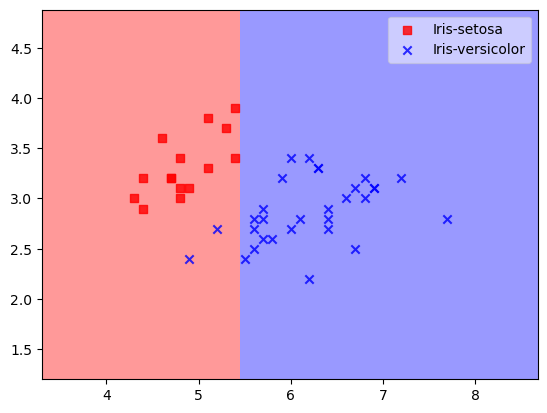

In [40]:
print (" Plotting the Decision Surface of Test Set... ")
t.plot_decision_regions(Xtest[:,feat],Ytest,clf=dt, res=0.02, cycle_marker=True, legend=1)

In [42]:
from nose.tools import assert_greater_equal
feat=[0,1]
dt=DecisionTree(0.95,5)
dt.train(Xtrain[:,feat],Ytrain)
pclasses=dt.predict(Xtest[:,feat])
acc = np.sum(pclasses==Ytest)/float(Ytest.shape[0])
assert_greater_equal(acc, 0.88)

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-

# Lets Train on all four features....

In [43]:
#Lets Train on all four features....

# Lets train a Decision Tree Classifier on Petal Length and Width
feat=[0, 1, 2, 3]
dt=DecisionTree(0.95,5)
dt.train(Xtrain[:,feat],Ytrain)
pclasses=dt.predict(Xtest[:,feat])
#Lets see how good we are doing, by finding the accuracy on the test set..
print (np.sum(pclasses==Ytest))
print ("Accuracy = ", np.sum(pclasses==Ytest)/float(Ytest.shape[0]))

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-

What can you conclude ?
====================
Please write your observation....



# Cross-Validation

Until now we have been splitting the dataset into a training and test set rather randomly and were reporting a rather artifical performance. Now we are going to test our system exhaustively by making use of k-fold [cross validation](http://en.wikipedia.org/wiki/Cross-validation_%28statistics%29). 

Now go and tune your hyper-parameters (purity, exthreshold) to opitmize the performance.

In [49]:
# Now lets cross validate for best paramters, and test the result...
# We will be training four different models on four different partitions of data set and 
# then will be reporting the mean accuracy of the four classifiers.

nfolds=4 # lets use four folds..
folds=t.generate_folds(X,Y,nfolds)
features=[0,1, 2, 3] # features to use for our system
#now lets train and test on these folds...

#Lets perform the grid search...
purity=np.linspace(0.85,0.97,13) # You can also search over depth as well....
nexamp=np.linspace(5,25,21)  

params=np.zeros((len(purity),len(nexamp)))
                   
for p in range(len(purity)):
    for n in range(len(nexamp)):
        totacc=[]
        for k in range(nfolds):
            dt=DecisionTree(purity[p],nexamp[n])
            dt.train(folds[k][0][:,features],folds[k][1])
            pclasses=dt.predict(folds[k][2][:,features])
            acc=np.sum(pclasses==folds[k][3])/float(folds[k][3].shape[0])
            print ("[Info] Fold {} Accuracy = {}".format(k+1, acc))
            totacc.append(acc)
        params[p,n]=np.mean(totacc)
        print (totacc, '\nPurity={}, Nexample-threshold={}, Mean Accuracy ={}'.format(purity[p],nexamp[n], np.mean(totacc)))

Generating CV data for 3 classes
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Ir

Prediction for single example:  [5.  3.  1.6 0.2]
Going to the left
Prediction for single example:  [5.  3.  1.6 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [6.4 2.9 4.3 1.3]
Going to the right
Prediction for single example:  [6.4 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.4 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the right
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the left
Prediction for single example:  [5.8 2.7 3.9 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the right
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the left
Prediction for single example:  [6.  3.4 4.5 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the left
Prediction for single example:  

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the right
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the left
Prediction for single example:  [6.9 3.1 4.9 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the right
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the left
Prediction for single example:  [6.1 2.8 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
i am leaf label class: Iris-virginica
Predict

Best feature: 0
76 76
76 76
Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicol

Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the right
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the left
Prediction for single example:  [6.9 3.1 4.9 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the right
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the left
Prediction for single example:  [6.1 2.8 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single examp

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.3 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the right
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single examp

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

[Info] Fold 2 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-vers

[Info] Fold 4 Accuracy = 0.9722222222222222
[0.9166666666666666, 0.9166666666666666, 0.9166666666666666, 0.9722222222222222] 
Purity=0.85, Nexample-threshold=10.0, Mean Accuracy =0.9305555555555556
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

[Info] Fold 1 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-vers

Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.1 5.5 1.8]
Going to the right
Prediction for single example:  [6.4 3.1 5.5 1.8]
Going to the right
Prediction for single example:  [6.4 3.1 5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 2.6 5.6 1.4]
Going to the right
Prediction for single examp

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-ve

Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the right
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the left
Prediction for single example:  [7.2 3.  5.8 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single examp

Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single examp

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' '

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor']
Rows: 36, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-versicolor
['Iris-versicolor' 'Iris-versicolor' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Prediction for single example:  [6.3 2.8 5.1 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
i am leaf label class: Iris-virginica
[Info] 

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the left
Prediction for single example:  [6.1 3.  4.6 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the right
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the left
Prediction for single example:  [5.9 3.  4.2 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the right
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the left
Prediction for single example:  [5.7 2.8 4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.2 4.5 1.5]
Going to the right
Prediction for single example:  [6.2 2.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.2 2.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single exampl

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

Prediction for single example:  [5.4 3.9 1.7 0.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8 3.4 1.6 0.2]
Going to the left
Prediction for single example:  [4.8 3.4 1.6 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  3.5 1.3 0.3]
Going to the left
Prediction for single example:  [5.  3.5 1.3 0.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.  1.4 0.2]
Going to the left
Prediction for single example:  [4.9 3.  1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the right
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
i am leaf label class: Iris-versicolor
Pred

Prediction for single example:  [6.4 2.8 5.6 2.1]
Going to the right
Prediction for single example:  [6.4 2.8 5.6 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 2.8 5.6 2.2]
Going to the right
Prediction for single example:  [6.4 2.8 5.6 2.2]
Going to the right
Prediction for single example:  [6.4 2.8 5.6 2.2]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.6 3.  6.6 2.1]
Going to the right
Prediction for single example:  [7.6 3.  6.6 2.1]
Going to the right
Prediction for single example:  [7.6 3.  6.6 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.7 4.9 1.8]
Going to the right
Prediction for single example:  [6.3 2.7 4.9 1.8]
Going to the right
Prediction for single example:  [6.3 2.7 4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single examp

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the right
Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the left
Prediction for single example:  [6.6 3.  4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the right
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the left
Prediction for single example:  [6.2 2.8 4.8 1.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single examp

The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the right
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the right
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the left
Prediction for single example:  [5.6 2.5 3.9 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single examp

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [5.8 2.7 3.9 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the right
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the left
Prediction for single example:  [6.  3.4 4.5 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the left
Prediction for single example:  [5.6 3.  4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the right
Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.2 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the right
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
i am leaf label class: Iris-versicolor
Predict

The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [6.3 2.5 4.9 1.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.  2.  3.5 1. ]
Going to the right
Prediction for single example:  [5.  2.  3.5 1. ]
Going to the left
Prediction for single example:  [5.  2.  3.5 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 3.  4.2 1.2]
Going to the right
Prediction for single example:  [5.7 3.  4.2 1.2]
Going to the left
Prediction for single example:  [5.7 3.  4.2 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 2.6 3.5 1. ]
Going to the right
Prediction for single example:  [5.7 2.6 3.5 1. ]
Going to the left
Prediction for single example:  [5.7 2.6 3.5 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.9 4.5 1.5]
Going to the right
Prediction for single example:  [6.  2.9 4.5 1.5]
Going to the left
Prediction for single example:  [6.  2.9 4.5 1.5]
i am leaf label class: Iris-versicolor
Predicti

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [6.8 3.  5.5 2.1]
Going to the right
Prediction for single example:  [6.8 3.  5.5 2.1]
i am leaf label class: Iris-virginica
[Info] Fold 2 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor'

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [5.  3.3 1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.1 3.3 1.7 0.5]
Going to the left
Prediction for single example:  [5.1 3.3 1.7 0.5]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.1 3.8 1.5 0.3]
Going to the left
Prediction for single example:  [5.1 3.8 1.5 0.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.1 1.5 0.1]
Going to the left
Prediction for single example:  [4.9 3.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.1 1.5 0.1]
Going to the left
Prediction for single example:  [4.9 3.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 4.1 1.5 0.1]
Going to the left
Prediction for single example:  [5.2 4.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.5 4.2 1.4 0.2]
Going to the left
Prediction for single example:  [5.5 4.2 1.4 0.2]
i am leaf label class: Iris-seto

76 76
Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 

Best feature: 0
76 76
76 76
Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolo

Prediction for single example:  [4.9 3.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.1 1.5 0.1]
Going to the left
Prediction for single example:  [4.9 3.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 4.1 1.5 0.1]
Going to the left
Prediction for single example:  [5.2 4.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.5 4.2 1.4 0.2]
Going to the left
Prediction for single example:  [5.5 4.2 1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.7 2.8 4.5 1.3]
Going to the right
Prediction for single example:  [5.7 2.8 4.5 1.3]
Going to the left
Prediction for single example:  [5.7 2.8 4.5 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.9 3.2 4.8 1.8]
Going to the right
Prediction for single example:  [5.9 3.2 4.8 1.8]
Going to the right
Prediction for single example:  [5.9 3.2 4.8 1.8]
i am leaf label class: Iris-virginica
Pred

The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-vers

Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.1 5.5 1.8]
Going to the right
Prediction for single examp

Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the left
Prediction for single example:  [5.8 2.7 3.9 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the right
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the left
Prediction for single example:  [6.  3.4 4.5 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the left
Prediction for single example:  [5.6 3.  4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the right
Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.2 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the right
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single exampl

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [6.  2.2 5.  1.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.4 5.6 2.4]
Going to the right
Prediction for single example:  [6.3 3.4 5.6 2.4]
Going to the right
Prediction for single example:  [6.3 3.4 5.6 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.3 2.9 6.3 1.8]
Going to the right
Prediction for single example:  [7.3 2.9 6.3 1.8]
Going to the right
Prediction for single example:  [7.3 2.9 6.3 1.8]
i am leaf label class: Iris-virginica
[Info] Fold 1 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iri

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor']
Rows: 36, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-versicolor
['Iris-versicolor' 'Iris-versicolor' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the left
Prediction for single example:  [6.3 2.8 5.1 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single examp

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [6.  3.  4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the right
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the left
Prediction for single example:  [6.3 2.8 5.1 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
i am leaf label class: Iris-virginica
Predicti

Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the right
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the left
Prediction for single exampl

Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single examp

Prediction for single example:  [6.  2.9 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the right
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the left
Prediction for single example:  [6.6 2.9 4.6 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the right
Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the left
Prediction for single example:  [6.6 3.  4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the right
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the left
Prediction for single example:  [6.2 2.8 4.8 1.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
i am leaf label class: Iris-virginica
Predict

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the right
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the right
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the left
Prediction for single example:  [5.2 2.7 3.9 1.4]
i am leaf label class: Iris-versicolor
Predict

Prediction for single example:  [5.5 2.4 3.7 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the right
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the right
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the right
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the right
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
i am leaf label class: Iris-versicolor
Predict

Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

[Info] Fold 1 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-vers

The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single exampl

Prediction for single example:  [5.7 2.6 3.5 1. ]
Going to the right
Prediction for single example:  [5.7 2.6 3.5 1. ]
Going to the left
Prediction for single example:  [5.7 2.6 3.5 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.9 4.5 1.5]
Going to the right
Prediction for single example:  [6.  2.9 4.5 1.5]
Going to the left
Prediction for single example:  [6.  2.9 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the right
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the left
Prediction for single example:  [6.6 2.9 4.6 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the right
Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the left
Prediction for single example:  [6.6 3.  4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the right
Prediction for single examp

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-v

Prediction for single example:  [7.6 3.  6.6 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.7 4.9 1.8]
Going to the right
Prediction for single example:  [6.3 2.7 4.9 1.8]
Going to the right
Prediction for single example:  [6.3 2.7 4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
i am leaf label class: Iris-virginica
[Info] Fold 4 Accuracy = 0.9722222222222222
[0.9166666666666666, 0.9166666666666666, 0.9166666666666666, 0.9722222222222222] 
Purity=0.88, Nexample-threshold=15.0, Mean Accuracy =0.9305555555555556
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the right
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the left
Prediction for single example:  [5.6 2.8 4.9 2. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.8 3.  5.5 2.1]
Going to the right
Prediction for single example:  [6.8 3.  5.5 2.1]
Going to the right
Prediction for single example:  [6.8 3.  5.5 2.1]
i am leaf label class: Iris-virginica
[Info] Fold 2 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
i am leaf label class: Iris-virginica
[Info] Fold 3 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-

Prediction for single example:  [6.7 2.5 5.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
i am leaf label class: Iris-virginica
Predicti

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the right
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the left
Prediction for single example:  [4.9 2.5 4.5 1.7]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single example:  [7.7 2.6 6.9 2.3]
i am leaf label class: Iris-virginica
Predicti

Prediction for single example:  [6.4 3.1 5.5 1.8]
Going to the right
Prediction for single example:  [6.4 3.1 5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 2.6 5.6 1.4]
Going to the right
Prediction for single example:  [6.1 2.6 5.6 1.4]
Going to the left
Prediction for single example:  [6.1 2.6 5.6 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 2.8 5.6 2.1]
Going to the right
Prediction for single example:  [6.4 2.8 5.6 2.1]
Going to the right
Prediction for single example:  [6.4 2.8 5.6 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 2.8 5.6 2.2]
Going to the right
Prediction for single example:  [6.4 2.8 5.6 2.2]
Going to the right
Prediction for single example:  [6.4 2.8 5.6 2.2]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.6 3.  6.6 2.1]
Going to the right
Prediction for single example:  [7.6 3.  6.6 2.1]
Going to the right
Prediction for single examp

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris

The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 

Rows: 113, nfeatures: 4
Number of classes:  3
Current purity: 0.336283185840708
leaf node is not decided yet
113 113
Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the right
Prediction for single examp

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single examp

Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single examp

Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the right
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the left
Prediction for single example:  [4.9 2.5 4.5 1.7]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single examp

Prediction for single example:  [5.  3.  1.6 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [6.4 2.9 4.3 1.3]
Going to the right
Prediction for single example:  [6.4 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.4 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the right
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the left
Prediction for single example:  [5.8 2.7 3.9 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the right
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the left
Prediction for single example:  [6.  3.4 4.5 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the left
Prediction for single example:  [5.6 3.  4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction 

Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the right
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the left
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the right
Prediction for single example:  [5.6 2.8 4.9 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.8 3.  5.5 2.1]
Going to the right
Prediction for single example:  [6.8 3.  5.5 2.1]
Going to the right
Prediction for single example:  [6.8 3.  5.5 2.1]
i am leaf label class: Iris-virginica
[Info] Fold 2 Accuracy = 0.9444444444444444
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Ir

The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-vers

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [6.5 3.  5.8 2.2]
Going to the right
Prediction for single example:  [6.5 3.  5.8 2.2]
Going to the right
Prediction for single example:  [6.5 3.  5.8 2.2]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single examp

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the left
Prediction for single example:  [5.9 3.  4.2 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the right
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the left
Prediction for single example:  [5.7 2.8 4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.2 4.5 1.5]
Going to the right
Prediction for single example:  [6.2 2.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.2 2.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the right
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single exampl

Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the left
Prediction for single example:  [4.9 2.4 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the right
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the left
Prediction for single example:  [7.  3.2 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the right
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the left
Prediction for single example:  [5.6 2.9 3.6 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.4 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.4 3.  4.5 1.5]
Going to the left
Prediction for single example:  [5.4 3.  4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.1 2.5 3.  1.1]
Going to the right
Prediction for single example:  [5.1 2.5 3.  1.1]
Going to the left
Prediction for single exampl

Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single example:  [7.2 3.6 6.1 2.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.7 3.8 6.7 2.2]
Going to the right
Prediction for single examp

Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single examp

The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 

Prediction for single example:  [6.3 2.7 4.9 1.8]
Going to the right
Prediction for single example:  [6.3 2.7 4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
i am leaf label class: Iris-virginica
[Info] Fold 4 Accuracy = 0.9722222222222222
[0.9166666666666666, 0.9444444444444444, 0.9166666666666666, 0.9722222222222222] 
Purity=0.9, Nexample-threshold=5.0, Mean Accuracy =0.9375
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [4.9 2.4 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the right
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the left
Prediction for single example:  [7.  3.2 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the right
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the left
Prediction for single example:  [5.6 2.9 3.6 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.4 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.4 3.  4.5 1.5]
Going to the left
Prediction for single example:  [5.4 3.  4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.1 2.5 3.  1.1]
Going to the right
Prediction for single example:  [5.1 2.5 3.  1.1]
Going to the left
Prediction for single example:  [5.1 2.5 3.  1.1]
i am leaf label class: Iris-versicolor
Predict

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the right
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]


Prediction for single example:  [6.  2.2 5.  1.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.4 5.6 2.4]
Going to the right
Prediction for single example:  [6.3 3.4 5.6 2.4]
Going to the right
Prediction for single example:  [6.3 3.4 5.6 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.3 2.9 6.3 1.8]
Going to the right
Prediction for single example:  [7.3 2.9 6.3 1.8]
Going to the right
Prediction for single example:  [7.3 2.9 6.3 1.8]
i am leaf label class: Iris-virginica
[Info] Fold 1 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iri

Rows: 113, nfeatures: 4
Number of classes:  3
Current purity: 0.336283185840708
leaf node is not decided yet
113 113
Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa

Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-ve

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Prediction for single example:  [6.9 3.1 4.9 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the right
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the left
Prediction for single example:  [6.1 2.8 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the right
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the left
Prediction for single example:  [7.2 3.  5.8 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
i am leaf label class: Iris-virginica
Predict

Best feature: 0
76 76
76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'

Prediction for single example:  [6.5 3.  5.8 2.2]
Going to the right
Prediction for single example:  [6.5 3.  5.8 2.2]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single examp

The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Prediction for single example:  [4.9 3.  1.4 0.2]
Going to the left
Prediction for single example:  [4.9 3.  1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the right
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
i am leaf label class: Iris-virginica
Prediction for single example:  [

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' '

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Rows: 33, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-virginica
Prediction for single example:  [5.  3.4 1.5 0.2]
Going to the left
Prediction for single example:  [5.  3.4 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.7 4.4 1.5 0.4]
Going to the left
Prediction for single example:  [5.7 4.4 1.5 0.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 3.4 1.4 0.2]
Going to the left
Prediction for single example:  [5.2 3.4 1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.4 3.9 1.3 0.4]
Going to the left
Prediction for single example:  [5.4 3.9 1.3 0.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.5 2.3 1.3 0.3]
Going to the left
Prediction for single example:  [4.5 2.3 1.3 0.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.4 3.2 1.3 0.2]
Going to the left
Prediction for single example:  [4.4 3.2 1.3 0.2]
i

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-vers

Prediction for single example:  [5.  3.  1.6 0.2]
Going to the left
Prediction for single example:  [5.  3.  1.6 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [6.4 2.9 4.3 1.3]
Going to the right
Prediction for single example:  [6.4 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.4 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the right
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the left
Prediction for single example:  [5.8 2.7 3.9 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the right
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the left
Prediction for single example:  [6.  3.4 4.5 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the left
Prediction for single example:  

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the right
Prediction for single examp

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:

Prediction for single example:  [6.4 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the right
Prediction for single example:  [5.8 2.7 3.9 1.2]
Going to the left
Prediction for single example:  [5.8 2.7 3.9 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the right
Prediction for single example:  [6.  3.4 4.5 1.6]
Going to the left
Prediction for single example:  [6.  3.4 4.5 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the right
Prediction for single example:  [5.6 3.  4.5 1.5]
Going to the left
Prediction for single example:  [5.6 3.  4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the right
Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.2 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Predict

Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]


Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [6.2 2.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the right
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single example:  [5.6 2.7 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the right
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
i am leaf label class: Iris-versicolor
Predict

The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-vers

Prediction for single example:  [5.4 3.7 1.5 0.2]
Going to the left
Prediction for single example:  [5.4 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 3.7 1.5 0.2]
Going to the left
Prediction for single example:  [5.3 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the right
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the left
Prediction for single example:  [4.9 2.4 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the right
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the left
Prediction for single example:  [7.  3.2 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the right
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the left
Prediction for single example:  [5.6 2.9 3.6 1.3]
i am leaf label class: Iris-versicolor
Prediction for s

Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single example:  [7.2 3.6 6.1 2.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.7 3.8 6.7 2.2]
Going to the right
Prediction for single example:  [7.7 3.8 6.7 2.2]
Going to the right
Prediction for single examp

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Ir

Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
i am leaf label class: Iris-virginica
[Info] Fold 4 Accuracy = 0.9722222222222222
[0.9166666666666666, 0.9444444444444444, 0.9166666666666666, 0.9722222222222222] 
Purity=0.9099999999999999, Nexample-threshold=15.0, Mean Accuracy =0.9375
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-v

Prediction for single example:  [6.8 3.  5.5 2.1]
i am leaf label class: Iris-virginica
[Info] Fold 2 Accuracy = 0.9444444444444444
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versico

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the right
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the left
Prediction for single example:  [6.3 2.8 5.1 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Predicti

Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the left
Prediction for single example:  [6.6 3.  4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the right
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the left
Prediction for single example:  [6.2 2.8 4.8 1.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single examp

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the right
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the left
Prediction for single example:  [6.3 2.8 5.1 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single examp

Prediction for single example:  [4.9 3.1 1.5 0.1]
Going to the left
Prediction for single example:  [4.9 3.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.2 4.1 1.5 0.1]
Going to the left
Prediction for single example:  [5.2 4.1 1.5 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.5 4.2 1.4 0.2]
Going to the left
Prediction for single example:  [5.5 4.2 1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.7 2.8 4.5 1.3]
Going to the right
Prediction for single example:  [5.7 2.8 4.5 1.3]
Going to the left
Prediction for single example:  [5.7 2.8 4.5 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.9 3.2 4.8 1.8]
Going to the right
Prediction for single example:  [5.9 3.2 4.8 1.8]
Going to the right
Prediction for single example:  [5.9 3.2 4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the right
Prediction for singl

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' '

[Info] Fold 3 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-vers

Prediction for single example:  [5.  3.5 1.3 0.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.  1.4 0.2]
Going to the left
Prediction for single example:  [4.9 3.  1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the right
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7

Prediction for single example:  [5.4 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 3.7 1.5 0.2]
Going to the left
Prediction for single example:  [5.3 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the right
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the left
Prediction for single example:  [4.9 2.4 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the right
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the left
Prediction for single example:  [7.  3.2 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the right
Prediction for single example:  [5.6 2.9 3.6 1.3]
Going to the left
Prediction for single example:  [5.6 2.9 3.6 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.4 3.  4.5 1.5]
Going to the right
Prediction for 

Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the right
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the left
Prediction for single example:  [5.6 2.5 3.9 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
i am leaf label class: Iris

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the right
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the right
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the left
Prediction for single example:  [6.9 3.1 4.9 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the right
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the left
Prediction for single example:  [6.1 2.8 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single examp

Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the right
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the left
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the left
Prediction for single example:  [5.2 2.7 3.9 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.3 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the right
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]


Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

76 76
Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single exampl

Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
i am leaf label class: Iris-virginica
[Info] Fold 3 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'I

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-v

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Prediction for single example:  [5.4 3.9 1.7 0.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8 3.4 1.6 0.2]
Going to the left
Prediction for single example:  [4.8 3.4 1.6 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  3.5 1.3 0.3]
Going to the left
Prediction for single example:  [5.  3.5 1.3 0.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.  1.4 0.2]
Going to the left
Prediction for single example:  [4.9 3.  1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the right
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single exa

The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [6.  2.2 4.  1. ]
Going to the right
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the right
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the right
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the right
Prediction for single example:  [5.6 2.5 3.9 1.1]

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]

Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single example:  [7.4 2.8 6.1 1.9]
Going to the right
Prediction for single examp

Prediction for single example:  [5.9 3.2 4.8 1.8]
Going to the right
Prediction for single example:  [5.9 3.2 4.8 1.8]
Going to the right
Prediction for single example:  [5.9 3.2 4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the right
Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the left
Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the left
Prediction for single example:  [6.1 3.  4.6 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the right
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the left
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the left
Prediction for single example:  [5.9 3.  4.2 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the right
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the left
Prediction for single example:  [5.7 2.8 4.1 1.3]

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the right
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the right
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the right
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]


Prediction for single example:  [6.  2.2 4.  1. ]
Going to the right
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the right
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the right
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the right
Prediction for single example:  [5.6 2.5 3.9 1.1]

Prediction for single example:  [5.5 2.3 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the right
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single exampl

Prediction for single example:  [5.5 2.3 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the right
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single exampl

Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction 

Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single example:  [7.2 3.6 6.1 2.5]
i am leaf label class: Iris-virginica
Predict

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the right
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single example:  [5.6 2.7 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the right
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]


The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [7.6 3.  6.6 2.1]
Going to the right
Prediction for single example:  [7.6 3.  6.6 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.7 4.9 1.8]
Going to the right
Prediction for single example:  [6.3 2.7 4.9 1.8]
Going to the right
Prediction for single example:  [6.3 2.7 4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
i am leaf label class: Iris-virginica
[Info] Fold 4 Accuracy = 1.0
[0.9166666666666666, 0.9444444444444444, 0.9166666666666666, 1.0] 
Purity=0.94, Nexample-threshold=6.0, Mean Accuracy =0.9444444444444444
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-seto

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
i am leaf label class: Iris-virginica
[Info] Fold 4 Accuracy = 1.0
[0.9166666666666666, 0.9444444444444444, 0.9166666666666666, 1.0] 
Purity=0.94, Nexample-threshold=12.0, Mean Accuracy =0.9444444444444444
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-v

Prediction for single example:  [5.6 2.5 3.9 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
i am leaf label class: Iris-virginica
Predict

Prediction for single example:  [7.3 2.9 6.3 1.8]
Going to the right
Prediction for single example:  [7.3 2.9 6.3 1.8]
i am leaf label class: Iris-virginica
[Info] Fold 1 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor'

Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the right
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the right
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the left
Prediction for single example:  [5.6 2.5 3.9 1.1]
Going to the left
Prediction for single example:  [5.6 2.5 3.9 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
Going to the right
Prediction for single example:  [6.7 3.  5.2 2.3]
i am leaf label class: Iris-virginica
Prediction for single example

Prediction for single example:  [5.5 2.3 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the right
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single exampl

Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
Going to the right
Prediction for single example:  [6.3 3.3 6.  2.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single example:  [7.2 3.6 6.1 2.5]
Going to the right
Prediction for single examp

Rows: 76, nfeatures: 4
Number of classes:  2
Current purity: 0.5
leaf node is not decided yet
76 76
Best feature: 0
76 76
76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-ve

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-vers

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [5.6 2.7 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the right
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the right
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the left
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the left
Prediction for single example:  [6.9 3.1 4.9 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the right
Prediction for single examp

Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the right
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the right
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the right
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]


The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [7.7 3.8 6.7 2.2]
Going to the right
Prediction for single example:  [7.7 3.8 6.7 2.2]
Going to the right
Prediction for single example:  [7.7 3.8 6.7 2.2]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.8 2.2]
Going to the right
Prediction for single example:  [6.5 3.  5.8 2.2]
Going to the right
Prediction for single example:  [6.5 3.  5.8 2.2]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
Going to the right
Prediction for single example:  [6.2 3.4 5.4 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single examp

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Rows: 76, nfeatures: 4
Number of classes:  2
Current purity: 0.5
leaf node is not decided yet
76 76
Best feature: 0
76 76
76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-ve

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Best feature: 2
41 41
Best feature: 3
The best root node is
 Best feature index: 3
 1.7999999999999998 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37] [38 39 40]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor']
Rows

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the right
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the right
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the left
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the left
Prediction for single example:  [5.2 2.7 3.9 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.3 4.  1.3]


Going to the right
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.3 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.3 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the right
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:

Best feature: 0
76 76
76 76
Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolo

[Info] Fold 3 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-vers

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [6.7 2.5 5.8 1.8]
Going to the right
Prediction for single example:  [6.7 2.5 5.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
Going to the right
Prediction for single example:  [7.9 3.8 6.4 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single examp

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris

Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]

Prediction for single example:  [5.1 3.5 1.4 0.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.1 3.7 1.5 0.4]
Going to the left
Prediction for single example:  [5.1 3.7 1.5 0.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8 3.  1.4 0.1]
Going to the left
Prediction for single example:  [4.8 3.  1.4 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.4 3.7 1.5 0.2]
Going to the left
Prediction for single example:  [5.4 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 3.7 1.5 0.2]
Going to the left
Prediction for single example:  [5.3 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the right
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the left
Prediction for single example:  [4.9 2.4 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the right
Predicti

Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the right
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the left
Prediction for single example:  [6.  2.2 4.  1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the right
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
Going to the left
Prediction for single example:  [6.1 2.8 4.7 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the right
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]
Going to the left
Prediction for single example:  [5.5 2.6 4.4 1.2]


The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iri

Prediction for single example:  [6.  2.2 5.  1.5]
Going to the right
Prediction for single example:  [6.  2.2 5.  1.5]
Going to the right
Prediction for single example:  [6.  2.2 5.  1.5]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 3.4 5.6 2.4]
Going to the right
Prediction for single example:  [6.3 3.4 5.6 2.4]
Going to the right
Prediction for single example:  [6.3 3.4 5.6 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.3 2.9 6.3 1.8]
Going to the right
Prediction for single example:  [7.3 2.9 6.3 1.8]
Going to the right
Prediction for single example:  [7.3 2.9 6.3 1.8]
i am leaf label class: Iris-virginica
[Info] Fold 1 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-se

Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the right
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the left
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the left
Prediction for single example:  [7.2 3.  5.8 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single exampl

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the right
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the left
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the left
Prediction for single example:  [6.1 2.8 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
Going to the right
Prediction for single example:  [6.9 3.1 5.4 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the right
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the left
Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the left
Prediction for single example:  [7.2 3.  5.8 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8

76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'I

Best feature: 0
76 76
76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'

Prediction for single example:  [5.1 3.7 1.5 0.4]
Going to the left
Prediction for single example:  [5.1 3.7 1.5 0.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8 3.  1.4 0.1]
Going to the left
Prediction for single example:  [4.8 3.  1.4 0.1]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.4 3.7 1.5 0.2]
Going to the left
Prediction for single example:  [5.4 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.3 3.7 1.5 0.2]
Going to the left
Prediction for single example:  [5.3 3.7 1.5 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the right
Prediction for single example:  [4.9 2.4 3.3 1. ]
Going to the left
Prediction for single example:  [4.9 2.4 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the right
Prediction for single example:  [7.  3.2 4.7 1.4]
Going to the left
Prediction for single exa

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the left
Prediction for single example:  [5.6 3.  4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
Going to the right
Prediction for single example:  [6.7 3.  5.  1.7]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the right
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
Going to the left
Prediction for single example:  [6.7 3.1 4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.2 2.7 3.9 1.4]
Going to the right
Prediction for single exampl

Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the right
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the right
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the right
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.2 4.  1. ]
Going to the right
Prediction for single example:  [6.  2.2 4.  1. ]

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the left
Prediction for single example:  [6.5 2.8 4.6 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the right
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the left
Prediction for single example:  [6.9 3.1 4.9 1.5]
Going to the left
Prediction for single example:  [6.9 3.1 4.9 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the right
Prediction for single example:  [6.1 2.8 4.  1.3]
Going to the left
Prediction for single example:  [6.1 2.8 4.  1.3]


113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
Going to the right
Prediction for single example:  [7.7 2.8 6.7 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
Going to the right
Prediction for single example:  [6.9 3.2 5.7 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
Going to the right
Prediction for single example:  [6.7 3.1 5.6 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the right
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the left
Prediction for single example:  [5.6 2.8 4.9 2. ]
Going to the right
Prediction for single example:  [5.6 2.8 4.9 2. ]
i am leaf label class: Iris-virginica
Prediction for single exampl

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa']
Rows: 37, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-setosa
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versico

Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the right
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the left
Prediction for single example:  [4.9 2.5 4.5 1.7]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single example:  [7.7 2.6 6.9 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.  2.2 5.  1.5]
Going to the right
Prediction for single examp

Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the right
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
Going to the left
Prediction for single example:  [6.3 3.3 4.7 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the right
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
Going to the left
Prediction for single example:  [6.7 3.1 4.7 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
Going to the right
Prediction for single example:  [6.  2.7 5.1 1.6]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the right
Prediction for single example:  [5.7 2.9 4.2 1.3]
Going to the left
Prediction for single example:  [5.7 2.9 4.2 1.3]

Prediction for single example:  [6.7 3.3 5.7 2.5]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.5]
i am leaf label class: Iris-virginica
[Info] Fold 4 Accuracy = 1.0
[0.9166666666666666, 0.9444444444444444, 0.9166666666666666, 1.0] 
Purity=0.96, Nexample-threshold=17.0, Mean Accuracy =0.9444444444444444
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Ir

76 76
Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' '

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
Going to the right
Prediction for single example:  [6.3 2.5 5.  1.9]
i am leaf label class: Iris-virginica
[Info] Fold 3 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'

The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

The best root node is
 Best feature index: 2
 4.95 0.29340129335811105 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42] [43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66
 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-vers

Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the right
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single example:  [5.6 2.7 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the right
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]

Best feature: 0
76 76
76 76
Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolo

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [6.  2.9 4.5 1.5]
Going to the left
Prediction for single example:  [6.  2.9 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the right
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the left
Prediction for single example:  [6.6 2.9 4.6 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the right
Prediction for single example:  [6.6 3.  4.4 1.4]
Going to the left
Prediction for single example:  [6.6 3.  4.4 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the right
Prediction for single example:  [6.2 2.8 4.8 1.8]
Going to the left
Prediction for single example:  [6.2 2.8 4.8 1.8]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single example:  [7.1 3.  5.9 2.1]
Going to the right
Prediction for single examp

Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.1 5.5 1.8]
Going to the right
Prediction for single example:  [6.4 3.1 5.5 1.8]
Going to the right
Prediction for single example:  [6.4 3.1 5.5 1.8]
i am leaf label class: Iris-virginica
Predicti

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' '

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
Going to the right
Prediction for single example:  [6.5 3.  5.2 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
Going to the right
Prediction for single example:  [6.5 3.2 5.1 2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
Going to the right
Prediction for single example:  [5.8 2.8 5.1 2.4]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.1 5.5 1.8]
Going to the right
Prediction for single examp

['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'


Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.20373025009903145 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-ve

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' '

Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
i am leaf label class: Iris-virginica
Prediction for single example

The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 

Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
Going to the right
Prediction for single example:  [6.4 2.7 5.3 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the right
Prediction for single example:  [4.9 2.5 4.5 1

Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.2 2.9 4.3 1.3]
Going to the left
Prediction for single example:  [6.2 2.9 4.3 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the right
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
Going to the left
Prediction for single example:  [5.5 2.4 3.7 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the right
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
Going to the left
Prediction for single example:  [6.4 3.2 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the right
Prediction for single example:  [5.5 2.4 3.8 1.1]
Going to the left
Prediction for single example:  [5.5 2.4 3.8 1.1]


113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
Going to the right
Prediction for single example:  [6.5 3.  5.5 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
Going to the right
Prediction for single example:  [5.7 2.5 5.  2. ]
i am leaf label class: Iris-virginica
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the right
Prediction for single example:  [4.9 2.5 4.5 1.7]
Going to the left
Prediction for single example:  [4.9 2.5 4.5 1.7]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single example:  [7.7 2.6 6.9 2.3]
Going to the right
Prediction for single example:  [7.7 2.6 6.9 2

Best feature: 0
113 113
113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' '

[Info] Fold 4 Accuracy = 1.0
[0.9166666666666666, 0.9444444444444444, 0.9166666666666666, 1.0] 
Purity=0.97, Nexample-threshold=12.0, Mean Accuracy =0.9444444444444444
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicol

Best feature: 3
The best root node is
 Best feature index: 3
 1.7999999999999998 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37] [38 39 40]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor']
Rows: 38, nfeatures: 4
Num

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.45 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versic

Prediction for single example:  [5.  2.  3.5 1. ]
Going to the left
Prediction for single example:  [5.  2.  3.5 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 3.  4.2 1.2]
Going to the right
Prediction for single example:  [5.7 3.  4.2 1.2]
Going to the left
Prediction for single example:  [5.7 3.  4.2 1.2]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 2.6 3.5 1. ]
Going to the right
Prediction for single example:  [5.7 2.6 3.5 1. ]
Going to the left
Prediction for single example:  [5.7 2.6 3.5 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.  2.9 4.5 1.5]
Going to the right
Prediction for single example:  [6.  2.9 4.5 1.5]
Going to the left
Prediction for single example:  [6.  2.9 4.5 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the right
Prediction for single example:  [6.6 2.9 4.6 1.3]
Going to the left
Prediction for single exampl

Prediction for single example:  [6.3 2.5 5.  1.9]
i am leaf label class: Iris-virginica
[Info] Fold 3 Accuracy = 0.9166666666666666
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versico

Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the right
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
Going to the left
Prediction for single example:  [5.8 2.7 4.1 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the right
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
Going to the left
Prediction for single example:  [6.3 2.3 4.4 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
Going to the right
Prediction for single example:  [7.7 3.  6.1 2.3]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3]
Going to the right
Prediction for single example:  [6.4 3.2 5.3 2.3

Best feature: 0
40 40
40 40
Best feature: 2
40 40
The best root node is
 Best feature index: 2
 4.55 -1.4426951595367387e-09 [0 1] [ 2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 36 37 38 39]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor']
Rows: 2, nfeatures: 4
Number of classes:  1
Current purity: 1.0
Pure label
purity: 1.0, klasslabel: Iris-versicolor
['Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'
 'Iris-virginica' 'Iris-virginica' 'Iris-virginica' 'Iris-virginica'


Prediction for single example:  [5.9 3.2 4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the right
Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the left
Prediction for single example:  [6.1 3.  4.6 1.4]
Going to the left
Prediction for single example:  [6.1 3.  4.6 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the right
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the left
Prediction for single example:  [5.9 3.  4.2 1.5]
Going to the left
Prediction for single example:  [5.9 3.  4.2 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the right
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the left
Prediction for single example:  [5.7 2.8 4.1 1.3]
Going to the left
Prediction for single example:  [5.7 2.8 4.1 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:

Prediction for single example:  [7.4 2.8 6.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the right
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the left
Prediction for single example:  [6.3 2.8 5.1 1.5]
Going to the left
Prediction for single example:  [6.3 2.8 5.1 1.5]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
Going to the right
Prediction for single example:  [6.7 3.3 5.7 2.1]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
Going to the right
Prediction for single example:  [5.8 2.7 5.1 1.9]
i am leaf label class: Iris-virginica
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single example:  [5.9 3.  5.1 1.8]
Going to the right
Prediction for single exampl

Prediction for single example:  [5.4 3.9 1.7 0.4]
Going to the left
Prediction for single example:  [5.4 3.9 1.7 0.4]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.8 3.4 1.6 0.2]
Going to the left
Prediction for single example:  [4.8 3.4 1.6 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  3.5 1.3 0.3]
Going to the left
Prediction for single example:  [5.  3.5 1.3 0.3]
i am leaf label class: Iris-setosa
Prediction for single example:  [4.9 3.  1.4 0.2]
Going to the left
Prediction for single example:  [4.9 3.  1.4 0.2]
i am leaf label class: Iris-setosa
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the right
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
Going to the left
Prediction for single example:  [5.  2.3 3.3 1. ]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 3.  4.1 1.3]
Going to the right
Prediction for single exa

The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 

Prediction for single example:  [7.2 3.  5.8 1.6]
Going to the left
Prediction for single example:  [7.2 3.  5.8 1.6]
i am leaf label class: Iris-versicolor
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
Going to the right
Prediction for single example:  [7.2 3.2 6.  1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
Going to the right
Prediction for single example:  [6.1 3.  4.9 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
Going to the right
Prediction for single example:  [6.  3.  4.8 1.8]
i am leaf label class: Iris-virginica
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single example:  [6.8 3.2 5.9 2.3]
Going to the right
Prediction for single examp

Best feature: 2
76 76
The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-v

113 113
Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.35 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setos

The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

The best root node is
 Best feature index: 2
 4.85 0.2890112632186797 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35] [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59
 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 2
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versi

Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the right
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
Going to the left
Prediction for single example:  [5.5 2.5 4.  1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the right
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single example:  [5.6 2.7 4.2 1.3]
Going to the left
Prediction for single example:  [5.6 2.7 4.2 1.3]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the right
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
Going to the left
Prediction for single example:  [6.1 2.9 4.7 1.4]
i am leaf label class: Iris-versicolor
Prediction for single example:  [6.5 2.8 4.6 1.5]
Going to the right
Prediction for single example:  [6.5 2.8 4.6 1.5]

Best feature: 2
113 113
The best root node is
 Best feature index: 2
 2.5999999999999996 -1.4426951595367387e-09 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [ 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
A node is being created with feature index: 2
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris

Best feature: 0
76 76
76 76
Best feature: 2
76 76
Best feature: 3
The best root node is
 Best feature index: 3
 1.75 0.33501350568872285 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40] [41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64
 65 66 67 68 69 70 71 72 73 74 75]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'

Best feature: 3
The best root node is
 Best feature index: 3
 1.65 0.09070080137669917 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36] [37 38 39 40 41 42]
A node is being created with feature index: 3
['Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor']
Rows: 37, nfeatures: 4
Number of classes:  1
Current pur

In [50]:
np.save('dt-cv',params)

In [51]:
print (params)

[[0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556]
 [0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556]
 [0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556]
 [0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556 0.93055556 0.93055556 0.93055556
  0.93055556 0.93055556 0.93055556]
 [0.9375     0.9375     0.9375     0.937

In [52]:
print (params.shape)

(13, 21)


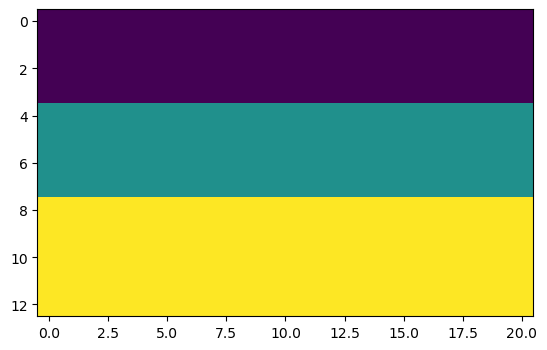

In [53]:
plt.imshow(params) # displayc the accuracy as 2D image...

In [54]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = Axes3D(fig)
tX, tY = np.meshgrid(purity, nexamp)
ax.plot_surface(tX,tY,params.T)
ax.set_xlabel('Purity')
ax.set_ylabel('Nexamples')
ax.set_zlabel('Mean Accuracy across {}-Folds'.format(nfolds))
# ax.scatter3D(data['SepalLength'],data['PetalLength'],data['PetalWidth'])
#(params,ax,'Purity','Example-Threshold','Mean-Accuracy')

Text(0.5, 0, 'Mean Accuracy across 4-Folds')

<Figure size 640x480 with 0 Axes>

In [55]:
print (params.shape, tX.shape, tY.shape)

(13, 21) (21, 13) (21, 13)


In [56]:
#print the row and column  index of m
#single line code
ridx,cidx= np.unravel_index(np.argmax(params), params.shape)

# simple step-wise code

cidx=np.argmax(params.max(axis=0))
ridx=np.argmax(params[:,cidx])
print (ridx, cidx)

8 0


In [57]:
print ('CV Best Parameters are, purity={}, nexamp={}, mean accuracy={}'.format(purity[ridx],nexamp[cidx],params[ridx,cidx]))

CV Best Parameters are, purity=0.9299999999999999, nexamp=5.0, mean accuracy=0.9444444444444444


In [59]:
print (purity[ridx],nexamp[cidx])
dt=DecisionTree(purity[ridx],nexamp[cidx])
dt.train(Xtrain[:,feat],Ytrain)
pclasses=dt.predict(Xtest[:,feat])
#Lets see how good we are doing, by finding the accuracy on the test set..
print (np.sum(pclasses==Ytest))
print ("Accuracy = ", np.sum(pclasses==Ytest)/float(Ytest.shape[0]))

0.9299999999999999 5.0
['Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa'
 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-setosa' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor' 'Iris-versicolor'
 'Iris-versicolor' 'Iris-versicolor' '

In [60]:
print (dt.find_depth())

3


In [61]:
print (dt)


        C(class=Iris-virginica,Purity=1.0)
    I(Fidx=3,Score=0.3069450880063971,Split=[1.75])
        C(class=Iris-versicolor,Purity=0.9459459459459459)
I(Fidx=2,Score=-1.4426951595367387e-09,Split=[2.5999999999999996])
    C(class=Iris-setosa,Purity=1.0)
